In [1]:
import numpy as np
import torch
import torchani
import os
import math
import pickle

import matplotlib
import matplotlib.pyplot as plt

In [2]:
def load_pickle():
    f = open('model_config', 'rb')     
    cfg = pickle.load(f)
    f.close()
    return cfg

In [3]:
cfg = load_pickle()

In [4]:
device = 'cpu'

## Importing Model Definition

In [5]:
from Model_Hyperparameters import get_aev_params, get_complete_network

In [6]:
energy_shifter, aev_computer = get_aev_params(device)
model, nn = get_complete_network(aev_computer, device)

In [7]:
latest_checkpoint = 'latest.pt'

In [8]:
if os.path.isfile(latest_checkpoint):
    checkpoint = torch.load(latest_checkpoint)
    nn.load_state_dict(checkpoint['nn'])

## Importing testing data

In [9]:
init, last = cfg['testing']
print(init, last)

105000 133770


In [10]:
from_path = "{}{}/{}".format(cfg['share_path'],cfg['name'], "testing.h5")
to_path = "{}/{}".format(cfg['scratch_path'], cfg['name'])
print(from_path)
print(to_path)
os.system('mkdir -p {}'.format(to_path))

/share1/shaunak/ML4NS/Uracil/testing.h5
/scratch/shaunak/ML4NS/Uracil


0

In [11]:

os.system('rsync -aPs ada:{} {}'.format(from_path, to_path))

0

In [12]:
print(os.system('ls {}'.format(to_path)))

0


In [13]:
data = torchani.data.load("{}/{}".format(to_path, "testing.h5"))

In [14]:
for i in data:
    print(i)

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70516931,  0.14508868,  0.10886172],
       [ 1.32879676, -1.10992064, -0.04836433],
       [-0.0200715 , -1.58345868, -0.24299506],
       [-1.07244286, -0.67178574,  0.07287929],
       [-0.66774882,  0.67258508, -0.18702402],
       [ 0.56552157,  1.14206426, -0.01000999],
       [-2.20002888, -0.99998131,  0.43350979],
       [ 0.7076291 ,  2.32258608, -0.13135545],
       [ 2.17348073, -1.71472085, -0.23319704],
       [-0.26938892, -2.51339278,  0.07878226],
       [-1.48828149,  1.30687158, -0.15396257],
       [ 2.72020295,  0.47827903,  0.01591869]]), 'energies': -414.50209055548004}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70534671,  0.14274068,  0.11044653],
       [ 1.32687515, -1.10838329, -0.05061421],
       [-0.01857512, -1.58250621, -0.2452662 ],
       [-1.06890189, -0.67734509,  0.07520961],
       [-0.66575958

       [ 2.69485408e+00,  4.96730500e-01, -2.90390680e-01]]), 'energies': -414.51068353901974}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65070866,  0.18161899, -0.20149349],
       [ 1.36488315, -1.12909465, -0.07131081],
       [ 0.00423521, -1.48611849,  0.08384236],
       [-1.11817733, -0.69522848,  0.10864285],
       [-0.7560752 ,  0.64561545,  0.05822121],
       [ 0.61740028,  1.17085636, -0.05912679],
       [-2.25820293, -1.13577404,  0.14156391],
       [ 0.83714076,  2.376568  , -0.10856503],
       [ 2.03908682, -1.96037913, -0.22830033],
       [-0.28153699, -2.46857825,  0.46357533],
       [-1.41059045,  1.53711954,  0.21027646],
       [ 2.69206076,  0.49903033, -0.28470506]]), 'energies': -414.5113555129858}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65081935,  0.18181588, -0.20327099],
       [ 1.36347014, -1.12999036, -0.07321915],
       [ 0.0084885 , 

       [ 2.59075315,  0.46292908, -0.67987674]]), 'energies': -414.4983640922561}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61414865,  0.10876928, -0.38459618],
       [ 1.28546025, -1.17504537, -0.03193007],
       [ 0.02192774, -1.58003046,  0.29265178],
       [-1.03892039, -0.6925756 ,  0.17601699],
       [-0.61165406,  0.61723554,  0.17847148],
       [ 0.58441832,  1.23782099, -0.04991611],
       [-2.19614386, -1.00976208, -0.03145615],
       [ 0.70156768,  2.43022486, -0.09791083],
       [ 1.82913707, -2.08546393, -0.30686257],
       [-0.12914381, -2.55464892, -0.23309204],
       [-1.51117533,  1.21558637,  0.18491459],
       [ 2.59497226,  0.46525016, -0.67954184]]), 'energies': -414.49515957150265}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61501223,  0.10805177, -0.38619452],
       [ 1.28470867, -1.17204005, -0.03069392],
       [ 0.01900738, -1.581104  ,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60772539,  0.19213876, -0.23000341],
       [ 1.33316517, -1.12933868, -0.08273428],
       [ 0.05795657, -1.56555386,  0.10864832],
       [-1.07812202, -0.6731916 ,  0.14659849],
       [-0.79033541,  0.66202082,  0.3123698 ],
       [ 0.59893235,  1.18538369, -0.03485736],
       [-2.22396095, -1.07456606,  0.02032591],
       [ 0.84256298,  2.34289823, -0.21069556],
       [ 2.05941896, -1.81519334, -0.42976414],
       [-0.30319993, -2.57738268,  0.3451026 ],
       [-1.60516578,  1.34929739,  0.03850073],
       [ 2.62083275,  0.53108581, -0.38946564]]), 'energies': -414.5053752294925}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60972091,  0.1948466 , -0.22832492],
       [ 1.33284106, -1.12900669, -0.08210736],
       [ 0.05922381, -1.57217342,  0.10628074],
       [-1.07669663, -0.66801138,  0.14736251],
       [-0.79120944,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63158871,  0.1734202 , -0.13096452],
       [ 1.33616211, -1.14325529, -0.11832028],
       [ 0.02962906, -1.60402207,  0.06379338],
       [-1.10810295, -0.67990787,  0.1422181 ],
       [-0.70190104,  0.70446466,  0.22497086],
       [ 0.55506672,  1.19475125,  0.02070756],
       [-2.22610244, -1.08445517,  0.08835473],
       [ 0.8120315 ,  2.37772651, -0.23856914],
       [ 2.04651739, -1.92792119, -0.11156158],
       [-0.09594618, -2.60000839, -0.10193435],
       [-1.53375903,  1.3972158 ,  0.09059041],
       [ 2.59832982,  0.52469605, -0.47830114]]), 'energies': -414.514471082768}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63082964,  0.17026793, -0.12488829],
       [ 1.33606925, -1.14517647, -0.12074839],
       [ 0.02657232, -1.60369689,  0.06211849],
       [-1.10890812, -0.68520964,  0.14102643],
       [-0.6978443 , 

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61303706,  0.16430718, -0.01996709],
       [ 1.34187545, -1.16532251,  0.02687855],
       [ 0.00451996, -1.54581844, -0.20453081],
       [-1.05470794, -0.68736366,  0.04318722],
       [-0.75010456,  0.65845214, -0.08975105],
       [ 0.55980807,  1.15444171, -0.02182057],
       [-2.20336179, -1.04897672,  0.38608762],
       [ 0.81571707,  2.40097695, -0.14089164],
       [ 2.11593281, -1.89908251, -0.08469446],
       [-0.07529058, -2.57657268, -0.01508475],
       [-1.59393893,  1.16131741, -0.04734854],
       [ 2.62796895,  0.54740536,  0.00562008]]), 'energies': -414.5116043184623}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61243986,  0.16127145, -0.02014906],
       [ 1.33930128, -1.16291569,  0.02801265],
       [ 0.0053998 , -1.54411334, -0.20297684],
       [-1.05395544, -0.69428707,  0.0430112 ],
       [-0.751036  ,

       [ 2.6554431 ,  0.62348698, -0.47758334]]), 'energies': -414.50413546132006}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65766361e+00,  2.16284620e-01, -2.45541730e-01],
       [ 1.30220631e+00, -1.11155195e+00, -1.49679370e-01],
       [-1.79660000e-03, -1.52129671e+00,  2.01069240e-01],
       [-1.07854486e+00, -6.74208790e-01,  1.32201580e-01],
       [-7.82997190e-01,  6.56707290e-01,  1.14451570e-01],
       [ 6.37826500e-01,  1.18438330e+00, -4.28848300e-02],
       [-2.25564682e+00, -1.19949754e+00,  7.84567400e-02],
       [ 8.83430360e-01,  2.39339137e+00, -1.00724960e-01],
       [ 1.84484375e+00, -2.02405039e+00, -4.43344280e-01],
       [-3.21217830e-01, -2.37851421e+00,  4.67179570e-01],
       [-1.50395677e+00,  1.42752588e+00,  5.13333100e-02],
       [ 2.65026526e+00,  6.27627610e-01, -4.63011310e-01]]), 'energies': -414.50222791959294}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'],

       [ 2.64921146,  0.51625581, -0.23216748]]), 'energies': -414.5106779972695}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61662784,  0.18895636, -0.02935326],
       [ 1.31877133, -1.12497018, -0.10761794],
       [ 0.02125814, -1.54584529, -0.06632408],
       [-1.1205131 , -0.62113522,  0.14141598],
       [-0.73137977,  0.63902356,  0.25196979],
       [ 0.59060129,  1.15148008,  0.01914972],
       [-2.18853466, -1.09196029,  0.15652024],
       [ 0.80632921,  2.34088524, -0.30640951],
       [ 2.18103281, -1.82225291, -0.14193105],
       [-0.18067671, -2.54943721, -0.23957401],
       [-1.48584575,  1.44924049,  0.13282529],
       [ 2.63074399,  0.53357179, -0.23493261]]), 'energies': -414.5077485648822}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61366128,  0.18861721, -0.02795389],
       [ 1.31664455, -1.12662773, -0.10947363],
       [ 0.02065377, -1.54687096, 

       [ 2.68526075,  0.57585055, -0.08153649]]), 'energies': -414.50756450748105}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64102622e+00,  2.10182780e-01,  2.12639700e-02],
       [ 1.33439730e+00, -1.11749502e+00, -1.18199630e-01],
       [-5.46128000e-03, -1.54527779e+00, -1.34225420e-01],
       [-1.13368335e+00, -7.39094810e-01,  1.01081910e-01],
       [-6.84286370e-01,  6.37667270e-01,  6.14229100e-02],
       [ 6.80525110e-01,  1.18814300e+00, -6.12675100e-02],
       [-2.25494264e+00, -1.09867318e+00,  2.92257920e-01],
       [ 7.83536080e-01,  2.39569624e+00, -2.01329660e-01],
       [ 2.02077086e+00, -1.94018662e+00,  6.37100000e-04],
       [-2.80825300e-01, -2.46388347e+00,  4.99795700e-02],
       [-1.53921938e+00,  1.31833517e+00,  2.83645480e-01],
       [ 2.68578990e+00,  5.71067500e-01, -8.71532100e-02]]), 'energies': -414.5076368479012}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 

       [ 2.72174407,  0.46517069, -0.45108084]]), 'energies': -414.51737592639466}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67079382,  0.18068148, -0.26429242],
       [ 1.34059493, -1.09411841, -0.10674022],
       [ 0.0073059 , -1.57343336,  0.1542601 ],
       [-1.07673255, -0.75244472,  0.13978486],
       [-0.66989323,  0.64365994,  0.09980534],
       [ 0.60697559,  1.20321078, -0.10655051],
       [-2.3099339 , -1.07545628,  0.11315956],
       [ 0.77874303,  2.40698272, -0.05520575],
       [ 2.01711143, -1.94805967, -0.12965986],
       [-0.03677161, -2.5260006 ,  0.32618956],
       [-1.47613518,  1.2861305 , -0.18937204],
       [ 2.72308712,  0.48607316, -0.43433695]]), 'energies': -414.51445548648945}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66822   ,  0.18183064, -0.26169647],
       [ 1.34238713, -1.09455958, -0.10797935],
       [ 0.00287529, -1.57197138

       [ 2.69044698,  0.59417937, -0.41947121]]), 'energies': -414.5041144886618}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68629014e+00,  1.92759210e-01, -2.27408180e-01],
       [ 1.32858860e+00, -1.13180690e+00, -3.75254400e-02],
       [ 9.94450000e-04, -1.52247460e+00,  7.75548600e-02],
       [-1.03633749e+00, -7.07607680e-01,  8.06109500e-02],
       [-7.66197120e-01,  6.08414960e-01,  1.62940500e-02],
       [ 5.99726400e-01,  1.20463548e+00, -2.26021300e-02],
       [-2.27398055e+00, -1.11165012e+00,  1.98672260e-01],
       [ 8.35014760e-01,  2.40993905e+00, -9.28733500e-02],
       [ 2.07430673e+00, -1.88925508e+00, -2.58914570e-01],
       [-4.24953670e-01, -2.43746920e+00,  1.05612540e-01],
       [-1.58762860e+00,  1.10078584e+00,  6.36319500e-02],
       [ 2.69106854e+00,  5.87229740e-01, -4.30044930e-01]]), 'energies': -414.5007678484738}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], '

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63377389,  0.14957924, -0.14574968],
       [ 1.32906099, -1.16189664,  0.02230422],
       [-0.00881814, -1.55466454, -0.02877404],
       [-1.06148376, -0.69415924,  0.03306098],
       [-0.65838251,  0.6749874 , -0.08971167],
       [ 0.59811147,  1.20174222, -0.07621822],
       [-2.24856794, -1.12799784,  0.29585607],
       [ 0.76397704,  2.44676016, -0.06421101],
       [ 1.99457515, -2.00094258, -0.13101958],
       [-0.26818693, -2.52422338,  0.1277134 ],
       [-1.3239278 ,  1.34384022,  0.1658662 ],
       [ 2.65173323,  0.48715544, -0.2096794 ]]), 'energies': -414.51552228443603}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63663728,  0.1472621 , -0.14521279],
       [ 1.3288595 , -1.16126838,  0.02339253],
       [-0.01140299, -1.55346562, -0.03247159],
       [-1.06050636, -0.69784225,  0.03653447],
       [-0.65732179

       [ 2.69325575,  0.43384202,  0.21104482]]), 'energies': -414.5045912482282}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67191122,  0.20947145, -0.03851421],
       [ 1.33095973, -1.09809402, -0.06691153],
       [-0.01985104, -1.51644231, -0.05914326],
       [-1.04556225, -0.68371167,  0.07560555],
       [-0.74069871,  0.65331904,  0.37327122],
       [ 0.59301025,  1.15831086, -0.11911216],
       [-2.2363226 , -1.11001822,  0.12661531],
       [ 0.80217027,  2.35538023, -0.294928  ],
       [ 1.95726436, -1.97327647, -0.20999398],
       [-0.20126439, -2.49833314, -0.04768812],
       [-1.50993417,  1.20166529,  0.13161066],
       [ 2.69870218,  0.42992462,  0.20530949]]), 'energies': -414.5040384549664}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67339123,  0.20805877, -0.03961562],
       [ 1.33144773, -1.09818435, -0.06661351],
       [-0.01884188, -1.51699572, 

       [ 2.80423558,  0.29344596, -0.445475  ]]), 'energies': -414.51454955292246}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.73720816,  0.19204265, -0.24613941],
       [ 1.3100154 , -1.10151003, -0.11316206],
       [ 0.0218978 , -1.57140915,  0.12022922],
       [-1.09742799, -0.70926435,  0.12786966],
       [-0.64654308,  0.58233111, -0.17403404],
       [ 0.59251131,  1.15943044, -0.07260266],
       [-2.24053677, -0.99543514,  0.25435571],
       [ 0.67344985,  2.39509192,  0.04631255],
       [ 2.00595374, -1.9588681 ,  0.02331763],
       [-0.12934536, -2.59655812,  0.15063591],
       [-1.41654619,  1.25901958, -0.1174231 ],
       [ 2.8017197 ,  0.29705839, -0.46046088]]), 'energies': -414.5144539650806}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.73296256,  0.19178805, -0.24144534],
       [ 1.31322153, -1.10172704, -0.11641032],
       [ 0.02457511, -1.57283647,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72027881,  0.18972217,  0.05857462],
       [ 1.33528556, -1.17542572, -0.12710445],
       [ 0.02618389, -1.62803125, -0.05851338],
       [-1.0461697 , -0.67956143,  0.13388957],
       [-0.723773  ,  0.64331102,  0.15687993],
       [ 0.60385253,  1.19248711,  0.01748465],
       [-2.21117057, -0.99468958,  0.18742039],
       [ 0.68280857,  2.38567009, -0.28465587],
       [ 1.98190299, -1.9793875 , -0.44035342],
       [-0.35460875, -2.55997578, -0.32031688],
       [-1.5290913 ,  1.19882521,  0.07738205],
       [ 2.71720727,  0.57894181, -0.12928081]]), 'energies': -414.51238086172754}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.71943536,  0.19127633,  0.05969471],
       [ 1.33936091, -1.17270879, -0.1312965 ],
       [ 0.02300826, -1.62714504, -0.054805  ],
       [-1.04310223, -0.68265807,  0.13451423],
       [-0.72792346

       [ 2.60560759,  0.68180532, -0.5990524 ]]), 'energies': -414.5041899233483}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68594923,  0.16631361, -0.25801226],
       [ 1.31953779, -1.13924813, -0.18617052],
       [ 0.04268833, -1.52668006,  0.27621492],
       [-1.15901379, -0.70898805,  0.15380729],
       [-0.64757916,  0.63262245, -0.01645993],
       [ 0.63585526,  1.16702203, -0.06954263],
       [-2.27830813, -1.1055689 ,  0.11261625],
       [ 0.75073875,  2.41624037, -0.01171295],
       [ 2.1631009 , -1.78731512, -0.4703    ],
       [-0.26467449, -2.47635477,  0.32727724],
       [-1.44017414,  1.34480551, -0.18900078],
       [ 2.61644596,  0.67409982, -0.59239091]]), 'energies': -414.50319428617865}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68220386,  0.16888837, -0.25891062],
       [ 1.32194493, -1.1378032 , -0.18544279],
       [ 0.03961106, -1.52778453,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63422036,  0.1289802 ,  0.05378323],
       [ 1.30951936, -1.18189142, -0.07716715],
       [-0.01860105, -1.59052517, -0.14841725],
       [-1.0991168 , -0.64099532,  0.0507137 ],
       [-0.66416791,  0.69102305, -0.10914651],
       [ 0.62738578,  1.19996418, -0.08353434],
       [-2.14402207, -1.07567136,  0.39305255],
       [ 0.68647809,  2.40616849, -0.10440768],
       [ 2.05187725, -1.98586668, -0.22725329],
       [-0.10287321, -2.55053551,  0.11091498],
       [-1.45232439,  1.35597916, -0.12958781],
       [ 2.67167404,  0.44687767, -0.08880695]]), 'energies': -414.51447124078874}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63228018,  0.13014706,  0.05522317],
       [ 1.31050952, -1.18400099, -0.07925152],
       [-0.01732151, -1.5913284 , -0.14723983],
       [-1.09666619, -0.63681445,  0.05246922],
       [-0.66560569

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68079507,  0.20829941, -0.21451133],
       [ 1.41046953, -1.13228916, -0.13989855],
       [ 0.01281188, -1.58413325,  0.20426726],
       [-1.12791959, -0.7508389 ,  0.09989049],
       [-0.70580639,  0.55769007,  0.29551848],
       [ 0.59014494,  1.22119091, -0.01397491],
       [-2.2877122 , -0.9994581 ,  0.02486463],
       [ 0.77731211,  2.40650927, -0.20700736],
       [ 2.14730777, -1.91017198, -0.34238527],
       [-0.12643287, -2.55947262,  0.01694809],
       [-1.4247955 ,  1.17118966,  0.14262408],
       [ 2.58243896,  0.63348517, -0.67367686]]), 'energies': -414.5019818629422}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68053298,  0.20710267, -0.21473715],
       [ 1.40847118, -1.12841603, -0.14429443],
       [ 0.01706418, -1.5841526 ,  0.20574022],
       [-1.12819651, -0.75178697,  0.10194673],
       [-0.70474894,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64391346,  0.21939184, -0.26720219],
       [ 1.32723319, -1.09360548, -0.11085593],
       [ 0.010008  , -1.58452142,  0.1098414 ],
       [-1.08396095, -0.7300605 ,  0.15548332],
       [-0.66031201,  0.54727722,  0.11036962],
       [ 0.56905482,  1.1988861 , -0.10207314],
       [-2.26945736, -1.0017112 ,  0.10720605],
       [ 0.78687818,  2.39005748, -0.07048691],
       [ 2.03833132, -1.93554705, -0.06044591],
       [ 0.07529554, -2.61788472,  0.27142087],
       [-1.4821752 ,  1.16723736,  0.24998989],
       [ 2.67104521,  0.59328148, -0.23732591]]), 'energies': -414.5131269363912}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6484967 ,  0.21894074, -0.26176889],
       [ 1.3252565 , -1.09150073, -0.11389311],
       [ 0.00666689, -1.58039726,  0.10702154],
       [-1.08263702, -0.72756312,  0.1573966 ],
       [-0.66115075,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.74716692e+00,  1.49363590e-01, -1.60261000e-02],
       [ 1.33613182e+00, -1.14869756e+00, -8.96414200e-02],
       [-6.55898000e-03, -1.56088844e+00, -1.95239710e-01],
       [-1.08995253e+00, -6.64709570e-01,  2.27340000e-04],
       [-7.33463240e-01,  5.96577680e-01, -1.65760860e-01],
       [ 5.89776760e-01,  1.20782451e+00,  2.03222100e-02],
       [-2.20937243e+00, -1.04604146e+00,  4.57951640e-01],
       [ 7.22152900e-01,  2.40158251e+00, -8.71506800e-02],
       [ 2.15490177e+00, -1.89637492e+00,  1.36522870e-01],
       [-3.43189870e-01, -2.51450668e+00,  5.31299500e-02],
       [-1.46876733e+00,  1.25127128e+00, -1.45558130e-01],
       [ 2.76802499e+00,  4.79623430e-01,  9.90088500e-02]]), 'energies': -414.5038215035292}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.74931042e+00,  1.46299110e-01, -1.59057200e-02],
       [

       [ 2.62267215,  0.2104611 , -0.37143809]]), 'energies': -414.5038818417237}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.55212753e+00,  1.46020540e-01, -2.44156430e-01],
       [ 1.32021484e+00, -1.16040201e+00, -1.78797190e-01],
       [ 3.62444600e-02, -1.57004612e+00,  2.61053410e-01],
       [-1.03524732e+00, -6.84609110e-01,  1.01369120e-01],
       [-6.71770860e-01,  6.71308080e-01,  1.46237080e-01],
       [ 5.82215460e-01,  1.19848115e+00, -1.03367730e-01],
       [-2.18929325e+00, -1.07435269e+00,  4.60059100e-02],
       [ 7.30832960e-01,  2.40852221e+00, -8.87847000e-02],
       [ 2.15308009e+00, -1.88039833e+00, -7.06410000e-04],
       [-2.61380220e-01, -2.51783528e+00, -4.58983700e-02],
       [-1.35267250e+00,  1.45047081e+00,  4.95992150e-01],
       [ 2.61532760e+00,  2.23560300e-01, -3.68338200e-01]]), 'energies': -414.50415764669543}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 

       [ 2.69199313,  0.37648074, -0.31046037]]), 'energies': -414.50216664062395}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64822216,  0.09200075, -0.23022738],
       [ 1.31185932, -1.15400634, -0.0470391 ],
       [ 0.04365177, -1.5178973 ,  0.06640777],
       [-1.07041997, -0.69034786,  0.15390408],
       [-0.74055135,  0.70374677,  0.18606457],
       [ 0.60501822,  1.21186628, -0.03063627],
       [-2.20017947, -1.12382075,  0.08651041],
       [ 0.75112461,  2.40735272, -0.18195965],
       [ 2.07612463, -1.83787124, -0.24813119],
       [-0.30703832, -2.39489318, -0.25690037],
       [-1.50237502,  1.2325989 ,  0.67654488],
       [ 2.69310584,  0.38067081, -0.331704  ]]), 'energies': -414.5043939354602}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64188183,  0.09247528, -0.22316967],
       [ 1.31107983, -1.15554986, -0.04643032],
       [ 0.04521233, -1.52099607,

       [ 2.63250453e+00,  5.34975370e-01, -4.10596950e-01]]), 'energies': -414.5033946674887}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62616305e+00,  2.03633510e-01, -5.64358900e-02],
       [ 1.32348265e+00, -1.10712407e+00, -1.55035100e-02],
       [-1.60039800e-02, -1.60651294e+00, -1.12973570e-01],
       [-1.11381079e+00, -7.14197010e-01,  7.27449100e-02],
       [-7.09025880e-01,  6.35316020e-01, -1.87922240e-01],
       [ 6.78250960e-01,  1.20705391e+00, -1.23950320e-01],
       [-2.21031404e+00, -1.07150644e+00,  3.83104260e-01],
       [ 7.51758580e-01,  2.38865768e+00,  1.98401000e-03],
       [ 2.16321429e+00, -1.74446477e+00, -3.54944530e-01],
       [-6.93255700e-02, -2.54237286e+00,  2.88184950e-01],
       [-1.45366094e+00,  1.23768732e+00,  1.57484800e-02],
       [ 2.63005929e+00,  5.31032540e-01, -4.14779480e-01]]), 'energies': -414.50113208625595}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H',

       [ 2.73769996,  0.45617975, -0.21808994]]), 'energies': -414.5073715384457}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70787146,  0.18592481, -0.14970615],
       [ 1.34658773, -1.13667487, -0.16980188],
       [ 0.01194688, -1.58946163,  0.08465414],
       [-1.06383041, -0.7722817 ,  0.22772063],
       [-0.65377977,  0.5838977 ,  0.1988734 ],
       [ 0.59871002,  1.21747749, -0.04811872],
       [-2.29779773, -1.02562602,  0.06844183],
       [ 0.72365573,  2.46721986, -0.18880694],
       [ 2.08191792, -1.95990669, -0.21829775],
       [-0.17785503, -2.58845451,  0.02341054],
       [-1.58590907,  1.18353523,  0.05291353],
       [ 2.73402485,  0.48004406, -0.22220044]]), 'energies': -414.5071209212432}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70636973,  0.18267133, -0.14374266],
       [ 1.34383331, -1.13750774, -0.16836108],
       [ 0.01425215, -1.58720204, 

       [ 2.63759014,  0.46910314,  0.06919829]]), 'energies': -414.50143031547185}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6115897 ,  0.18171164, -0.03688027],
       [ 1.35239067, -1.17961788, -0.05519163],
       [ 0.03276103, -1.51730678, -0.22367764],
       [-1.0725499 , -0.65849839,  0.17862725],
       [-0.79773027,  0.66404474,  0.11235912],
       [ 0.61948774,  1.18241121, -0.06278092],
       [-2.21767301, -1.15626928,  0.27219231],
       [ 0.80917386,  2.42904685, -0.19536462],
       [ 2.01550386, -2.03539444,  0.0677813 ],
       [-0.17812648, -2.47984489, -0.01264221],
       [-1.42078939,  1.35239184, -0.08056589],
       [ 2.65189498,  0.46522379,  0.06763186]]), 'energies': -414.50331345953316}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60954602,  0.18048021, -0.0307115 ],
       [ 1.35030142, -1.17582419, -0.05579292],
       [ 0.03449869, -1.52001375

       [ 2.69565823,  0.61230616,  0.13275517]]), 'energies': -414.50606675025534}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62955534e+00,  2.17006580e-01,  7.78446700e-02],
       [ 1.26246303e+00, -1.08517927e+00, -1.27261780e-01],
       [ 5.46380000e-04, -1.57728178e+00, -1.21923370e-01],
       [-1.11750390e+00, -7.19902370e-01, -1.01309800e-02],
       [-7.23365770e-01,  5.75199800e-01, -3.53650700e-02],
       [ 6.24179080e-01,  1.23300235e+00, -1.24050100e-02],
       [-2.17209517e+00, -1.10800212e+00,  3.76393340e-01],
       [ 8.21565840e-01,  2.41500012e+00, -1.83000920e-01],
       [ 1.97453740e+00, -1.89437604e+00, -2.41302180e-01],
       [-3.00716500e-01, -2.56170788e+00, -2.74549570e-01],
       [-1.46886191e+00,  1.26701234e+00,  3.52760230e-01],
       [ 2.69489710e+00,  5.99240730e-01,  1.34534290e-01]]), 'energies': -414.50611814006663}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'],

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62451917e+00,  1.08344280e-01, -3.17692990e-01],
       [ 1.36841871e+00, -1.17736364e+00, -1.42713350e-01],
       [ 1.12138420e-01, -1.50334305e+00,  2.54912080e-01],
       [-1.07330773e+00, -6.88178690e-01,  1.32019690e-01],
       [-7.14729760e-01,  6.62092770e-01,  2.80757800e-02],
       [ 5.96196400e-01,  1.18216384e+00,  1.67473000e-03],
       [-2.28701472e+00, -1.07734117e+00,  6.46227300e-02],
       [ 7.25809170e-01,  2.40998776e+00, -2.07253900e-02],
       [ 2.00541371e+00, -1.96371922e+00, -4.36168740e-01],
       [ 3.89172900e-02, -2.54247002e+00,  2.61231420e-01],
       [-1.53763497e+00,  1.44193518e+00,  5.45457700e-02],
       [ 2.67080108e+00,  4.53398350e-01, -6.17686900e-01]]), 'energies': -414.4993424463678}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62674615,  0.10591032, -0.3181383 ],
       [ 1.36991739,

       [ 2.59970487e+00,  5.05131740e-01,  1.96483000e-01]]), 'energies': -414.5097970647751}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61911533e+00,  2.10530990e-01, -2.02972000e-02],
       [ 1.32215187e+00, -1.07818886e+00,  1.16532000e-03],
       [-2.45135000e-03, -1.52427949e+00, -2.58093300e-01],
       [-1.06431139e+00, -6.84595820e-01,  9.65614300e-02],
       [-7.05732780e-01,  6.11220900e-01,  1.42442060e-01],
       [ 6.03307090e-01,  1.17698965e+00, -7.43448100e-02],
       [-2.20444189e+00, -1.11022251e+00,  2.92637920e-01],
       [ 7.81736920e-01,  2.35800284e+00, -2.09660890e-01],
       [ 2.08281186e+00, -1.90064286e+00,  5.29790600e-02],
       [-3.92630710e-01, -2.47189198e+00, -3.95410700e-02],
       [-1.42085596e+00,  1.23378732e+00,  2.74468900e-02],
       [ 2.60083692e+00,  4.92401040e-01,  2.10458540e-01]]), 'energies': -414.51101146143316}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H',

       [ 2.43569188,  0.65683066, -0.88237353]]), 'energies': -414.49515481985605}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66043417,  0.21107451, -0.25862448],
       [ 1.3584994 , -1.10961915, -0.04659437],
       [ 0.06159746, -1.57041608,  0.16746279],
       [-1.09595467, -0.71681622,  0.03359334],
       [-0.80853374,  0.65250426, -0.03648279],
       [ 0.61313001,  1.22780685, -0.09781583],
       [-2.29127611, -1.13836295,  0.18320773],
       [ 0.87597994,  2.38697431,  0.03740611],
       [ 2.05209645, -1.90431096, -0.28023906],
       [-0.13830534, -2.52465082,  0.32107362],
       [-1.72408472,  1.31182   , -0.07376037],
       [ 2.43590108,  0.67149439, -0.88871418]]), 'energies': -414.49530388852776}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65749239,  0.20812386, -0.2541073 ],
       [ 1.35904249, -1.10664486, -0.05064422],
       [ 0.06215173, -1.56994727

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64958424,  0.17657197, -0.00722468],
       [ 1.41705982, -1.12424444, -0.13045581],
       [ 0.03738494, -1.62700386, -0.0650499 ],
       [-1.0883565 , -0.69192746,  0.03315877],
       [-0.72061772,  0.61343903,  0.11627626],
       [ 0.63237902,  1.18579166, -0.11195222],
       [-2.29872492, -1.01097258,  0.2632366 ],
       [ 0.72364016,  2.40642178, -0.1226512 ],
       [ 2.19942116, -1.82785449, -0.3702168 ],
       [-0.10095871, -2.60703636,  0.28404848],
       [-1.44049847,  1.2238031 , -0.05714629],
       [ 2.73034357,  0.55334995, -0.22249197]]), 'energies': -414.49883725041985}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6501086 ,  0.17601627, -0.01438555],
       [ 1.41734805, -1.12566215, -0.12441371],
       [ 0.03643805, -1.62611174, -0.06621047],
       [-1.08562172, -0.68696998,  0.03262839],
       [-0.72264825

       [ 2.52241525,  0.56715314, -0.67042937]]), 'energies': -414.51237691488416}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63776763,  0.17983151, -0.31132423],
       [ 1.32655136, -1.09752344, -0.16151922],
       [ 0.06766693, -1.52122898,  0.20268312],
       [-1.06994811, -0.71476616,  0.09664458],
       [-0.72397777,  0.63936264, -0.17668082],
       [ 0.56568781,  1.15912621,  0.00355885],
       [-2.27323103, -1.08984517,  0.20438259],
       [ 0.81538643,  2.38008412,  0.08642563],
       [ 2.03232539, -1.91581559, -0.20330891],
       [-0.10168074, -2.46668192,  0.60031635],
       [-1.50341007,  1.22530106, -0.26480072],
       [ 2.52061671,  0.57201454, -0.6711441 ]]), 'energies': -414.51285342455736}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63484268,  0.1770169 , -0.3126421 ],
       [ 1.32561121, -1.09312125, -0.16369408],
       [ 0.06658576, -1.52257596

       [ 2.66814587e+00,  5.42354190e-01, -8.16606700e-02]]), 'energies': -414.5145204918078}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61004063,  0.22947115, -0.18925341],
       [ 1.2818555 , -1.0741063 , -0.06319086],
       [ 0.00358201, -1.55056791,  0.00400906],
       [-1.04521035, -0.70781199,  0.12313489],
       [-0.77834723,  0.64183214, -0.02888662],
       [ 0.57081672,  1.17180414, -0.05622449],
       [-2.21421222, -1.13632005,  0.22810671],
       [ 0.87450863,  2.36763744, -0.06561556],
       [ 2.07623803, -1.79543995, -0.1221949 ],
       [-0.09411819, -2.53496868,  0.0334408 ],
       [-1.41725176,  1.42163748,  0.14387646],
       [ 2.66087599,  0.52777145, -0.07976387]]), 'energies': -414.5148439712664}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61343295e+00,  2.25094200e-01, -1.80735940e-01],
       [ 1.28020688e+00, -1.06903653e+00, -6.79157400e-02]

       [ 2.6339903 ,  0.59527025,  0.17783048]]), 'energies': -414.50453214112537}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66165596,  0.17716532,  0.04513865],
       [ 1.30334325, -1.08670819, -0.08914938],
       [-0.02368755, -1.56729655, -0.17605585],
       [-1.04236226, -0.68856221,  0.15717771],
       [-0.6632918 ,  0.56965176,  0.13766647],
       [ 0.62840233,  1.18321709, -0.01740212],
       [-2.18535636, -1.00095347,  0.23847597],
       [ 0.68765506,  2.35390924, -0.25565691],
       [ 1.94537449, -1.93549209, -0.04720638],
       [-0.17576176, -2.48026968, -0.6798341 ],
       [-1.4649136 ,  1.12378911,  0.21815205],
       [ 2.61786022,  0.62374053,  0.17203271]]), 'energies': -414.502295673737}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65995017,  0.17680063,  0.047918  ],
       [ 1.30558704, -1.08326835, -0.09080789],
       [-0.0220596 , -1.56757476, 

       [ 2.68175742,  0.38838185, -0.29517816]]), 'energies': -414.5055213655934}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65509257,  0.16102501, -0.09308825],
       [ 1.33585175, -1.1111234 , -0.10586041],
       [-0.07966957, -1.5079082 , -0.07679033],
       [-1.08407087, -0.67557257,  0.11485019],
       [-0.65372942,  0.68889337,  0.31463967],
       [ 0.61939175,  1.2032766 ,  0.04874182],
       [-2.17330857, -1.16294928,  0.10584475],
       [ 0.73466518,  2.36467569, -0.27088101],
       [ 1.97302106, -1.97499333, -0.07551008],
       [-0.3196626 , -2.4642813 , -0.02179705],
       [-1.40877866,  1.40627705,  0.13453167],
       [ 2.6808061 ,  0.37242429, -0.30337691]]), 'energies': -414.50489066811184}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65116355,  0.15916225, -0.09390532],
       [ 1.33344116, -1.10712811, -0.10582623],
       [-0.07939757, -1.50588158,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61541756,  0.15068805, -0.27872579],
       [ 1.33106448, -1.13107436, -0.15066871],
       [ 0.11504158, -1.59965912,  0.19592119],
       [-1.10444258, -0.7460109 ,  0.05978077],
       [-0.69334994,  0.60888798,  0.13785321],
       [ 0.57530951,  1.23895748,  0.01211439],
       [-2.27724367, -1.0000643 ,  0.09117674],
       [ 0.76469114,  2.40040335, -0.09237641],
       [ 2.15025436, -1.88448974, -0.10595967],
       [-0.02972941, -2.59611489,  0.15143905],
       [-1.49552376,  1.31539207,  0.0932179 ],
       [ 2.61623097,  0.51386251, -0.49981693]]), 'energies': -414.50756011229987}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60910138,  0.15108498, -0.28022883],
       [ 1.32989499, -1.12885708, -0.14767828],
       [ 0.11548944, -1.59782446,  0.19436284],
       [-1.10328066, -0.74546619,  0.06153978],
       [-0.69276667

       [ 2.60375025e+00,  6.91302790e-01, -4.20758460e-01]]), 'energies': -414.51528957134974}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62996552e+00,  2.40572830e-01, -2.53114020e-01],
       [ 1.33693232e+00, -1.07139478e+00, -7.88249800e-02],
       [-3.07950000e-04, -1.52825030e+00,  1.22070920e-01],
       [-1.09628722e+00, -7.31158110e-01,  6.11605000e-02],
       [-7.68210160e-01,  6.27292010e-01, -1.98567820e-01],
       [ 5.54356220e-01,  1.19142555e+00, -4.91642100e-02],
       [-2.22025854e+00, -1.12289214e+00,  2.78576440e-01],
       [ 8.80549350e-01,  2.33980252e+00,  7.58341300e-02],
       [ 2.02150847e+00, -1.91346496e+00, -2.39041320e-01],
       [-1.64507250e-01, -2.54783172e+00,  1.13427540e-01],
       [-1.40357935e+00,  1.38864598e+00, -1.97703930e-01],
       [ 2.59665348e+00,  6.92044560e-01, -4.28782560e-01]]), 'energies': -414.5131310706545}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H',

       [ 2.67245897,  0.49002817, -0.20174923]]), 'energies': -414.5149947891907}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62506634e+00,  2.18321730e-01, -2.82095730e-01],
       [ 1.29210080e+00, -1.12729301e+00, -1.28577430e-01],
       [ 3.51521900e-02, -1.60518962e+00,  1.96246780e-01],
       [-1.08038232e+00, -6.83439960e-01,  9.44049900e-02],
       [-6.54616550e-01,  6.94714280e-01,  2.38542150e-01],
       [ 6.00490440e-01,  1.16449425e+00, -8.51690400e-02],
       [-2.23855441e+00, -1.13601086e+00,  2.89738500e-02],
       [ 7.59704140e-01,  2.42045679e+00, -1.02012850e-01],
       [ 2.10791039e+00, -1.87136840e+00, -1.63200750e-01],
       [-2.80979660e-01, -2.57646163e+00, -1.29148000e-03],
       [-1.45286520e+00,  1.33485448e+00,  2.63078740e-01],
       [ 2.66667363e+00,  4.76141800e-01, -1.99541530e-01]]), 'energies': -414.5148563740562}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], '

       [ 2.65707104,  0.55398672,  0.11190634]]), 'energies': -414.49968237100694}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67759582,  0.18061522, -0.04952864],
       [ 1.34878063, -1.17075745, -0.09276836],
       [-0.02609871, -1.61862522, -0.12174294],
       [-1.04242663, -0.75787375,  0.09899112],
       [-0.79785448,  0.67053687, -0.10939431],
       [ 0.55276637,  1.31004716, -0.02649573],
       [-2.21045133, -1.11824425,  0.35205132],
       [ 0.84964383,  2.45857817, -0.08704175],
       [ 2.03878033, -2.01719842,  0.03833951],
       [-0.22070987, -2.58580769, -0.41859302],
       [-1.64826984,  1.16199348,  0.10571099],
       [ 2.65390693,  0.55951088,  0.10977263]]), 'energies': -414.4998669465691}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68099778,  0.17942897, -0.04969798],
       [ 1.34619086, -1.16810639, -0.09287499],
       [-0.02507176, -1.61763969,

       [ 2.58410808,  0.38621763, -0.65757753]]), 'energies': -414.50748596015364}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61296483,  0.16347477, -0.30149845],
       [ 1.28119037, -1.08682114, -0.14886851],
       [ 0.08940829, -1.62363446,  0.19010872],
       [-1.02911473, -0.69232976,  0.13551812],
       [-0.67825229,  0.61254078,  0.14700523],
       [ 0.58235106,  1.20010316, -0.07717791],
       [-2.20017049, -1.00092094,  0.04332413],
       [ 0.67584444,  2.36734041, -0.03048878],
       [ 2.10390623, -1.80744766,  0.04080625],
       [-0.11840696, -2.63040001,  0.07786922],
       [-1.34566134,  1.35454701,  0.31507372],
       [ 2.57669705,  0.39640721, -0.65262788]]), 'energies': -414.50692327773413}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60841499,  0.16680895, -0.29987476],
       [ 1.28331139, -1.08376532, -0.15059248],
       [ 0.08802902, -1.6276661 

       [ 2.53413404,  0.68280082, -0.10346312]]), 'energies': -414.4903568878867}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63706257,  0.14351391, -0.01800786],
       [ 1.36740747, -1.20684708, -0.0997103 ],
       [ 0.03294332, -1.4885136 , -0.12269478],
       [-1.09755877, -0.69499208,  0.04056697],
       [-0.71301387,  0.79000393, -0.05915089],
       [ 0.57365041,  1.17166664, -0.08048631],
       [-2.19785858, -1.19136977,  0.35373753],
       [ 0.72321335,  2.37771413, -0.07547947],
       [ 2.14002155, -1.9907989 , -0.18690255],
       [-0.13803871, -2.46686955,  0.06904673],
       [-1.23463273,  1.63723409,  0.20431038],
       [ 2.53304163,  0.68682969, -0.09983626]]), 'energies': -414.4905188334105}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63302849,  0.14486304, -0.02327719],
       [ 1.36895137, -1.2050185 , -0.09731918],
       [ 0.03221782, -1.48586984, 

       [ 2.60947813e+00,  4.74683500e-01, -1.70700730e-01]]), 'energies': -414.5121472188913}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60619690e+00,  1.74050220e-01, -1.71214450e-01],
       [ 1.28737972e+00, -1.09725659e+00, -1.17496340e-01],
       [-2.10072000e-03, -1.60608734e+00, -3.41312500e-02],
       [-1.08662000e+00, -6.52978810e-01,  1.51969250e-01],
       [-7.05567660e-01,  6.88280310e-01,  2.01591820e-01],
       [ 5.98558920e-01,  1.24558978e+00, -1.40961200e-02],
       [-2.18695970e+00, -1.20359770e+00,  1.16492280e-01],
       [ 8.13492000e-01,  2.41618654e+00, -1.77247660e-01],
       [ 2.04169307e+00, -1.89100035e+00, -2.10144870e-01],
       [-2.54173960e-01, -2.54414268e+00,  3.60606970e-01],
       [-1.42773510e+00,  1.40607351e+00,  4.40005610e-01],
       [ 2.61234569e+00,  4.75040720e-01, -1.57678910e-01]]), 'energies': -414.51230449729115}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H',

       [ 2.68804376e+00,  4.18206040e-01, -1.37212340e-01]]), 'energies': -414.5199592015112}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66165923,  0.20612169, -0.26423631],
       [ 1.32911458, -1.130805  , -0.09432574],
       [ 0.0386971 , -1.61790688,  0.00337784],
       [-1.05551576, -0.71974206,  0.06807576],
       [-0.67746526,  0.6089832 , -0.03635356],
       [ 0.60478066,  1.21941672, -0.0607566 ],
       [-2.22892714, -1.03068892,  0.27908175],
       [ 0.68572264,  2.40343692,  0.01458679],
       [ 2.1496383 , -1.87249781, -0.10442471],
       [-0.24289304, -2.55300631,  0.38260769],
       [-1.47185503,  1.313541  , -0.16152416],
       [ 2.67108156,  0.40689622, -0.13638918]]), 'energies': -414.51797269351806}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65716275,  0.201521  , -0.26523419],
       [ 1.32896674, -1.13095783, -0.09622849],
       [ 0.03969814, 

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.73346605,  0.18012504, -0.02695718],
       [ 1.37430232, -1.14216355, -0.2185992 ],
       [ 0.03931517, -1.53158965, -0.01159883],
       [-1.08717575, -0.6674727 ,  0.15735044],
       [-0.71660696,  0.60456441,  0.06841025],
       [ 0.60723014,  1.1659212 ,  0.08892248],
       [-2.28901674, -1.07918314,  0.2180278 ],
       [ 0.71213077,  2.37945855, -0.19803929],
       [ 2.1611737 , -1.7105879 , -0.73028927],
       [-0.21400215, -2.49537813, -0.16036881],
       [-1.47411608,  1.33802402, -0.04520722],
       [ 2.65685075,  0.63490736, -0.18133553]]), 'energies': -414.5043575171943}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72926836,  0.18165374, -0.02202636],
       [ 1.37198414, -1.14364194, -0.22516865],
       [ 0.03949301, -1.52988791, -0.01543496],
       [-1.08610077, -0.66754444,  0.16189635],
       [-0.71770099,

       [ 2.75656142,  0.32236811, -0.38321456]]), 'energies': -414.5039744308466}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69136955,  0.16605208, -0.09843165],
       [ 1.28228282, -1.1476605 , -0.23483597],
       [ 0.02159272, -1.60749453,  0.0427517 ],
       [-1.06326046, -0.71688157,  0.1506129 ],
       [-0.78443132,  0.63718099, -0.11820057],
       [ 0.58321882,  1.2206913 ,  0.04500665],
       [-2.16712058, -1.07153857,  0.27699921],
       [ 0.77510783,  2.46248358, -0.04675311],
       [ 2.04336377, -1.87489928, -0.36691145],
       [-0.18932402, -2.61168385, -0.11681487],
       [-1.61472695,  1.23409871, -0.1081621 ],
       [ 2.74410495,  0.35107961, -0.37610597]]), 'energies': -414.50471595230823}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69074675,  0.16760508, -0.10377849],
       [ 1.27763552, -1.14535246, -0.2324814 ],
       [ 0.02065569, -1.60890884,

       [ 2.63850797,  0.52304482, -0.63810958]]), 'energies': -414.4850968224558}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66081241,  0.18110317, -0.46430359],
       [ 1.39250925, -1.13185992, -0.03908052],
       [-0.01507701, -1.51639668,  0.05044509],
       [-1.05809488, -0.65228053,  0.12907958],
       [-0.75098941,  0.61724858,  0.04822822],
       [ 0.67314422,  1.13889064, -0.01992074],
       [-2.24522353, -1.11703448,  0.15565249],
       [ 0.72788563,  2.41083509,  0.03452308],
       [ 2.04562908, -1.97475417,  0.04606987],
       [-0.23711704, -2.28284267,  0.70667138],
       [-1.51285686,  1.23440679,  0.19092772],
       [ 2.63949084,  0.51217405, -0.63787859]]), 'energies': -414.48574385119593}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65598893,  0.17615986, -0.46646177],
       [ 1.39056252, -1.12688206, -0.0367988 ],
       [-0.01506471, -1.51518742,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59237391,  0.17101821, -0.15972432],
       [ 1.30035944, -1.15420326, -0.22989378],
       [ 0.08421125, -1.60906817,  0.11288455],
       [-1.09585767, -0.68797813,  0.18088403],
       [-0.73694028,  0.68879863,  0.11647799],
       [ 0.62731601,  1.24580335,  0.05599724],
       [-2.20986521, -1.1240841 ,  0.11756487],
       [ 0.77657078,  2.4167304 , -0.14877442],
       [ 1.97264538, -1.98575689, -0.56587551],
       [-0.18155698, -2.58079664, -0.06653977],
       [-1.48236022,  1.35680256,  0.10999281],
       [ 2.62704944,  0.54838206, -0.35136218]]), 'energies': -414.51504513533024}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59261456,  0.17257778, -0.15657157],
       [ 1.29781599, -1.15248638, -0.2285436 ],
       [ 0.08247205, -1.60819582,  0.10883412],
       [-1.09687546, -0.68772974,  0.18120784],
       [-0.7365594 

       [ 2.6935065 ,  0.44762586,  0.06290505]]), 'energies': -414.49050215303623}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62612645,  0.21504042, -0.08361284],
       [ 1.39315648, -1.1483168 , -0.04130023],
       [ 0.03920793, -1.67329675, -0.21911731],
       [-1.09040222, -0.66728296,  0.17608292],
       [-0.65411319,  0.65560376,  0.18074459],
       [ 0.54936659,  1.18990765, -0.04701463],
       [-2.24486411, -1.0530325 ,  0.23959589],
       [ 0.71701021,  2.41073864, -0.2124618 ],
       [ 2.21067316, -1.83269746,  0.20004984],
       [-0.22992422, -2.47660857, -0.777307  ],
       [-1.39207272,  1.34598822,  0.57947806],
       [ 2.67833426,  0.44779856,  0.04889162]]), 'energies': -414.4889110717074}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62435434,  0.21945828, -0.07805185],
       [ 1.38954006, -1.1490195 , -0.04160208],
       [ 0.0391202 , -1.67691233,

       [ 2.65753785,  0.61105512, -0.31887476]]), 'energies': -414.48811766799776}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.73054977,  0.17924873, -0.03481115],
       [ 1.33483257, -1.09085998, -0.17613449],
       [-0.00813498, -1.50161816, -0.13451564],
       [-1.10757797, -0.65865805,  0.20168606],
       [-0.7464151 ,  0.70299903,  0.05689198],
       [ 0.60700398,  1.12388465,  0.03477628],
       [-2.25630216, -1.1967944 ,  0.22371617],
       [ 0.78416539,  2.38014902, -0.17276571],
       [ 2.0578664 , -1.85329001, -0.17471071],
       [ 0.08633878, -2.38665481,  0.36243857],
       [-1.50655093,  1.28325363,  0.11715734],
       [ 2.65402398,  0.59018429, -0.34091837]]), 'energies': -414.4868347087175}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.73302886,  0.1826831 , -0.04065112],
       [ 1.33526112, -1.09094772, -0.17164854],
       [-0.00856466, -1.4986231 ,

       [ 2.58493   ,  0.47632514, -0.48831804]]), 'energies': -414.5061292786906}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59382227,  0.15701294, -0.30630768],
       [ 1.3061773 , -1.18983982, -0.11519036],
       [ 0.03347243, -1.67945477,  0.12904042],
       [-0.99278153, -0.76147699,  0.14055455],
       [-0.68996309,  0.6108372 , -0.00629212],
       [ 0.60733642,  1.26047808, -0.10841158],
       [-2.18611426, -0.97270264,  0.17032059],
       [ 0.68684095,  2.47878467,  0.03651689],
       [ 2.15081415, -1.83864094, -0.0473342 ],
       [-0.2805246 , -2.65633282, -0.05026843],
       [-1.49574768,  1.30330761,  0.24362813],
       [ 2.584045  ,  0.49634163, -0.49730405]]), 'energies': -414.5068069928516}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59505928,  0.15463616, -0.30755812],
       [ 1.30490347, -1.19012036, -0.11221176],
       [ 0.03254409, -1.6726949 , 

       [ 2.58416399e+00,  4.29817830e-01, -3.57281450e-01]]), 'energies': -414.51346253199733}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.56234619e+00,  1.84906030e-01, -2.36738570e-01],
       [ 1.29219132e+00, -1.10685032e+00, -9.21272900e-02],
       [ 2.03563000e-03, -1.53553304e+00,  7.17597400e-02],
       [-1.07091523e+00, -6.71969460e-01,  1.73696090e-01],
       [-7.89839630e-01,  6.93904360e-01, -1.05319000e-03],
       [ 6.08743880e-01,  1.19646450e+00, -1.06925460e-01],
       [-2.18983726e+00, -1.22562726e+00,  1.82059290e-01],
       [ 8.96435230e-01,  2.41308846e+00, -1.00146900e-02],
       [ 2.11961972e+00, -1.73315777e+00, -3.68067760e-01],
       [-2.56310630e-01, -2.51327701e+00, -8.02156400e-02],
       [-1.46445996e+00,  1.39670461e+00,  2.19705480e-01],
       [ 2.57265197e+00,  4.32596040e-01, -3.63668480e-01]]), 'energies': -414.51086316081575}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H'

       [ 2.79428041,  0.59933756, -0.15784989]]), 'energies': -414.5092795211608}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.77160925,  0.181223  , -0.07117915],
       [ 1.37114742, -1.09816679, -0.13079332],
       [ 0.02434621, -1.52729536, -0.08436879],
       [-1.12213915, -0.68172565,  0.15339609],
       [-0.64375183,  0.61468196,  0.05024485],
       [ 0.63249543,  1.09399205, -0.07940986],
       [-2.27851612, -1.00171313,  0.25438859],
       [ 0.61437967,  2.33180308, -0.10357251],
       [ 1.98160942, -1.98625281, -0.19916374],
       [-0.14119288, -2.54947089, -0.19263736],
       [-1.23102216,  1.50767452,  0.16528549],
       [ 2.79970335,  0.611086  , -0.17005474]]), 'energies': -414.508626557456}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.7725706 ,  0.17786911, -0.06793459],
       [ 1.37114857, -1.09447847, -0.13338298],
       [ 0.01878044, -1.52281976, -

       [ 2.5887561 ,  0.45954383, -0.19107969]]), 'energies': -414.5034233023148}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58943977,  0.19642815, -0.12202397],
       [ 1.2672545 , -1.11147376, -0.07180443],
       [-0.00659473, -1.59215715, -0.18193499],
       [-1.06310218, -0.69320853,  0.09340891],
       [-0.76097085,  0.6396978 ,  0.2194624 ],
       [ 0.59595909,  1.2452102 , -0.09120781],
       [-2.2036654 , -1.17336204,  0.23565284],
       [ 0.8935198 ,  2.43809292, -0.16301356],
       [ 1.96209971, -1.93105096,  0.07823471],
       [-0.02402067, -2.34428931,  0.51103591],
       [-1.54680994,  1.29808793,  0.20842702],
       [ 2.59831177,  0.46375483, -0.19067973]]), 'energies': -414.504296432995}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5928234 ,  0.1963112 , -0.12795904],
       [ 1.26504901, -1.112816  , -0.06660116],
       [-0.00770725, -1.58967068, -

       [ 2.72328185e+00,  4.76103480e-01, -3.13540790e-01]]), 'energies': -414.51359142546414}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65580534,  0.18439796, -0.15952312],
       [ 1.32886676, -1.1597901 , -0.23154954],
       [ 0.02083627, -1.61831985,  0.08481457],
       [-1.04369706, -0.74391414,  0.16021292],
       [-0.67307738,  0.61661768, -0.00346994],
       [ 0.59176938,  1.1845464 ,  0.01507101],
       [-2.20697173, -0.95990541,  0.18805378],
       [ 0.67098764,  2.41314151, -0.06108313],
       [ 2.00077672, -1.968349  , -0.57680092],
       [-0.03124473, -2.56129783,  0.46842535],
       [-1.40988089,  1.27384992, -0.15415324],
       [ 2.70585295,  0.48056513, -0.31386538]]), 'energies': -414.5128596241148}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65216516,  0.18194139, -0.16248145],
       [ 1.32660929, -1.15770711, -0.23067407],
       [ 0.02060606, 

       [ 2.6185449 ,  0.56609092, -0.12853676]]), 'energies': -414.49544784908744}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6455076 ,  0.15644863, -0.30809117],
       [ 1.41881326, -1.11952807, -0.0853188 ],
       [ 0.00443805, -1.43520139,  0.07408834],
       [-1.12341501, -0.58429947,  0.12267773],
       [-0.77637454,  0.67721144, -0.01170803],
       [ 0.60651577,  1.11963952, -0.19382277],
       [-2.19259347, -1.16416025,  0.24565433],
       [ 0.76479315,  2.28685652,  0.06047771],
       [ 2.15354109, -1.88293515,  0.18286958],
       [-0.27549323, -2.32353075, -0.33546337],
       [-1.47135506,  1.43844259,  0.09953256],
       [ 2.63000648,  0.57759234, -0.1393718 ]]), 'energies': -414.4963639761057}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64473789,  0.1573918 , -0.30658006],
       [ 1.41930892, -1.11866776, -0.08698452],
       [ 0.00366918, -1.43635637,

       [ 2.68390934,  0.38067112, -0.12217378]]), 'energies': -414.4900545060331}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5869661 ,  0.19078964, -0.104408  ],
       [ 1.23945937, -1.12298188, -0.2285034 ],
       [-0.02165837, -1.70991023,  0.06039388],
       [-1.05749672, -0.78862227,  0.11174467],
       [-0.6304259 ,  0.68245431, -0.0426928 ],
       [ 0.62730541,  1.28232089, -0.07544954],
       [-2.19783619, -1.09974202,  0.28870576],
       [ 0.77766495,  2.51920706, -0.03343668],
       [ 1.9388085 , -1.9209648 , -0.1228638 ],
       [-0.03531795, -2.68882939, -0.23165827],
       [-1.52672188,  1.20278584, -0.29055365],
       [ 2.6748842 ,  0.37860343, -0.12028448]]), 'energies': -414.49319223546644}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59056177,  0.19070044, -0.10409957],
       [ 1.2361808 , -1.12261371, -0.22419316],
       [-0.02155512, -1.70631117,

       [ 2.65692292e+00,  5.75807430e-01, -2.30647840e-01]]), 'energies': -414.50025356449646}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68354161e+00,  1.63278560e-01, -6.96932700e-02],
       [ 1.30600391e+00, -1.11409457e+00, -1.63791270e-01],
       [ 1.31200000e-04, -1.67125904e+00,  8.01903400e-02],
       [-1.06705870e+00, -6.51911230e-01,  7.50038000e-02],
       [-7.03826290e-01,  6.73939800e-01,  1.73203650e-01],
       [ 6.35782490e-01,  1.19297119e+00, -5.56515500e-02],
       [-2.20192996e+00, -1.08306978e+00,  1.63878710e-01],
       [ 7.06129760e-01,  2.41051067e+00, -1.87319660e-01],
       [ 2.13839875e+00, -1.85581309e+00, -3.42178540e-01],
       [-2.67696190e-01, -2.27166519e+00, -6.86032970e-01],
       [-1.47959681e+00,  1.18637987e+00,  6.41147450e-01],
       [ 2.64741112e+00,  6.12196740e-01, -2.12390470e-01]]), 'energies': -414.49876879069484}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H'

       [ 2.66890572,  0.48010991, -0.18795514]]), 'energies': -414.51489512955885}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59835809,  0.19039578, -0.15324569],
       [ 1.28614659, -1.15091586, -0.09148643],
       [ 0.07313591, -1.60989748,  0.01607465],
       [-1.09968219, -0.67477166,  0.11629678],
       [-0.68907729,  0.65926887, -0.09254143],
       [ 0.63808545,  1.21383871, -0.10644151],
       [-2.22841871, -1.10086666,  0.27734232],
       [ 0.76098252,  2.41359619,  0.01034544],
       [ 2.10397431, -1.83380018, -0.36554042],
       [-0.31117987, -2.52981566, -0.2264419 ],
       [-1.476189  ,  1.26436517,  0.07464895],
       [ 2.66519956,  0.49442035, -0.18972177]]), 'energies': -414.5149033282623}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59506089,  0.18776908, -0.15594271],
       [ 1.29415127, -1.14985773, -0.0867877 ],
       [ 0.07043809, -1.60569635,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60515489,  0.17506161, -0.11797573],
       [ 1.29893298, -1.16665192, -0.13159608],
       [ 0.01843924, -1.62066898, -0.01397842],
       [-1.05931802, -0.66427459,  0.1259525 ],
       [-0.75415555,  0.64155009, -0.02301008],
       [ 0.68378317,  1.24793447, -0.00304276],
       [-2.21334542, -1.11450565,  0.26458379],
       [ 0.76305689,  2.44657851, -0.07361582],
       [ 2.21575354, -1.72955045, -0.27358161],
       [-0.17805687, -2.5387999 , -0.38245085],
       [-1.61145196,  1.28683344, -0.16548039],
       [ 2.68892927,  0.30441742, -0.18837512]]), 'energies': -414.5043586453889}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60109600e+00,  1.76478840e-01, -1.20020160e-01],
       [ 1.30416291e+00, -1.16433571e+00, -1.30151280e-01],
       [ 2.30626200e-02, -1.62033971e+00, -1.17524800e-02],
       [-1.05812371e+00, -6.6061

       [ 2.72761901,  0.43411416, -0.32776884]]), 'energies': -414.5074399981707}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67111452,  0.19348756, -0.10711119],
       [ 1.2991403 , -1.10886267, -0.16067867],
       [ 0.05785073, -1.53302507, -0.03218754],
       [-1.12227754, -0.68122915,  0.10934467],
       [-0.76123658,  0.60775516,  0.12656941],
       [ 0.63909643,  1.16488613, -0.0448665 ],
       [-2.21189983, -1.09314588,  0.16934979],
       [ 0.76384735,  2.38701801, -0.11666125],
       [ 2.09282747, -1.86503935, -0.21263801],
       [-0.28178902, -2.40111758,  0.40265875],
       [-1.41729295,  1.3000271 ,  0.40421167],
       [ 2.73092989,  0.43055596, -0.3213672 ]]), 'energies': -414.50937682518133}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6687704 ,  0.19474412, -0.11265918],
       [ 1.29496204, -1.11416459, -0.15361198],
       [ 0.05851743, -1.53684257,

       [ 2.61915264,  0.58539907, -0.55587599]]), 'energies': -414.5055198184602}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.71333756,  0.18746259, -0.12636535],
       [ 1.39203446, -1.12364281, -0.2309409 ],
       [ 0.01442326, -1.51807474,  0.0436515 ],
       [-1.12120395, -0.65270116,  0.11993195],
       [-0.70978505,  0.61640585,  0.18465397],
       [ 0.57252287,  1.15402753,  0.06816204],
       [-2.23003776, -1.07550562,  0.09755124],
       [ 0.7361518 ,  2.35907773, -0.16031137],
       [ 1.98710261, -2.0400012 , -0.26821476],
       [-0.22254688, -2.45841418,  0.37451922],
       [-1.468289  ,  1.2563582 ,  0.29071472],
       [ 2.61486996,  0.57937649, -0.55897781]]), 'energies': -414.506541132161}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.71445518,  0.18453303, -0.12569255],
       [ 1.38894471, -1.12445955, -0.23162578],
       [ 0.01409679, -1.51626629,  

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60814148,  0.22995402, -0.19152155],
       [ 1.35722153, -1.12418551, -0.04906561],
       [ 0.08118357, -1.62017815, -0.03909656],
       [-1.05754367, -0.70001042,  0.07853626],
       [-0.7823735 ,  0.66082505,  0.04531428],
       [ 0.54238988,  1.18433647, -0.04965102],
       [-2.24651772, -1.02922363,  0.19645063],
       [ 0.80061831,  2.35239343, -0.05613574],
       [ 2.25300102, -1.79248153, -0.27354064],
       [-0.05959243, -2.60604442,  0.08247139],
       [-1.37505485,  1.18452167,  0.70728742],
       [ 2.68091023,  0.4270881 , -0.30913826]]), 'energies': -414.50400437026246}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61446344,  0.22787376, -0.19230882],
       [ 1.35863887, -1.12485463, -0.04771807],
       [ 0.08168809, -1.6212469 , -0.04200955],
       [-1.06314894, -0.69990902,  0.0775134 ],
       [-0.7787494 

       [ 2.75235303,  0.38273448, -0.13083615]]), 'energies': -414.51440626486954}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70755437,  0.14980074, -0.16902558],
       [ 1.25110211, -1.10937454, -0.12773551],
       [-0.0254034 , -1.57620666,  0.01454554],
       [-1.05322256, -0.66817549,  0.09914655],
       [-0.67422438,  0.65476425, -0.1025289 ],
       [ 0.67690302,  1.21007084, -0.03620434],
       [-2.21802265, -1.15598191,  0.28390718],
       [ 0.69661364,  2.44770612,  0.018267  ],
       [ 1.99715372, -1.90888866, -0.25576301],
       [-0.23445217, -2.54556022, -0.22533594],
       [-1.41613217,  1.33418873, -0.17931639],
       [ 2.75513271,  0.3982946 , -0.12915646]]), 'energies': -414.5156100557642}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70661367,  0.15542192, -0.16778727],
       [ 1.25390239, -1.11333252, -0.12686531],
       [-0.02936049, -1.57953273,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58419745,  0.19986709, -0.08663882],
       [ 1.34609989, -1.11035207, -0.20191295],
       [ 0.07493817, -1.58365776,  0.03191461],
       [-1.08302988, -0.76230569,  0.06801882],
       [-0.80782545,  0.66275855, -0.10116988],
       [ 0.55211631,  1.20886888, -0.05324589],
       [-2.19743533, -1.04054634,  0.27903588],
       [ 0.83813068,  2.35907124,  0.01114889],
       [ 2.17616394, -1.85472556, -0.23825274],
       [-0.00543754, -2.61159654,  0.08367085],
       [-1.61408121,  1.32653466, -0.03362968],
       [ 2.61418716,  0.53589599, -0.195134  ]]), 'energies': -414.50978689999977}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58585334,  0.20427829, -0.09058796],
       [ 1.34478933, -1.11059018, -0.20045391],
       [ 0.07366027, -1.58431352,  0.02915747],
       [-1.08202535, -0.76205393,  0.06713961],
       [-0.80958604

       [ 2.76110329,  0.32669178, -0.38121868]]), 'energies': -414.50701387873585}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.73153744,  0.13793038, -0.17080731],
       [ 1.28265667, -1.1268379 , -0.05868225],
       [ 0.03881854, -1.56507927, -0.04678003],
       [-1.1164645 , -0.67734279,  0.0842577 ],
       [-0.68094683,  0.66624107,  0.03685065],
       [ 0.63597054,  1.24425985, -0.11015863],
       [-2.2308021 , -1.14610856,  0.22705928],
       [ 0.69369007,  2.43300865, -0.03593268],
       [ 1.94394053, -2.01670082,  0.08379655],
       [-0.26635679, -2.55260704, -0.16151097],
       [-1.31070733,  1.32668506,  0.59343707],
       [ 2.76461187,  0.33449811, -0.37021308]]), 'energies': -414.50570001721564}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.73214988,  0.13921919, -0.16886427],
       [ 1.2841129 , -1.12729201, -0.06154715],
       [ 0.03768055, -1.56769085

       [ 2.6052597 ,  0.56680265, -0.23812018]]), 'energies': -414.51302340341397}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5804049 ,  0.2140477 , -0.08638867],
       [ 1.32150462, -1.12178319, -0.18438518],
       [ 0.08276533, -1.59926107, -0.00890752],
       [-1.03843793, -0.72358372,  0.14166586],
       [-0.72589247,  0.64735795,  0.1978255 ],
       [ 0.51962115,  1.16867837,  0.01206235],
       [-2.24238788, -1.03639429,  0.14237687],
       [ 0.81668199,  2.38552869, -0.16333101],
       [ 2.19365376, -1.81238668, -0.34509253],
       [-0.02944991, -2.62937184, -0.18544332],
       [-1.59503598,  1.21156626, -0.10774555],
       [ 2.6024614 ,  0.55600252, -0.261558  ]]), 'energies': -414.5113188926004}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58471715,  0.21153006, -0.08439609],
       [ 1.32107229, -1.12243061, -0.18566933],
       [ 0.07804691, -1.59596925,

       [ 2.76340766e+00,  4.54425420e-01, -9.96991200e-02]]), 'energies': -414.5100137516195}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70584329e+00,  1.39551130e-01, -1.08726350e-01],
       [ 1.31434996e+00, -1.15453855e+00, -1.59990480e-01],
       [-2.47995000e-02, -1.47068459e+00,  1.29135100e-02],
       [-1.12936618e+00, -6.27450370e-01,  7.39615600e-02],
       [-6.41243500e-01,  6.87740930e-01,  2.82153700e-01],
       [ 6.60211400e-01,  1.18856785e+00, -1.69147000e-03],
       [-2.20237728e+00, -1.19453233e+00,  8.93813800e-02],
       [ 6.63942030e-01,  2.37874668e+00, -2.01286930e-01],
       [ 1.98483658e+00, -1.93153346e+00, -4.26521210e-01],
       [-1.77543480e-01, -2.49830814e+00,  3.20837100e-02],
       [-1.29396136e+00,  1.47340585e+00,  5.01557700e-01],
       [ 2.76488289e+00,  4.47645410e-01, -9.21924100e-02]]), 'energies': -414.50865330338326}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H',

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61929659e+00,  2.17090910e-01, -1.79549510e-01],
       [ 1.37958104e+00, -1.09536724e+00, -3.11030600e-02],
       [ 7.87970000e-04, -1.66028834e+00, -5.77360300e-02],
       [-1.07304236e+00, -7.60590600e-01,  1.59473770e-01],
       [-6.89776680e-01,  5.91405550e-01,  2.97506240e-01],
       [ 5.36891470e-01,  1.22025083e+00, -8.53708900e-02],
       [-2.23565438e+00, -1.00351942e+00,  9.41504700e-02],
       [ 7.88891840e-01,  2.41338331e+00, -1.74000020e-01],
       [ 2.19680187e+00, -1.83519909e+00, -1.06736200e-01],
       [-6.27378800e-02, -2.58095031e+00, -4.07763750e-01],
       [-1.51443523e+00,  1.14549805e+00,  3.43689810e-01],
       [ 2.57462350e+00,  7.33469560e-01, -2.68410100e-01]]), 'energies': -414.50668447901234}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61571025e+00,  2.16842650e-01, -1.82622610e-01],
       

       [ 2.60522635,  0.48898292, -0.39235814]]), 'energies': -414.51358898900503}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63004804,  0.15711234, -0.14807669],
       [ 1.34170602, -1.16194249, -0.16207205],
       [ 0.02562245, -1.61253624, -0.01186979],
       [-1.03607363, -0.63686695,  0.0695158 ],
       [-0.71693756,  0.64589761,  0.19557109],
       [ 0.59251537,  1.16840246,  0.01906729],
       [-2.19109546, -1.05011048,  0.13455175],
       [ 0.69716731,  2.41697616, -0.132084  ],
       [ 2.14888044, -1.9359562 , -0.12467313],
       [-0.04558942, -2.51598055,  0.50761492],
       [-1.51580876,  1.32902974,  0.05466137],
       [ 2.60764072,  0.49898384, -0.3912646 ]]), 'energies': -414.51330884030057}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63534793,  0.15837067, -0.14615457],
       [ 1.3406854 , -1.16307354, -0.16486231],
       [ 0.02123654, -1.61047006

       [ 2.54325038,  0.55752341, -0.25675441]]), 'energies': -414.5168302477407}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.54902975,  0.17446662, -0.18829261],
       [ 1.31902844, -1.13672197, -0.1108523 ],
       [ 0.05364732, -1.59945522, -0.01872415],
       [-1.03029033, -0.73276542,  0.05534106],
       [-0.74507826,  0.65043557, -0.03875158],
       [ 0.53296715,  1.24185389, -0.06978343],
       [-2.1958042 , -1.07720342,  0.25130008],
       [ 0.8314528 ,  2.40444144,  0.03010673],
       [ 2.14339375, -1.87876166, -0.16432337],
       [-0.1191329 , -2.36444667,  0.60995067],
       [-1.54894111,  1.21040489, -0.12518045],
       [ 2.54091026,  0.55322071, -0.25378855]]), 'energies': -414.5166847657721}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.54656139,  0.16952302, -0.18570745],
       [ 1.3169169 , -1.13446902, -0.11142479],
       [ 0.05724155, -1.59971075, 

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63833142,  0.24204896, -0.12230347],
       [ 1.2913249 , -1.04569533, -0.13057443],
       [ 0.05117698, -1.6422634 , -0.0418515 ],
       [-1.11390305, -0.75693228,  0.11732915],
       [-0.70591972,  0.6533231 , -0.14399589],
       [ 0.59485017,  1.18931568, -0.06534943],
       [-2.2535924 , -1.09259496,  0.33005533],
       [ 0.82067037,  2.39384387,  0.03639403],
       [ 2.09446378, -1.75455237, -0.2687678 ],
       [-0.18287525, -2.67621757, -0.01147208],
       [-1.41748014,  1.27824457, -0.48675235],
       [ 2.62565996,  0.66425508, -0.07517481]]), 'energies': -414.50724062378345}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64039138e+00,  2.40693330e-01, -1.19423460e-01],
       [ 1.28979042e+00, -1.04752668e+00, -1.32863770e-01],
       [ 5.02635500e-02, -1.64019604e+00, -4.15009700e-02],
       [-1.11427541e+00, -7.611

       [ 2.57694481,  0.82747329, -0.33188044]]), 'energies': -414.5015928085557}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72239304,  0.19781929, -0.18601085],
       [ 1.41816765, -1.12270042, -0.15837614],
       [-0.0123515 , -1.54627528,  0.07162729],
       [-1.1178916 , -0.69491945,  0.1495334 ],
       [-0.67717893,  0.65917476,  0.28650502],
       [ 0.57013118,  1.16099443, -0.0467369 ],
       [-2.27670358, -1.12736364,  0.05531878],
       [ 0.75067646,  2.38410019, -0.15243674],
       [ 2.11310235, -2.01462012, -0.00545346],
       [-0.29919301, -2.33843841, -0.42070548],
       [-1.47930602,  1.36361829,  0.21787081],
       [ 2.57540542,  0.83570039, -0.34995179]]), 'energies': -414.50044774624905}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72302176,  0.19808001, -0.18545362],
       [ 1.41689924, -1.1234079 , -0.15863356],
       [-0.00754379, -1.54575188,

       [ 2.70008070e+00,  4.71750210e-01, -1.42575690e-01]]), 'energies': -414.5202497428349}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65093058e+00,  1.50173280e-01, -5.56299200e-02],
       [ 1.28324942e+00, -1.15106491e+00, -1.73499120e-01],
       [-1.62923900e-02, -1.53074257e+00, -4.81226200e-02],
       [-1.08136559e+00, -6.72117070e-01,  8.60454900e-02],
       [-7.61128120e-01,  6.29238130e-01, -3.59608900e-02],
       [ 5.88059920e-01,  1.19735783e+00, -1.85361000e-03],
       [-2.16011570e+00, -1.12762087e+00,  2.80054920e-01],
       [ 8.21308000e-01,  2.44515510e+00, -5.78169700e-02],
       [ 1.97548242e+00, -1.95778753e+00, -4.49977940e-01],
       [-1.91171850e-01, -2.54534069e+00,  7.60768500e-02],
       [-1.51404179e+00,  1.29490260e+00, -1.20274920e-01],
       [ 2.69965271e+00,  4.90307180e-01, -1.39854900e-01]]), 'energies': -414.52001421109964}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H',

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66836742,  0.21402935, -0.26004108],
       [ 1.31136542, -1.10674336, -0.12569394],
       [-0.02011117, -1.63580714,  0.03518553],
       [-1.08480619, -0.76045943,  0.11864309],
       [-0.69417597,  0.6644611 ,  0.28717728],
       [ 0.58980817,  1.17998361, -0.03688802],
       [-2.23395827, -1.07405681,  0.09726093],
       [ 0.7959312 ,  2.43688697, -0.12247238],
       [ 2.20992817, -1.7332613 , -0.03127861],
       [-0.28190105, -2.63947684,  0.02192937],
       [-1.43471554,  1.33048709,  0.03106678],
       [ 2.65158571,  0.5465522 , -0.48085152]]), 'energies': -414.5082805765806}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6719979 ,  0.21202326, -0.26153718],
       [ 1.31671752, -1.10778009, -0.12628422],
       [-0.01689531, -1.63242601,  0.03152798],
       [-1.08432364, -0.76071145,  0.11946303],
       [-0.69454249,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58224686,  0.23780546, -0.0933677 ],
       [ 1.35526229, -1.14714418, -0.12953693],
       [ 0.01618586, -1.65456685, -0.08390439],
       [-1.11314958, -0.73848564,  0.11776221],
       [-0.72721646,  0.62299622, -0.05172014],
       [ 0.62434517,  1.23482561, -0.04550577],
       [-2.25429254, -1.1044014 ,  0.31965107],
       [ 0.84932661,  2.47762678, -0.03889878],
       [ 2.21984201, -1.64349137, -0.51641633],
       [-0.40673361, -2.57847212, -0.01384941],
       [-1.50554523,  1.3098288 , -0.22709918],
       [ 2.69662575,  0.3710892 , -0.02119973]]), 'energies': -414.4940044289434}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5829994 ,  0.24128113, -0.08942963],
       [ 1.35653715, -1.14482665, -0.12929782],
       [ 0.01383628, -1.658002  , -0.08632977],
       [-1.11403638, -0.7376997 ,  0.11570009],
       [-0.72555353,

       [ 2.66162155,  0.50342251,  0.08114382]]), 'energies': -414.515361463432}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67454633,  0.14453065, -0.1466442 ],
       [ 1.34562347, -1.17805814, -0.05232375],
       [ 0.01841435, -1.5326598 , -0.1198655 ],
       [-1.10541396, -0.63251707,  0.06306376],
       [-0.7119624 ,  0.72289675, -0.11984593],
       [ 0.57215063,  1.13512855, -0.08037316],
       [-2.15915917, -1.08996997,  0.37889896],
       [ 0.70885537,  2.35643717,  0.01683397],
       [ 2.09024123, -1.98371897, -0.2191739 ],
       [-0.21393797, -2.49182404, -0.21201899],
       [-1.49823381,  1.43349318, -0.02535062],
       [ 2.64762523,  0.51840963,  0.08132111]]), 'energies': -414.5131470932215}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67727112,  0.14327483, -0.1484636 ],
       [ 1.34397915, -1.18121327, -0.04844565],
       [ 0.02150209, -1.53392966, -

       [ 2.69167241e+00,  5.38492940e-01, -9.86543100e-02]]), 'energies': -414.50156146165284}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60182317e+00,  2.22680530e-01, -1.44918680e-01],
       [ 1.30695996e+00, -1.11839518e+00, -1.78001750e-01],
       [ 1.20676000e-03, -1.58015617e+00, -2.70468200e-02],
       [-1.09284630e+00, -7.16737620e-01,  5.24837400e-02],
       [-7.10847210e-01,  6.33683110e-01, -6.38702900e-02],
       [ 6.34328000e-01,  1.16340141e+00,  6.27126000e-03],
       [-2.16802945e+00, -1.06420470e+00,  2.85276030e-01],
       [ 7.62453480e-01,  2.38279911e+00, -7.75982000e-03],
       [ 1.89649681e+00, -1.96703626e+00, -3.99346250e-01],
       [-2.08871740e-01, -2.44462471e+00,  4.72926060e-01],
       [-1.39774222e+00,  1.45744025e+00,  5.35842600e-02],
       [ 2.68608136e+00,  5.27405950e-01, -1.22950570e-01]]), 'energies': -414.5023452113984}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H',

       [ 2.6148065 ,  0.5386234 , -0.21420183]]), 'energies': -414.5020406393039}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58342542,  0.20819692, -0.28484109],
       [ 1.29479163, -1.08736898, -0.08905222],
       [ 0.0084712 , -1.58609914,  0.10707776],
       [-1.12315888, -0.66626382,  0.09890139],
       [-0.66985702,  0.5725758 ,  0.12105798],
       [ 0.64570788,  1.21127878, -0.07879243],
       [-2.22378809, -1.10746375,  0.13362677],
       [ 0.81361649,  2.40287764, -0.04671183],
       [ 2.18225346, -1.74277872, -0.30695697],
       [-0.34855873, -2.49568315, -0.22191724],
       [-1.48619228,  1.1904856 ,  0.41174664],
       [ 2.62067774,  0.55178551, -0.21894251]]), 'energies': -414.5029740640797}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5832862 ,  0.20583237, -0.28528152],
       [ 1.28828952, -1.08609066, -0.08754743],
       [ 0.00837904, -1.58417077, 

       [ 2.60356984,  0.66450188, -0.34891925]]), 'energies': -414.49993820289353}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64860444,  0.07653045, -0.2679768 ],
       [ 1.36655684, -1.21544913, -0.12354205],
       [ 0.06062233, -1.54407851,  0.02221944],
       [-1.09088054, -0.67033422,  0.15459168],
       [-0.71658571,  0.69229458,  0.29593797],
       [ 0.59892354,  1.17648189, -0.02594083],
       [-2.2111138 , -1.02062938,  0.05480916],
       [ 0.68162386,  2.39557989, -0.11360215],
       [ 2.20170772, -1.91669673, -0.40693613],
       [-0.05093608, -2.53643872,  0.27125156],
       [-1.42988742,  1.3423959 ,  0.10871997],
       [ 2.60694303,  0.66275433, -0.33057136]]), 'energies': -414.4999383168155}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6458371 ,  0.0750854 , -0.26763239],
       [ 1.36564261, -1.21161261, -0.12295239],
       [ 0.06219312, -1.53945374,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63650685,  0.18216979, -0.12757583],
       [ 1.35388107, -1.14984057, -0.13511625],
       [-0.02917514, -1.59847123, -0.08574434],
       [-1.09112118, -0.71917163,  0.14677732],
       [-0.691232  ,  0.59738566,  0.29172987],
       [ 0.62803412,  1.27214945,  0.02711701],
       [-2.2755908 , -1.12218399,  0.12812185],
       [ 0.81924038,  2.47526444, -0.22982712],
       [ 2.20668316, -1.7095457 , -0.46734908],
       [-0.4270615 , -2.54079801,  0.19869603],
       [-1.46565291,  1.20575124,  0.15242756],
       [ 2.69960686,  0.41987161, -0.07560279]]), 'energies': -414.49767766858054}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63721218,  0.17882445, -0.12789092],
       [ 1.35552063, -1.14921579, -0.13470087],
       [-0.03418669, -1.59707655, -0.08936146],
       [-1.08291841, -0.71402227,  0.1461169 ],
       [-0.69564426

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72861182,  0.15994343, -0.11708963],
       [ 1.33308412, -1.16406613, -0.11095985],
       [ 0.04827022, -1.55448221, -0.11261603],
       [-1.0639488 , -0.67337611,  0.09545329],
       [-0.72826569,  0.63467563, -0.01874624],
       [ 0.622835  ,  1.17964335, -0.07095237],
       [-2.2843789 , -1.07432533,  0.33164267],
       [ 0.72642988,  2.4202357 , -0.05239266],
       [ 1.85409028, -2.11246011, -0.12260345],
       [-0.11373928, -2.49406474, -0.41002   ],
       [-1.46639757,  1.31068164,  0.26213277],
       [ 2.67921091,  0.6464251 ,  0.08690777]]), 'energies': -414.5049821474148}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.73100468,  0.15932961, -0.11651221],
       [ 1.33080375, -1.16096772, -0.11372266],
       [ 0.04965299, -1.5579087 , -0.11331548],
       [-1.06485833, -0.6773531 ,  0.09617941],
       [-0.72738084,

       [ 2.81057584,  0.46921074, -0.34594821]]), 'energies': -414.5003435517897}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72770882,  0.20504902, -0.27797502],
       [ 1.29953196, -1.06084313, -0.08023482],
       [-0.00889432, -1.54947105, -0.01457109],
       [-1.07349914, -0.69193676,  0.09722396],
       [-0.69057437,  0.63104546, -0.14654127],
       [ 0.66293782,  1.15415842, -0.14443507],
       [-2.26496303, -1.04977393,  0.32889716],
       [ 0.72199986,  2.33928573,  0.13627917],
       [ 2.03504701, -1.90861862, -0.03484147],
       [-0.1494169 , -2.60873879,  0.1214204 ],
       [-1.65575803,  1.01616209, -0.04827319],
       [ 2.80252776,  0.48517612, -0.35421823]]), 'energies': -414.4990389436694}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.7278563 ,  0.20750014, -0.27820487],
       [ 1.29214622, -1.06444839, -0.08204678],
       [-0.00624245, -1.55294551, 

       [ 2.71485548,  0.4995049 , -0.24421777]]), 'energies': -414.5021499271756}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68284317,  0.1160622 , -0.17734518],
       [ 1.38654631, -1.17552044, -0.19721033],
       [ 0.00346955, -1.639141  , -0.01837306],
       [-1.11044451, -0.64119479,  0.10928689],
       [-0.75464921,  0.66087777, -0.11271718],
       [ 0.56880715,  1.23715058, -0.09020629],
       [-2.22086449, -1.06346893,  0.30545004],
       [ 0.78144328,  2.42576074,  0.09807456],
       [ 2.23138013, -1.82754387, -0.47395873],
       [-0.18674795, -2.48627398,  0.57636009],
       [-1.59550872,  1.30632455, -0.20216668],
       [ 2.71797735,  0.50102802, -0.24988602]]), 'energies': -414.5013978734485}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68107562e+00,  1.16151890e-01, -1.80295430e-01],
       [ 1.38839938e+00, -1.17466652e+00, -1.92773700e-01],
       [ 1

       [ 2.58291769e+00,  5.18038050e-01, -4.86743390e-01]]), 'energies': -414.50960400386725}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57016854e+00,  1.51437200e-01, -2.31891500e-01],
       [ 1.27829920e+00, -1.14120058e+00, -1.35011180e-01],
       [-1.03367000e-03, -1.54898920e+00, -4.49854400e-02],
       [-1.05880053e+00, -7.26107450e-01,  1.01981570e-01],
       [-6.71199120e-01,  7.15832600e-01,  2.93194460e-01],
       [ 5.46252510e-01,  1.20672704e+00, -4.17863000e-03],
       [-2.20703583e+00, -1.15014691e+00,  1.50073080e-01],
       [ 8.63669600e-01,  2.41631823e+00, -1.33902150e-01],
       [ 2.06594703e+00, -1.83346825e+00, -4.02589800e-02],
       [-3.19156470e-01, -2.49480098e+00, -3.20849230e-01],
       [-1.49126260e+00,  1.34876831e+00,  3.44278390e-01],
       [ 2.57567401e+00,  5.26202880e-01, -4.84349540e-01]]), 'energies': -414.51177322424786}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H'

       [ 2.69792471,  0.42135257, -0.09473086]]), 'energies': -414.5200360547094}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63359695,  0.15077277, -0.16311779],
       [ 1.3118287 , -1.12685376, -0.16007963],
       [ 0.01645358, -1.55087559, -0.05273722],
       [-1.07427194, -0.71735492,  0.11371159],
       [-0.59503525,  0.57958227,  0.39297118],
       [ 0.62129959,  1.18193589, -0.05604078],
       [-2.2575447 , -1.01074875,  0.11572368],
       [ 0.68797359,  2.41679941, -0.19582012],
       [ 2.11252097, -1.87512089, -0.26902884],
       [-0.13739916, -2.48360394, -0.27356578],
       [-1.41903066,  1.22174449,  0.34138707],
       [ 2.69906613,  0.41100143, -0.0932742 ]]), 'energies': -414.51973968131836}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63355585,  0.15055254, -0.16232022],
       [ 1.31036247, -1.12720356, -0.16304633],
       [ 0.02213701, -1.55259351,

       [ 2.7215282 ,  0.46032627, -0.57932962]]), 'energies': -414.49791552652783}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.74696632e+00,  1.59049250e-01, -1.80005980e-01],
       [ 1.33341510e+00, -1.14994268e+00, -1.88736700e-01],
       [ 1.45618000e-03, -1.57243798e+00, -4.95714400e-02],
       [-1.02525806e+00, -6.84235410e-01,  2.31113790e-01],
       [-7.54713800e-01,  6.41332080e-01, -2.41650180e-01],
       [ 5.50404060e-01,  1.17421830e+00, -3.24588500e-02],
       [-2.20022688e+00, -1.02122722e+00,  3.55083080e-01],
       [ 7.06962770e-01,  2.38299243e+00,  1.06507500e-01],
       [ 2.03668138e+00, -1.95329591e+00, -4.13317260e-01],
       [-2.56888800e-01, -2.58754009e+00, -3.19442980e-01],
       [-1.37215222e+00,  1.34754851e+00,  5.25921500e-02],
       [ 2.71622736e+00,  4.85623540e-01, -5.75031730e-01]]), 'energies': -414.4959435013183}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 

       [ 2.75836699,  0.39836192, -0.09898909]]), 'energies': -414.50522829961295}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6833462 ,  0.11318688, -0.12332202],
       [ 1.33738515, -1.16945365, -0.14320044],
       [ 0.00757489, -1.59222519, -0.21106627],
       [-1.088293  , -0.70593045,  0.08962951],
       [-0.80045452,  0.69589641, -0.06746019],
       [ 0.55866935,  1.23978084, -0.14341606],
       [-2.17198065, -1.10069256,  0.40884501],
       [ 0.80330084,  2.44168885,  0.06472628],
       [ 2.09025361, -1.96897344, -0.10275321],
       [-0.10904831, -2.38238962,  0.39822916],
       [-1.66948279,  1.31727641, -0.02359151],
       [ 2.7486103 ,  0.42908522, -0.10362516]]), 'energies': -414.50570873040516}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.684749  ,  0.11474453, -0.12315365],
       [ 1.33911516, -1.17151359, -0.14163796],
       [ 0.00582455, -1.59526833

       [ 2.70392868e+00,  7.02122210e-01, -1.53313710e-01]]), 'energies': -414.51177718579083}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72141760e+00,  1.95483500e-01, -6.23771900e-02],
       [ 1.36949916e+00, -1.13981793e+00, -2.67897310e-01],
       [-2.63400000e-03, -1.61225064e+00, -6.55004300e-02],
       [-1.11979429e+00, -6.87508970e-01,  1.33931120e-01],
       [-7.02261120e-01,  6.04877100e-01,  1.53172940e-01],
       [ 6.46686920e-01,  1.20969181e+00, -6.12796300e-02],
       [-2.27204146e+00, -1.08005865e+00,  2.62965520e-01],
       [ 7.35378960e-01,  2.43251001e+00, -1.01228550e-01],
       [ 2.06624222e+00, -1.96508243e+00, -4.94143730e-01],
       [-4.02848900e-01, -2.55907933e+00, -1.74606640e-01],
       [-1.36020614e+00,  1.37023919e+00,  1.09820820e-01],
       [ 2.69114300e+00,  7.15445250e-01, -1.58756800e-01]]), 'energies': -414.511013725172}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 

       [ 2.56221103,  0.77387934, -0.53306471]]), 'energies': -414.49836222540654}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70266421,  0.16725948, -0.25671249],
       [ 1.29838576, -1.12691973, -0.19332167],
       [-0.03962055, -1.53744293,  0.05311571],
       [-1.04138066, -0.7355272 ,  0.17206412],
       [-0.69788669,  0.63469415,  0.09861859],
       [ 0.545655  ,  1.18818193, -0.04494063],
       [-2.21085159, -1.10332491,  0.1960708 ],
       [ 0.79601047,  2.42227043, -0.02592777],
       [ 1.99270611, -1.95351658, -0.34743755],
       [-0.32856589, -2.53296728, -0.30888451],
       [-1.35824327,  1.36331122,  0.23891398],
       [ 2.54828998,  0.77376882, -0.54596322]]), 'energies': -414.49899073999705}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69725141,  0.16730675, -0.25325999],
       [ 1.2983596 , -1.12367572, -0.18975583],
       [-0.03957919, -1.53617481

       [ 2.67000931e+00,  5.08267840e-01, -3.50950940e-01]]), 'energies': -414.50862274290904}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63641200e+00,  2.26299030e-01, -2.57140750e-01],
       [ 1.27693495e+00, -1.06951756e+00, -1.82154320e-01],
       [ 3.14007600e-02, -1.56334092e+00,  1.94308000e-03],
       [-1.04917037e+00, -6.87103700e-01,  1.57793970e-01],
       [-6.80044210e-01,  6.13425030e-01,  9.06562200e-02],
       [ 6.48114900e-01,  1.16818029e+00, -6.51988700e-02],
       [-2.26958687e+00, -1.09114451e+00,  2.28667560e-01],
       [ 7.66368230e-01,  2.35213734e+00, -1.96977600e-02],
       [ 2.13876053e+00, -1.76341182e+00, -3.08787280e-01],
       [-3.90650960e-01, -2.43793324e+00, -1.79139510e-01],
       [-1.48177889e+00,  1.19643011e+00,  3.75725060e-01],
       [ 2.67280005e+00,  5.04659840e-01, -3.62244140e-01]]), 'energies': -414.51039546355446}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H'

       [ 2.67942526,  0.53344061, -0.20201749]]), 'energies': -414.5104812100123}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65014808,  0.18431067, -0.15043761],
       [ 1.31652133, -1.14363938, -0.28477638],
       [ 0.02698576, -1.5952933 ,  0.02323366],
       [-1.0497199 , -0.64313419,  0.09426575],
       [-0.68542084,  0.68618445,  0.21813444],
       [ 0.60064771,  1.16391841, -0.02977707],
       [-2.18516759, -1.07909843,  0.20525817],
       [ 0.7029709 ,  2.37484501, -0.10538855],
       [ 2.04241762, -1.93840099, -0.46384218],
       [-0.5307803 , -2.53262425, -0.21085823],
       [-1.51552268,  1.22084235,  0.36239437],
       [ 2.68217142,  0.54161889, -0.21141001]]), 'energies': -414.51102786251494}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65583772,  0.18622019, -0.14717739],
       [ 1.32168666, -1.1454746 , -0.28640626],
       [ 0.02304056, -1.59947184,

       [ 2.64126938,  0.39827334, -0.39790133]]), 'energies': -414.49983215628424}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60146871,  0.14919655, -0.20362497],
       [ 1.37259896, -1.18105227, -0.31511749],
       [ 0.03961115, -1.59682661,  0.07945733],
       [-1.04933032, -0.70543419,  0.21780953],
       [-0.69841662,  0.69409283,  0.34536911],
       [ 0.49832789,  1.18977254, -0.0130768 ],
       [-2.18267529, -1.04237121,  0.08310698],
       [ 0.76538418,  2.40466874, -0.16432714],
       [ 1.98150223, -2.02827547, -0.59043648],
       [-0.38672231, -2.29255538, -0.53859301],
       [-1.4627303 ,  1.36044968,  0.63957178],
       [ 2.6475647 ,  0.40536923, -0.38498578]]), 'energies': -414.5020117509095}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60109821,  0.15138036, -0.2057244 ],
       [ 1.37420708, -1.17810895, -0.31115928],
       [ 0.04125171, -1.59561864,

       [ 2.49729752,  0.541736  , -0.70693712]]), 'energies': -414.5066039472385}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.56795853,  0.19324081, -0.28516757],
       [ 1.30520943, -1.09245383, -0.2375059 ],
       [ 0.03671909, -1.50356917,  0.06192454],
       [-1.08207536, -0.75376731,  0.15544905],
       [-0.66864524,  0.63081304,  0.1304751 ],
       [ 0.53128522,  1.17749943, -0.06304386],
       [-2.26100776, -1.09625861,  0.17711823],
       [ 0.88153907,  2.38829401,  0.0068536 ],
       [ 1.96112611, -1.94840821, -0.2382439 ],
       [-0.06167195, -2.61005046,  0.18705606],
       [-1.39742635,  1.30264144,  0.29305354],
       [ 2.50349272,  0.54112873, -0.71056441]]), 'energies': -414.50444096683924}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57080697,  0.19191043, -0.28772681],
       [ 1.30765386, -1.09440155, -0.23337007],
       [ 0.03803961, -1.50356424,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69198085,  0.15710783,  0.03547005],
       [ 1.28274295, -1.09360268, -0.26805222],
       [-0.03891874, -1.42464581, -0.202363  ],
       [-1.12208782, -0.65633766,  0.2197383 ],
       [-0.68236653,  0.69774514,  0.37049129],
       [ 0.59746422,  1.16157537, -0.02072611],
       [-2.20289917, -1.21313181,  0.22572917],
       [ 0.80876174,  2.32280855, -0.27640767],
       [ 1.92126396, -1.82509545, -0.73999534],
       [-0.26275607, -2.47568144, -0.52901989],
       [-1.40853989,  1.39109926,  0.36056598],
       [ 2.70821071,  0.53580014, -0.22536699]]), 'energies': -414.50462220926653}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69260995,  0.15724196,  0.03596941],
       [ 1.28434631, -1.09512603, -0.2665487 ],
       [-0.04265776, -1.42527094, -0.20370326],
       [-1.11801095, -0.65482212,  0.21759011],
       [-0.68259972

       [ 2.73387164,  0.50260594, -0.17617764]]), 'energies': -414.5007010902279}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66606417e+00,  2.27111090e-01, -1.47551930e-01],
       [ 1.27578249e+00, -1.13294221e+00, -1.54701760e-01],
       [ 1.57264600e-02, -1.65302880e+00, -2.72189240e-01],
       [-1.05986304e+00, -7.12409820e-01,  1.39277670e-01],
       [-7.17666230e-01,  5.56538470e-01,  8.37017700e-02],
       [ 6.54513780e-01,  1.19853821e+00, -1.22500570e-01],
       [-2.22974865e+00, -9.80095630e-01,  4.05441450e-01],
       [ 7.40730330e-01,  2.41693052e+00, -5.72070000e-04],
       [ 2.08264562e+00, -1.81985070e+00, -1.40230380e-01],
       [-1.91057090e-01, -2.55033219e+00, -2.49593550e-01],
       [-1.46369986e+00,  1.29049602e+00,  1.68678910e-01],
       [ 2.73802025e+00,  5.10977200e-01, -1.86346180e-01]]), 'energies': -414.4963103666544}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], '

       [ 2.55124961,  0.59829547, -0.78541252]]), 'energies': -414.5138781889899}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.56585475,  0.20732855, -0.46452654],
       [ 1.30939069, -1.09482288, -0.24803604],
       [ 0.05709803, -1.51753776,  0.24584205],
       [-1.10018956, -0.67711008,  0.14293258],
       [-0.71038763,  0.61109548, -0.16994138],
       [ 0.56271793,  1.21469059, -0.16385287],
       [-2.22261257, -1.09828072,  0.2683436 ],
       [ 0.85800804,  2.3163081 ,  0.27394224],
       [ 2.02360819, -1.89066262, -0.39827928],
       [-0.20802532, -2.54125142,  0.22017649],
       [-1.47436043,  1.25767627,  0.02911099],
       [ 2.54176816,  0.60615244, -0.77531295]]), 'energies': -414.5159837931647}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.56301716,  0.20778038, -0.47055703],
       [ 1.31183509, -1.09435537, -0.24604617],
       [ 0.05684156, -1.51885467, 

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5619537 ,  0.17409676, -0.49172592],
       [ 1.32596136, -1.15913355, -0.17790044],
       [ 0.05764508, -1.51094149,  0.1169866 ],
       [-1.05847747, -0.70355156,  0.17143613],
       [-0.69782285,  0.66141228,  0.14345403],
       [ 0.61734864,  1.17641973, -0.18104387],
       [-2.20817097, -1.053226  ,  0.1546126 ],
       [ 0.74824459,  2.3351305 ,  0.15529988],
       [ 2.08283075, -1.94540503, -0.29441275],
       [-0.22004058, -2.4510656 ,  0.57776478],
       [-1.42171111,  1.36468202,  0.18578247],
       [ 2.47378179,  0.59231609, -0.91575915]]), 'energies': -414.50477552612335}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.55866466,  0.17114112, -0.48519538],
       [ 1.32449469, -1.15684458, -0.18017888],
       [ 0.05744914, -1.51256162,  0.11632421],
       [-1.05380262, -0.70478985,  0.17211162],
       [-0.69987791

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62093402,  0.18750892, -0.17023783],
       [ 1.27920427, -1.08049171, -0.33085064],
       [-0.0029871 , -1.61622776,  0.05365582],
       [-1.08614478, -0.71591101,  0.142091  ],
       [-0.70615762,  0.65420062,  0.20670402],
       [ 0.65619624,  1.22987668,  0.0699222 ],
       [-2.23942364, -1.15752372,  0.2118766 ],
       [ 0.8340342 ,  2.43814706, -0.15559055],
       [ 1.99434659, -1.90709145, -0.48622481],
       [-0.34324026, -2.45584954, -0.44282995],
       [-1.46084073,  1.3333512 ,  0.36977334],
       [ 2.53842168,  0.58712092, -0.50948175]]), 'energies': -414.51217449032936}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62151568e+00,  1.85661770e-01, -1.61396630e-01],
       [ 1.27811839e+00, -1.07900291e+00, -3.28158830e-01],
       [-1.02398000e-03, -1.61577775e+00,  4.51002200e-02],
       [-1.09288966e+00, -7.172

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69013238,  0.17333412, -0.00492877],
       [ 1.34058105, -1.09763503, -0.25850787],
       [-0.04650659, -1.52668619, -0.22572493],
       [-1.05484944, -0.69534335,  0.17688739],
       [-0.67786742,  0.61848232,  0.3238816 ],
       [ 0.61805646,  1.15419515, -0.04522712],
       [-2.218586  , -1.07235411,  0.26684469],
       [ 0.72361141,  2.36393677, -0.22494811],
       [ 2.10418516, -1.81743165, -0.57781168],
       [-0.41812941, -2.40064697, -0.14479232],
       [-1.46558442,  1.30183126,  0.25604861],
       [ 2.66748   ,  0.58180038,  0.00584834]]), 'energies': -414.5112619610389}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6907869 ,  0.17329969, -0.00409648],
       [ 1.34358486, -1.09891575, -0.2583616 ],
       [-0.04714938, -1.52573892, -0.23168709],
       [-1.05970607, -0.69462577,  0.1757885 ],
       [-0.67683483,

       [ 2.72768938,  0.45067587,  0.06173   ]]), 'energies': -414.49639387142287}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66474035,  0.1406846 , -0.03209322],
       [ 1.33111726, -1.15617936, -0.18486413],
       [ 0.04710623, -1.48699251, -0.37859735],
       [-1.03910705, -0.6388615 ,  0.08959581],
       [-0.66023579,  0.65203949,  0.35338117],
       [ 0.57403678,  1.1287276 ,  0.04148875],
       [-2.22194559, -1.02808791,  0.3421552 ],
       [ 0.65045017,  2.33045482, -0.27364373],
       [ 1.94997376, -2.02594321,  0.02470167],
       [-0.02243293, -2.59068448, -0.28793758],
       [-1.3494193 ,  1.36282349,  0.48659148],
       [ 2.7308794 ,  0.4473592 ,  0.06091232]]), 'energies': -414.4964956477976}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66263473,  0.1362777 , -0.03410904],
       [ 1.33041216, -1.15518749, -0.17827433],
       [ 0.05101336, -1.48654514,

       [ 2.70492384,  0.56621592,  0.17353514]]), 'energies': -414.49698254641504}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67401843,  0.14703783,  0.06397539],
       [ 1.26453423, -1.13146275, -0.08857854],
       [-0.06547627, -1.48359233, -0.43287611],
       [-1.06951261, -0.7247497 ,  0.13202395],
       [-0.57092274,  0.60025148,  0.35502282],
       [ 0.56784789,  1.20678365, -0.10446615],
       [-2.16080415, -1.09094239,  0.34238757],
       [ 0.70537695,  2.41125938, -0.28320708],
       [ 1.83805285, -2.05077436, -0.17617551],
       [-0.25502459, -2.42074769, -0.55310057],
       [-1.3678499 ,  1.21320463,  0.65792375],
       [ 2.69370335,  0.56245677,  0.17672326]]), 'energies': -414.4978195785456}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67284899,  0.14411971,  0.067095  ],
       [ 1.26109588, -1.12601331, -0.09584555],
       [-0.06175759, -1.4813113 ,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63476908,  0.1795249 , -0.06150333],
       [ 1.34914356, -1.10654258, -0.29157394],
       [ 0.0122792 , -1.46426775, -0.0922865 ],
       [-1.08938154, -0.7159795 ,  0.14679198],
       [-0.7449644 ,  0.68260425,  0.17056152],
       [ 0.56120322,  1.15556833,  0.01930396],
       [-2.18462518, -1.11283206,  0.30076429],
       [ 0.81011856,  2.3137843 , -0.14083129],
       [ 1.97313878, -1.8426036 , -0.80229112],
       [-0.2467099 , -2.41496423, -0.25023238],
       [-1.54323304,  1.35269333,  0.22134348],
       [ 2.55465658,  0.51249913, -0.56905263]]), 'energies': -414.50864859951037}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62953624,  0.17807152, -0.06432414],
       [ 1.34916114, -1.1023929 , -0.29321455],
       [ 0.01403014, -1.46382567, -0.08636168],
       [-1.09245037, -0.71307852,  0.14872259],
       [-0.74281299

       [ 2.38883327,  0.59323234, -1.15468355]]), 'energies': -414.5007611491299}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58284904,  0.18161433, -0.49403315],
       [ 1.30068083, -1.12853981, -0.12769336],
       [ 0.03310849, -1.60609905,  0.10248947],
       [-1.05679638, -0.69695414,  0.08914656],
       [-0.66568709,  0.61076629,  0.01305038],
       [ 0.66695372,  1.2100136 , -0.13975043],
       [-2.21456112, -1.03974096,  0.25577036],
       [ 0.71351377,  2.39813902,  0.18915483],
       [ 1.97987137, -2.00076313, -0.11572447],
       [-0.10531861, -2.51577373,  0.3936716 ],
       [-1.35211171,  1.35634563,  0.22158338],
       [ 2.38067105,  0.59958666, -1.15793261]]), 'energies': -414.49877570318307}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58079472,  0.18584333, -0.49330306],
       [ 1.30416041, -1.12383061, -0.13030283],
       [ 0.02920067, -1.60560679,

       [ 2.50560675,  0.38082532, -0.83514935]]), 'energies': -414.50659834301496}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59208479,  0.21108924, -0.32560137],
       [ 1.22401112, -1.07059152, -0.23360627],
       [-0.02930198, -1.54713577,  0.12975826],
       [-1.09027169, -0.70532354,  0.11994274],
       [-0.72799708,  0.66066049, -0.11317869],
       [ 0.63236396,  1.21035963, -0.05695361],
       [-2.16539244, -1.21468822,  0.3146271 ],
       [ 0.87900734,  2.40919292,  0.1341292 ],
       [ 1.9179905 , -1.78842826, -0.63348464],
       [-0.23144296, -2.4927833 ,  0.07150923],
       [-1.34083447,  1.48702161, -0.05398074],
       [ 2.49776565,  0.37626652, -0.82663509]]), 'energies': -414.5043343800196}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58770559,  0.21232093, -0.32460334],
       [ 1.21857235, -1.07049436, -0.22877602],
       [-0.03245328, -1.54739268,

       [ 2.64623073,  0.59350096, -0.18214656]]), 'energies': -414.51199018670985}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65777589,  0.19970311, -0.12980904],
       [ 1.32686087, -1.09962521, -0.17165526],
       [-0.03588683, -1.49695308, -0.21718303],
       [-1.05237038, -0.71501348,  0.11146134],
       [-0.62511739,  0.55418248,  0.22779999],
       [ 0.62218174,  1.13671539,  0.00963892],
       [-2.23793158, -1.01161942,  0.34726396],
       [ 0.70230647,  2.35128543, -0.18003935],
       [ 2.06344923, -1.87762078, -0.33781798],
       [-0.29048659, -2.46889725, -0.57011416],
       [-1.29599295,  1.29752278,  0.43101102],
       [ 2.64598838,  0.58383671, -0.17770543]]), 'energies': -414.51233513493827}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6599558 ,  0.19748061, -0.127762  ],
       [ 1.32358854, -1.0978185 , -0.17362277],
       [-0.03650894, -1.4977401 

       [ 2.60411118,  0.5137385 , -0.20988155]]), 'energies': -414.4975822093601}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.55891986,  0.18243951, -0.03332801],
       [ 1.24317949, -1.11462315, -0.27361994],
       [-0.02396795, -1.44409658, -0.20035111],
       [-1.05306491, -0.64305449,  0.14689701],
       [-0.73479722,  0.68738652,  0.43424052],
       [ 0.54984309,  1.21935145, -0.00494634],
       [-2.15342655, -1.25379158,  0.25082133],
       [ 0.9296918 ,  2.35258084, -0.29656042],
       [ 1.8655557 , -1.93170613, -0.66082008],
       [-0.26949052, -2.47966601, -0.2458053 ],
       [-1.62698937,  1.21245359,  0.56228408],
       [ 2.60705543,  0.51398327, -0.21562103]]), 'energies': -414.4980736758791}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.56155352e+00,  1.83260490e-01, -3.65954500e-02],
       [ 1.24429583e+00, -1.10991898e+00, -2.72464320e-01],
       [-2

       [ 2.76562687,  0.35953586, -0.28021318]]), 'energies': -414.5087947576607}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.73278274,  0.14153101, -0.14165182],
       [ 1.3171877 , -1.17915628, -0.25662033],
       [ 0.00575353, -1.57014061, -0.12348259],
       [-1.02958104, -0.73768606,  0.11889135],
       [-0.61410876,  0.56091989,  0.22901322],
       [ 0.61853461,  1.1886356 , -0.10048083],
       [-2.24076411, -0.94463551,  0.30733795],
       [ 0.58487292,  2.44584202, -0.07630682],
       [ 2.04859396, -1.91580961, -0.56419411],
       [-0.21690879, -2.60752788, -0.05246368],
       [-1.30420075,  1.35530335,  0.29841054],
       [ 2.76624952,  0.35446485, -0.29092763]]), 'energies': -414.50718726422537}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.73182485,  0.14155417, -0.14158096],
       [ 1.31399732, -1.1788068 , -0.25714358],
       [ 0.00360758, -1.57540871,

       [ 2.50051427,  0.41036004, -0.89626044]]), 'energies': -414.50968967682707}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.56533342,  0.15760773, -0.41071383],
       [ 1.3075016 , -1.12981213, -0.24266778],
       [ 0.0458358 , -1.65724256,  0.13965589],
       [-1.01358174, -0.74190915,  0.07369302],
       [-0.67881254,  0.64893969, -0.03980861],
       [ 0.54029919,  1.24697296, -0.13208458],
       [-2.19328947, -0.99227598,  0.29975968],
       [ 0.7578528 ,  2.40229515,  0.2119663 ],
       [ 2.13645427, -1.86461522, -0.33380988],
       [-0.14731951, -2.61713319,  0.28918147],
       [-1.49954484,  1.25781273, -0.11068636],
       [ 2.49931041,  0.42067051, -0.87536756]]), 'energies': -414.5098498841228}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.56574531,  0.15822363, -0.41445744],
       [ 1.30799547, -1.12677234, -0.23952024],
       [ 0.04573232, -1.66026115,

       [ 2.69781945,  0.44137645, -0.11175736]]), 'energies': -414.5117686342969}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62745752,  0.1124145 , -0.11032852],
       [ 1.24256936, -1.18121201, -0.1766276 ],
       [-0.01502697, -1.60841124, -0.27444145],
       [-0.98495434, -0.69080111,  0.13334674],
       [-0.64693679,  0.655147  ,  0.27217026],
       [ 0.59971061,  1.24086369, -0.03131128],
       [-2.14999789, -1.05220912,  0.29368108],
       [ 0.67636722,  2.45748665, -0.15424518],
       [ 1.95392296, -1.97071995, -0.31247404],
       [-0.20631319, -2.52528198, -0.00594487],
       [-1.4583216 ,  1.16222574,  0.4555109 ],
       [ 2.69307753,  0.4557426 , -0.11722243]]), 'energies': -414.51209044167564}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62281151,  0.11188545, -0.11256356],
       [ 1.24619231, -1.17996929, -0.17598175],
       [-0.01520668, -1.60973558,

       [ 2.67302522e+00,  6.64806680e-01, -6.38688900e-01]]), 'energies': -414.5094451783342}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69025887,  0.18289   , -0.43576738],
       [ 1.36307075, -1.08594152, -0.26453758],
       [ 0.03385478, -1.45423921,  0.0819325 ],
       [-1.16236436, -0.68433901,  0.06611058],
       [-0.77233254,  0.66407396,  0.00292359],
       [ 0.61213797,  1.12484005, -0.08931124],
       [-2.24267174, -1.13331957,  0.32321751],
       [ 0.80676522,  2.31775685,  0.16724699],
       [ 2.0712719 , -1.93195049, -0.30671779],
       [-0.0072504 , -2.33484203,  0.47189126],
       [-1.51367676,  1.28287566,  0.11504803],
       [ 2.67817423,  0.67537993, -0.62528471]]), 'energies': -414.5074929718642}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6883635 ,  0.17959325, -0.43399162],
       [ 1.36307872, -1.09043248, -0.26274898],
       [ 0.031552  , -

       [ 2.71996851,  0.64131764,  0.11625278]]), 'energies': -414.5048417478339}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70722815,  0.16826459,  0.00957609],
       [ 1.38179051, -1.11758354, -0.31751741],
       [ 0.03672634, -1.51285194, -0.29321411],
       [-1.12800671, -0.74694838,  0.05795328],
       [-0.70970055,  0.62884225,  0.13262664],
       [ 0.63937207,  1.14317594,  0.02671181],
       [-2.25577194, -0.99956071,  0.48530465],
       [ 0.68957577,  2.34248192, -0.13416176],
       [ 2.11021417, -1.88588853, -0.54646354],
       [-0.11264684, -2.48257147, -0.35226595],
       [-1.48270702,  1.28288316,  0.10753205],
       [ 2.7123265 ,  0.64435618,  0.10763318]]), 'energies': -414.5047929304531}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.71062492,  0.1686198 ,  0.01252347],
       [ 1.38044198, -1.11688713, -0.31781414],
       [ 0.03824145, -1.51216565, 

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61326447,  0.26564055, -0.19415871],
       [ 1.32939295, -1.0616386 , -0.23589698],
       [ 0.05569025, -1.61614144, -0.16691602],
       [-1.10224159, -0.78120797,  0.15580064],
       [-0.6605552 ,  0.59904673,  0.42815404],
       [ 0.56516386,  1.20893835, -0.05060172],
       [-2.30821142, -1.05728896,  0.24278421],
       [ 0.8439043 ,  2.3741857 , -0.19285187],
       [ 2.06650082, -1.85406084, -0.25464433],
       [-0.18788712, -2.52256822, -0.56046101],
       [-1.45205564,  1.29765414,  0.53060783],
       [ 2.55814084,  0.69787253, -0.26923905]]), 'energies': -414.5060350432122}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61490327,  0.26862996, -0.19764174],
       [ 1.32642488, -1.06359872, -0.23561265],
       [ 0.05760684, -1.61529344, -0.16486657],
       [-1.10428419, -0.77998147,  0.16135432],
       [-0.66058762,

       [ 2.56807666,  0.38902397, -0.70809337]]), 'energies': -414.4987053031105}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61115208,  0.07247028, -0.38697085],
       [ 1.2778286 , -1.23014682, -0.3520378 ],
       [ 0.04689957, -1.58932673,  0.21485728],
       [-1.06572554, -0.64759084,  0.09518235],
       [-0.64929216,  0.69088282,  0.20269251],
       [ 0.63548492,  1.24085558, -0.06271993],
       [-2.16013643, -1.08675255,  0.15469577],
       [ 0.65276501,  2.46491821,  0.08663744],
       [ 2.09271387, -1.88084316, -0.59974874],
       [-0.25441744, -2.49428862, -0.06085957],
       [-1.40267641,  1.33290527,  0.15148424],
       [ 2.56483403,  0.37703578, -0.70670893]]), 'energies': -414.50010598048465}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60925981,  0.07671595, -0.39108203],
       [ 1.27736616, -1.22915803, -0.34892936],
       [ 0.04900098, -1.58725121,

       [ 2.49470911,  0.57461679, -0.79009128]]), 'energies': -414.49767278831234}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5227366 ,  0.25885995, -0.49585521],
       [ 1.38500307, -1.02850116, -0.21566798],
       [ 0.11360217, -1.51024149,  0.09843194],
       [-1.14017427, -0.72077414,  0.09762868],
       [-0.77798405,  0.66255272,  0.08775109],
       [ 0.54256321,  1.16855117, -0.08270335],
       [-2.30909056, -1.17266425,  0.21516609],
       [ 0.96064358,  2.2924979 ,  0.13984381],
       [ 2.22196395, -1.73207566, -0.03874654],
       [-0.08796322, -2.3825708 ,  0.58527885],
       [-1.53702797,  1.38167843,  0.31795245],
       [ 2.51310797,  0.5728456 , -0.78813886]]), 'energies': -414.4985024669668}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.52431261,  0.25713221, -0.49832627],
       [ 1.38927776, -1.03122507, -0.21405155],
       [ 0.11364428, -1.50964281,

       [ 2.66086569,  0.45507921, -0.6053141 ]]), 'energies': -414.50989598207707}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57697495,  0.19643387, -0.36403977],
       [ 1.2588035 , -1.14144791, -0.29676801],
       [ 0.01565047, -1.55723417,  0.03999592],
       [-1.03634022, -0.64597342,  0.19191473],
       [-0.66237093,  0.65093015, -0.1065401 ],
       [ 0.60539086,  1.17745574, -0.06542299],
       [-2.17171816, -1.11462131,  0.33566035],
       [ 0.7220619 ,  2.38220905,  0.17756548],
       [ 2.05319035, -1.92248323, -0.32697808],
       [-0.13360166, -2.60178553, -0.09754974],
       [-1.2320975 ,  1.44510186,  0.16415253],
       [ 2.65523276,  0.48054694, -0.59647306]]), 'energies': -414.5107629756731}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5797318 ,  0.19522097, -0.35820073],
       [ 1.25888707, -1.14146058, -0.30218324],
       [ 0.01708539, -1.55998423,

       [ 2.60433614,  0.68062362, -0.16750111]]), 'energies': -414.5139573977994}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64105581,  0.20973101, -0.04732385],
       [ 1.35366305, -1.11243557, -0.33610477],
       [ 0.03162248, -1.57311008, -0.24043024],
       [-1.0515429 , -0.70841513,  0.10234472],
       [-0.70053568,  0.63676515, -0.01959367],
       [ 0.58927558,  1.13234781,  0.00698363],
       [-2.21774944, -1.01403152,  0.50465294],
       [ 0.7094092 ,  2.35340877, -0.02037687],
       [ 2.07238404, -1.8924177 , -0.54894245],
       [-0.16211598, -2.5993916 , -0.02777774],
       [-1.46265799,  1.271398  , -0.07229926],
       [ 2.61426447,  0.67711695, -0.16038782]]), 'energies': -414.51422222216803}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63676516,  0.21318239, -0.04686926],
       [ 1.3544215 , -1.1137512 , -0.33393699],
       [ 0.02730036, -1.57251907,

       [ 2.64129556,  0.57145664, -0.04606618]]), 'energies': -414.4849076091689}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60949891,  0.18918285, -0.10058447],
       [ 1.27951596, -1.15787146, -0.09013471],
       [-0.05257687, -1.51734287, -0.40644285],
       [-1.1718038 , -0.62314097,  0.02879848],
       [-0.74432477,  0.65764892,  0.2032155 ],
       [ 0.60243759,  1.23171383, -0.11440631],
       [-2.12073175, -1.30336649,  0.48307173],
       [ 0.88321426,  2.47886487, -0.11432474],
       [ 2.15930565, -1.83981136,  0.18094278],
       [-0.34173212, -2.54505829, -0.2676373 ],
       [-1.36696677,  1.38477161,  0.39641479],
       [ 2.62675052,  0.57902641, -0.04802379]]), 'energies': -414.4826993539932}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61023073,  0.19198527, -0.09954254],
       [ 1.27774866, -1.15509066, -0.09229587],
       [-0.0516403 , -1.51558489, 

       [ 2.62206189,  0.48546259, -0.16715546]]), 'energies': -414.51195935796795}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6338717 ,  0.13144312, -0.00505298],
       [ 1.37247152, -1.1467979 , -0.3463681 ],
       [ 0.04788109, -1.5608346 , -0.14912841],
       [-1.04843658, -0.68580377,  0.15726871],
       [-0.6816604 ,  0.65121157,  0.19923578],
       [ 0.63186164,  1.18694551,  0.01408278],
       [-2.22020902, -1.07093507,  0.32835027],
       [ 0.65193533,  2.40152156, -0.16917776],
       [ 2.1016671 , -1.86484523, -0.64262872],
       [-0.44375542, -2.30505228, -0.57903175],
       [-1.44487078,  1.34116206,  0.32762336],
       [ 2.62895469,  0.47596289, -0.185057  ]]), 'energies': -414.510762200269}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63148866,  0.13009459, -0.00406628],
       [ 1.3744542 , -1.1479735 , -0.3519995 ],
       [ 0.04979667, -1.56155835, 

       [ 2.63044045e+00,  4.49551050e-01, -5.80748190e-01]]), 'energies': -414.51981489918575}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62266321e+00,  2.30693030e-01, -3.24293020e-01],
       [ 1.34280805e+00, -1.12044799e+00, -2.38854840e-01],
       [ 2.68219800e-02, -1.58779126e+00, -2.91310000e-04],
       [-1.06770317e+00, -7.43501480e-01,  1.94678830e-01],
       [-6.18847580e-01,  5.62647030e-01,  2.76001180e-01],
       [ 6.22100650e-01,  1.20716194e+00, -1.57732400e-02],
       [-2.24388725e+00, -1.00565977e+00,  1.31399690e-01],
       [ 6.71676560e-01,  2.40598815e+00, -5.42483000e-02],
       [ 2.07256454e+00, -1.89433961e+00, -4.58848920e-01],
       [-1.40297380e-01, -2.62028655e+00,  1.75825990e-01],
       [-1.40356511e+00,  1.15127768e+00,  4.00247720e-01],
       [ 2.62849099e+00,  4.58833720e-01, -5.96482840e-01]]), 'energies': -414.5199260502321}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H',

       [ 2.50140917,  0.62785839, -0.73686751]]), 'energies': -414.50261698867905}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.48132656,  0.19225345, -0.54429356],
       [ 1.22833738, -1.07100036, -0.21505111],
       [ 0.04451488, -1.44116876,  0.1919721 ],
       [-1.07478072, -0.6688031 ,  0.18552973],
       [-0.74861799,  0.66553365,  0.2520547 ],
       [ 0.53478408,  1.18906476, -0.07789093],
       [-2.11378251, -1.26053568,  0.07049386],
       [ 0.93832639,  2.35521553,  0.08130028],
       [ 1.95069394, -1.86974546, -0.35477437],
       [-0.33417979, -2.39377477, -0.02723134],
       [-1.51565822,  1.30402577,  0.31290396],
       [ 2.48900725,  0.63374358, -0.74686152]]), 'energies': -414.5027513871472}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.48073   ,  0.19607977, -0.54271835],
       [ 1.22448031, -1.07250429, -0.21869286],
       [ 0.04974122, -1.44035305,

       [ 2.48148066e+00,  4.74913260e-01, -8.86665910e-01]]), 'energies': -414.49891325839087}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57364081,  0.16903515, -0.46235353],
       [ 1.30310263, -1.14466007, -0.37098616],
       [ 0.09657791, -1.52547279,  0.26944956],
       [-1.01110111, -0.74497684,  0.10257882],
       [-0.66333981,  0.57663871,  0.00591304],
       [ 0.62458819,  1.1851522 , -0.0520975 ],
       [-2.21583321, -0.99135481,  0.21253342],
       [ 0.66892246,  2.40799113,  0.20713771],
       [ 1.79904   , -2.09385497, -0.72743029],
       [ 0.0096487 , -2.4864118 ,  0.35039127],
       [-1.52821393,  1.18646271,  0.09485128],
       [ 2.47722123,  0.47307819, -0.87924147]]), 'energies': -414.49910752466616}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57194557e+00,  1.70451670e-01, -4.59938410e-01],
       [ 1.30391489e+00, -1.14182520e+00, -3.70123060e-0

       [ 2.53743334,  0.49246231,  0.29596243]]), 'energies': -414.5059571279677}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.53786023,  0.13010736,  0.13943197],
       [ 1.3353919 , -1.18522517, -0.22676224],
       [-0.03926543, -1.52278552, -0.43658458],
       [-1.04745425, -0.69205429,  0.09636241],
       [-0.69972453,  0.64525461, -0.00992669],
       [ 0.58783643,  1.21889614, -0.02627221],
       [-2.10063412, -1.11883888,  0.58106645],
       [ 0.74851233,  2.4470017 , -0.1489741 ],
       [ 2.09621328, -2.00098368, -0.32751404],
       [-0.208201  , -2.45235911, -0.65924348],
       [-1.46092154,  1.34686563,  0.23123294],
       [ 2.54471969,  0.51378748,  0.30517644]]), 'energies': -414.5064944903214}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.54110694,  0.12884424,  0.14349858],
       [ 1.33500267, -1.18345623, -0.22799529],
       [-0.03700095, -1.52359245, 

       [ 2.38736466,  0.64004396, -0.9409321 ]]), 'energies': -414.5015771608286}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.53684171,  0.21409369, -0.46735821],
       [ 1.33739983, -1.08419259, -0.24488304],
       [ 0.06103705, -1.4561351 ,  0.26937032],
       [-1.08099164, -0.71077776,  0.1706601 ],
       [-0.80716816,  0.6896267 , -0.02979304],
       [ 0.53314788,  1.24541971, -0.10862166],
       [-2.22430637, -1.25071467,  0.16150626],
       [ 0.97652866,  2.32884391,  0.18207726],
       [ 1.93181555, -1.96738237, -0.5655828 ],
       [-0.30232345, -2.44677911,  0.16010292],
       [-1.57233178,  1.31346935,  0.30022661],
       [ 2.39711247,  0.63641981, -0.93185879]]), 'energies': -414.50162422895664}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.53374785,  0.22034058, -0.4608872 ],
       [ 1.33885814, -1.08484295, -0.24727813],
       [ 0.06190217, -1.45210976,

       [ 2.69183429,  0.42703907, -0.38955435]]), 'energies': -414.5213254230165}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63387282,  0.17844301, -0.22135463],
       [ 1.30107089, -1.11013204, -0.15378865],
       [ 0.01944328, -1.56286933, -0.18614426],
       [-1.06513282, -0.71591776,  0.18661026],
       [-0.64555473,  0.63748244,  0.25443844],
       [ 0.55639751,  1.22360659, -0.08588182],
       [-2.23996397, -1.10232626,  0.27895275],
       [ 0.76855936,  2.40556796, -0.09884302],
       [ 2.06955409, -1.83891068, -0.28933279],
       [-0.12202529, -2.59390117, -0.17162315],
       [-1.48596806,  1.24006406,  0.3141461 ],
       [ 2.68523495,  0.41810532, -0.39313295]]), 'energies': -414.5205635132058}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63591837,  0.17834227, -0.2214059 ],
       [ 1.30191422, -1.11111407, -0.15620035],
       [ 0.01974704, -1.56218495, 

       [ 2.57985756,  0.62194356, -0.25944639]]), 'energies': -414.52154766263584}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61327717,  0.19983818, -0.3635285 ],
       [ 1.31024725, -1.15404234, -0.22115781],
       [ 0.01806829, -1.52846022, -0.04183146],
       [-1.05949956, -0.6844876 ,  0.15756739],
       [-0.73143818,  0.60795001,  0.00295899],
       [ 0.60814676,  1.17248573, -0.06057821],
       [-2.19091341, -1.10104104,  0.3221066 ],
       [ 0.7685351 ,  2.41250931,  0.097692  ],
       [ 2.09889409, -1.86933067, -0.22010925],
       [-0.23282532, -2.52707218, -0.02153785],
       [-1.41966641,  1.31493264,  0.181318  ],
       [ 2.58705433,  0.61140462, -0.2535658 ]]), 'energies': -414.52241231899507}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61537430e+00,  1.98520200e-01, -3.60802320e-01],
       [ 1.31007360e+00, -1.15626157e+00, -2.25023040e-01],
       [

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.56805535,  0.16266957, -0.33842562],
       [ 1.31271504, -1.11399061, -0.13074991],
       [-0.02754962, -1.57062517, -0.16256558],
       [-1.08298223, -0.68457011,  0.0971802 ],
       [-0.73852183,  0.65759061,  0.12699535],
       [ 0.58759582,  1.23521187, -0.03887379],
       [-2.16258677, -1.1780172 ,  0.3401481 ],
       [ 0.85559679,  2.4351798 , -0.02470684],
       [ 2.14973933, -1.66760438,  0.2358649 ],
       [-0.20748168, -2.60003297, -0.12032329],
       [-1.51593582,  1.26866142,  0.32722697],
       [ 2.54206245,  0.50621713, -0.06153955]]), 'energies': -414.50488677271716}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57045469,  0.15996008, -0.33460153],
       [ 1.31406308, -1.11651841, -0.13493652],
       [-0.02168939, -1.56922338, -0.15945544],
       [-1.08322388, -0.68753151,  0.09623268],
       [-0.73748157

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58752728e+00,  1.99974090e-01, -2.71149680e-01],
       [ 1.30026858e+00, -1.11270419e+00, -2.37277560e-01],
       [ 4.43867800e-02, -1.62287138e+00, -9.00320000e-04],
       [-1.05278205e+00, -6.88294560e-01,  2.22129450e-01],
       [-6.80963900e-01,  6.75542340e-01,  3.87786900e-01],
       [ 5.79682110e-01,  1.18077720e+00, -1.00540980e-01],
       [-2.19343956e+00, -1.08533843e+00,  9.08338100e-02],
       [ 7.52652040e-01,  2.40744612e+00, -1.06169730e-01],
       [ 1.94414856e+00, -1.96888395e+00, -4.54446200e-01],
       [-1.17893590e-01, -2.63048139e+00, -5.01948100e-02],
       [-1.40985835e+00,  1.28106130e+00,  7.41689430e-01],
       [ 2.52702122e+00,  5.04392800e-01, -7.62233110e-01]]), 'energies': -414.51332790936027}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58702822,  0.19829722, -0.27431297],
       [ 1.30064931

       [ 2.65276296,  0.58785459, -0.19525656]]), 'energies': -414.4975957329947}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61489487,  0.20606736, -0.26660728],
       [ 1.30388537, -1.15101667, -0.10605833],
       [-0.00472545, -1.60480819, -0.24320101],
       [-1.06803168, -0.72651008, -0.04471244],
       [-0.77714825,  0.69407322, -0.05911891],
       [ 0.60101819,  1.18565597, -0.18256178],
       [-2.08841737, -1.06969071,  0.5298814 ],
       [ 0.74370864,  2.38079699,  0.14454962],
       [ 1.99603459, -1.9249765 ,  0.23307205],
       [-0.28689886, -2.38513064,  0.26134138],
       [-1.36694514,  1.37183874,  0.35088253],
       [ 2.65348804,  0.5716327 , -0.20260919]]), 'energies': -414.4953164677128}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60770357,  0.20883204, -0.26539367],
       [ 1.30641064, -1.15022682, -0.10290318],
       [-0.00660159, -1.60414612, 

       [ 2.67290863,  0.45115261, -0.62980774]]), 'energies': -414.50421045869336}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62946656,  0.1776566 , -0.40689088],
       [ 1.37444407, -1.13885333, -0.20327543],
       [ 0.05251984, -1.5140185 ,  0.02447062],
       [-1.0837601 , -0.72090312,  0.21803258],
       [-0.63485087,  0.58323944,  0.42153401],
       [ 0.64767179,  1.12882566,  0.03006147],
       [-2.25597203, -0.99835958,  0.06358825],
       [ 0.62861271,  2.38565739, -0.13921315],
       [ 2.12288114, -1.81078976, -0.60995002],
       [-0.15512619, -2.53248817,  0.06527158],
       [-1.31509639,  1.39392535,  0.48030946],
       [ 2.67379072,  0.45582812, -0.62047255]]), 'energies': -414.505738416253}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63077016,  0.17964816, -0.40424501],
       [ 1.375772  , -1.14322313, -0.20764858],
       [ 0.05330317, -1.51704326, 

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66571763,  0.2084295 , -0.2585818 ],
       [ 1.37869917, -1.0897161 , -0.26422802],
       [ 0.04453755, -1.51481496, -0.08348024],
       [-1.13474775, -0.72924451,  0.13956211],
       [-0.7208013 ,  0.64079481,  0.26161589],
       [ 0.63187729,  1.18796504, -0.0651284 ],
       [-2.28473759, -1.16288164,  0.2735028 ],
       [ 0.78447747,  2.42084651, -0.06708226],
       [ 2.04490479, -1.9829261 , -0.23062655],
       [-0.23775294, -2.50034139,  0.04753482],
       [-1.54983746,  1.29090183,  0.33350706],
       [ 2.67007306,  0.40551901, -0.56145843]]), 'energies': -414.5135049991497}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66395978,  0.21191581, -0.25750173],
       [ 1.37787303, -1.09321609, -0.26192405],
       [ 0.04838637, -1.51393739, -0.08547481],
       [-1.13791319, -0.72312197,  0.13566406],
       [-0.71746053,

       [ 2.68407243,  0.54367406, -0.24833737]]), 'energies': -414.50533394933296}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64910608,  0.15816043, -0.16247304],
       [ 1.41154203, -1.15388805, -0.26078342],
       [ 0.03523011, -1.47411922, -0.1729144 ],
       [-1.09381324, -0.6451017 ,  0.15568727],
       [-0.76756469,  0.64940292, -0.26927331],
       [ 0.56510678,  1.15106449, -0.03447848],
       [-2.1874064 , -1.12876027,  0.53922673],
       [ 0.73723963,  2.38144063,  0.11071794],
       [ 2.04053396, -2.00272878, -0.34012987],
       [-0.24573812, -2.40627645, -0.11103402],
       [-1.4537628 ,  1.27565293,  0.12537223],
       [ 2.68483512,  0.54599036, -0.24889607]]), 'energies': -414.50714677416954}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65331672,  0.15720396, -0.16572933],
       [ 1.4127927 , -1.15600194, -0.25650231],
       [ 0.03555098, -1.47816162

       [ 2.53497329,  0.4999147 , -0.77485447]]), 'energies': -414.5050945846764}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60651024,  0.17594424, -0.24711983],
       [ 1.34624459, -1.20022169, -0.29155093],
       [ 0.06174911, -1.60435078,  0.05244998],
       [-1.03234763, -0.74011612,  0.19524162],
       [-0.70360112,  0.62458276,  0.44744725],
       [ 0.63303251,  1.23575747, -0.02278486],
       [-2.24821064, -1.06340054,  0.06385593],
       [ 0.71194195,  2.48899329, -0.16810443],
       [ 1.98638938, -1.94979382, -0.68297322],
       [-0.15602283, -2.56207301, -0.05266945],
       [-1.47813888,  1.29185743,  0.58760536],
       [ 2.52681662,  0.50579446, -0.78200925]]), 'energies': -414.50606447549177}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60975782,  0.1758747 , -0.24842228],
       [ 1.35033466, -1.20209501, -0.28975886],
       [ 0.06077856, -1.60468045,

       [ 2.57967096,  0.60146388, -0.51414444]]), 'energies': -414.49965541928526}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63769577,  0.16303776, -0.36360724],
       [ 1.34263373, -1.15741677, -0.15187178],
       [ 0.06630753, -1.54583382, -0.07028229],
       [-1.01643941, -0.62497985,  0.27042738],
       [-0.64652387,  0.61209962,  0.3755835 ],
       [ 0.56365523,  1.11629644, -0.07307856],
       [-2.19735904, -0.98665224,  0.08633584],
       [ 0.61209285,  2.34510155, -0.1025674 ],
       [ 2.11536265, -1.96763348, -0.23842545],
       [-0.14642976, -2.47875993, -0.12703088],
       [-1.44340107,  1.25384458,  0.69265642],
       [ 2.58331553,  0.59968546, -0.52316557]]), 'energies': -414.4997969727851}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63912223,  0.16332683, -0.36083342],
       [ 1.34858232, -1.16162362, -0.15374989],
       [ 0.06287359, -1.54382634,

       [ 2.65464120e+00,  5.04398480e-01, -4.53701700e-02]]), 'energies': -414.5135414174156}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6446439 ,  0.18669411, -0.20649594],
       [ 1.30823438, -1.10291516, -0.19831681],
       [-0.0042522 , -1.54200589, -0.1883348 ],
       [-1.06794991, -0.67940729,  0.01056766],
       [-0.70357612,  0.64578856,  0.02611727],
       [ 0.54912707,  1.18846049, -0.04762255],
       [-2.12330723, -1.07961002,  0.44888019],
       [ 0.72910922,  2.3377791 ,  0.02260036],
       [ 2.04812369, -1.90609892, -0.18011472],
       [-0.23157561, -2.50668399,  0.16847776],
       [-1.50408721,  1.22579827,  0.09794526],
       [ 2.65086747,  0.52186963, -0.05263038]]), 'energies': -414.5148819734144}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64516658,  0.18505639, -0.2076056 ],
       [ 1.30901339, -1.09939886, -0.19626742],
       [-0.01127389, -

       [ 2.65538406,  0.62861454, -0.16084926]]), 'energies': -414.5121525989459}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66192471e+00,  2.10116850e-01, -2.21148900e-01],
       [ 1.33732324e+00, -1.15334954e+00, -2.70705490e-01],
       [ 1.16059000e-03, -1.56976606e+00, -5.42159800e-02],
       [-1.07208808e+00, -7.11110560e-01,  3.90290300e-02],
       [-7.01660980e-01,  6.22935260e-01, -1.98002660e-01],
       [ 5.86004570e-01,  1.21373048e+00, -4.17915400e-02],
       [-2.16470725e+00, -1.06366336e+00,  5.17745710e-01],
       [ 7.15955340e-01,  2.38008401e+00,  1.37760450e-01],
       [ 1.96551302e+00, -1.98533446e+00, -3.26254830e-01],
       [-3.44801510e-01, -2.44041740e+00, -3.21092180e-01],
       [-1.48493265e+00,  1.30283994e+00, -1.89432240e-01],
       [ 2.64900202e+00,  6.35024030e-01, -1.71395410e-01]]), 'energies': -414.5104044413369}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], '

       [ 2.60214814,  0.64930797, -0.47604977]]), 'energies': -414.497673765836}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63308482,  0.2052907 , -0.43630836],
       [ 1.30785214, -1.09703352, -0.07999978],
       [-0.02075318, -1.57925209, -0.02209953],
       [-1.03506314, -0.66771855,  0.20912851],
       [-0.64311053,  0.6078131 ,  0.21013781],
       [ 0.58011436,  1.16843417, -0.16693232],
       [-2.2076572 , -1.09282243,  0.18918538],
       [ 0.72711873,  2.3897745 ,  0.03487784],
       [ 2.07021554, -1.76824676, -0.25659158],
       [-0.25055961, -2.55695953, -0.32759106],
       [-1.31761325,  1.23962606,  0.53796549],
       [ 2.60201618,  0.65782293, -0.47581464]]), 'energies': -414.4997086134728}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6340236 ,  0.20488327, -0.43493816],
       [ 1.31310091, -1.10155482, -0.08282748],
       [-0.01800181, -1.58082599, -

       [ 2.58866439,  0.50300222, -0.50040831]]), 'energies': -414.49868722994887}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67294542,  0.14282125, -0.09878237],
       [ 1.23866746, -1.08389017, -0.37018059],
       [ 0.05635466, -1.58905184,  0.03331092],
       [-1.04205637, -0.71214073,  0.29663266],
       [-0.6702414 ,  0.62733911,  0.42063113],
       [ 0.62681758,  1.24028012,  0.02611044],
       [-2.20020986, -1.08458471,  0.07109939],
       [ 0.69114481,  2.3704521 , -0.26217572],
       [ 1.90737239, -1.77580924, -0.8106854 ],
       [-0.30769905, -2.23372591, -0.64246287],
       [-1.45585146,  1.3831641 ,  0.40082379],
       [ 2.59479232,  0.5003952 , -0.48233134]]), 'energies': -414.4965860503546}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67222519,  0.13927846, -0.09828198],
       [ 1.24282418, -1.0867999 , -0.37382334],
       [ 0.05855405, -1.58434654,

       [ 2.60495761,  0.62363126, -0.54583225]]), 'energies': -414.4837089116866}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63543263,  0.21604967, -0.15489824],
       [ 1.3172895 , -1.09763435, -0.32469457],
       [ 0.04582503, -1.53210851, -0.03249376],
       [-1.10827331, -0.64533895,  0.1886549 ],
       [-0.77337396,  0.63075222, -0.14904159],
       [ 0.54024849,  1.1394184 ,  0.13663712],
       [-2.18235492, -1.13576223,  0.37981847],
       [ 0.84674523,  2.38385612, -0.00409472],
       [ 1.87629616, -1.87845044, -0.91088431],
       [ 0.0246456 , -2.56713972,  0.17440535],
       [-1.60409464,  1.14378081, -0.33135461],
       [ 2.598688  ,  0.63373313, -0.53672945]]), 'energies': -414.48386450698194}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63144848e+00,  2.15175310e-01, -1.60428990e-01],
       [ 1.31858503e+00, -1.09738516e+00, -3.23438240e-01],
       [ 

       [ 2.61216433,  0.62841603, -0.56348537]]), 'energies': -414.5152933307732}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6300077 ,  0.20342505, -0.39767942],
       [ 1.33916011, -1.11667808, -0.18462515],
       [ 0.06197014, -1.56689681, -0.07365533],
       [-1.07738757, -0.70197544,  0.11181351],
       [-0.74529984,  0.60501837,  0.04347566],
       [ 0.62539397,  1.15635542, -0.08586481],
       [-2.21073471, -1.03334723,  0.35083319],
       [ 0.72495112,  2.37216278,  0.1023049 ],
       [ 2.07490759, -1.84632444, -0.00635276],
       [-0.11094118, -2.43132007,  0.36550033],
       [-1.49914046,  1.23470692,  0.0550604 ],
       [ 2.62138147,  0.62626611, -0.55996763]]), 'energies': -414.51651459582064}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63223396,  0.20389949, -0.39290154],
       [ 1.34115491, -1.11497316, -0.18889706],
       [ 0.0593593 , -1.56683025,

       [ 2.72541629,  0.53475245, -0.24387243]]), 'energies': -414.4999798946419}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66231135,  0.19935475, -0.2986176 ],
       [ 1.32708742, -1.09932004, -0.05477646],
       [-0.0162697 , -1.55666976, -0.20979608],
       [-1.00331529, -0.71161612,  0.17766516],
       [-0.58446425,  0.51154168,  0.40211221],
       [ 0.60269161,  1.16937511, -0.02958548],
       [-2.23718127, -0.97207894,  0.19620555],
       [ 0.62145119,  2.38961158, -0.19291899],
       [ 2.10164292, -1.83296231, -0.27574592],
       [-0.25747618, -2.58740137, -0.30975276],
       [-1.41382246,  1.19493249,  0.55193411],
       [ 2.71756865,  0.51751932, -0.24646038]]), 'energies': -414.49961646901284}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66050788,  0.19790813, -0.2970801 ],
       [ 1.32433544, -1.10010694, -0.05594849],
       [-0.01495772, -1.5563302 ,

       [ 2.46144701,  0.79309373, -0.72653661]]), 'energies': -414.50152186459786}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62780184,  0.25408233, -0.21142728],
       [ 1.27934825, -1.03157414, -0.33929759],
       [ 0.05070619, -1.55866007,  0.02048738],
       [-1.11173202, -0.71149995,  0.23154295],
       [-0.70728725,  0.63305665,  0.25584139],
       [ 0.55827504,  1.16642811,  0.06717374],
       [-2.22689512, -1.14623879,  0.19243424],
       [ 0.85896131,  2.32726539, -0.15324052],
       [ 2.0519674 , -1.72404959, -0.57988442],
       [-0.24088276, -2.49248124, -0.20787966],
       [-1.47963621,  1.37279017,  0.06198636],
       [ 2.46043247,  0.80334552, -0.73527739]]), 'energies': -414.501306342697}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6320627 ,  0.25676362, -0.21321705],
       [ 1.28166727, -1.03437362, -0.34091218],
       [ 0.04750374, -1.56376946, 

       [ 2.65531358,  0.58297787, -0.06732245]]), 'energies': -414.5032664869525}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61345521,  0.22060499, -0.31596812],
       [ 1.40780606, -1.1296967 , -0.23758199],
       [ 0.02979886, -1.51416327, -0.05940328],
       [-1.07461628, -0.74306509,  0.10160429],
       [-0.73039842,  0.59625707, -0.16931863],
       [ 0.5736242 ,  1.20469813, -0.07178475],
       [-2.26367589, -1.05959201,  0.4786537 ],
       [ 0.79060524,  2.35870736,  0.13996   ],
       [ 2.09395809, -1.90334261, -0.48576233],
       [-0.13849439, -2.50866051,  0.19959664],
       [-1.51618002,  1.28611607, -0.05685916],
       [ 2.64823495,  0.59232238, -0.05914062]]), 'energies': -414.50386581180686}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61565272,  0.22320301, -0.31250002],
       [ 1.40411798, -1.13099815, -0.24153288],
       [ 0.03080476, -1.51515181,

       [ 2.62114712,  0.55668524, -0.29320896]]), 'energies': -414.51755945093527}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64447703,  0.19024001, -0.25577001],
       [ 1.33995542, -1.12741072, -0.16435073],
       [-0.02058397, -1.5574676 , -0.12483567],
       [-1.06728871, -0.71377671,  0.09627375],
       [-0.62074707,  0.63561739,  0.27040397],
       [ 0.58738316,  1.18145032, -0.07011812],
       [-2.24951067, -1.10957443,  0.30395307],
       [ 0.73870091,  2.42606771, -0.09812789],
       [ 2.1220885 , -1.91663347, -0.30392423],
       [-0.31548031, -2.48212961, -0.31682779],
       [-1.38784933,  1.37355127,  0.31586868],
       [ 2.63177609,  0.53322013, -0.2925079 ]]), 'energies': -414.51872007644636}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64413339,  0.18891594, -0.25621517],
       [ 1.33648851, -1.13165971, -0.16865346],
       [-0.01912054, -1.55616656

       [ 2.73562963,  0.5738239 , -0.59127524]]), 'energies': -414.5066045462473}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69535188,  0.18790637, -0.35393843],
       [ 1.35478577, -1.11744344, -0.26939723],
       [ 0.01314438, -1.61572992,  0.06637624],
       [-1.03954385, -0.6991535 ,  0.21408163],
       [-0.66017277,  0.56906216,  0.43872475],
       [ 0.5598473 ,  1.19037098,  0.01667716],
       [-2.2677198 , -1.0123588 ,  0.08140377],
       [ 0.70352969,  2.42473559, -0.18709753],
       [ 2.12530551, -1.90297585, -0.32189912],
       [-0.19075187, -2.56064827, -0.2006841 ],
       [-1.48404907,  1.24618361,  0.44307078],
       [ 2.74108938,  0.56645096, -0.58576396]]), 'energies': -414.506469934635}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69172066,  0.18676387, -0.3557925 ],
       [ 1.35895077, -1.1211175 , -0.26579317],
       [ 0.01258242, -1.61451187,  

       [ 2.63813225,  0.58664602, -0.33215391]]), 'energies': -414.5205891052141}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63857648,  0.17772823, -0.29173941],
       [ 1.35078152, -1.13899963, -0.20382217],
       [ 0.05012601, -1.56618695, -0.07981732],
       [-1.13093799, -0.70739725,  0.1664454 ],
       [-0.68374533,  0.60515233,  0.22498513],
       [ 0.60992   ,  1.18386687, -0.01493819],
       [-2.26397733, -1.08889039,  0.25914833],
       [ 0.76350056,  2.45610687, -0.10299303],
       [ 2.10537867, -1.87056066, -0.33022525],
       [-0.04845302, -2.54299709, -0.01669994],
       [-1.47903544,  1.26396543,  0.27635973],
       [ 2.63266647,  0.57934542, -0.32757305]]), 'energies': -414.51954825574137}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63828868,  0.17997961, -0.28868973],
       [ 1.35295112, -1.13852302, -0.20566928],
       [ 0.05189691, -1.56534019,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5741994 ,  0.16922792, -0.11489046],
       [ 1.28314532, -1.13149421, -0.28045701],
       [ 0.00903467, -1.54412057, -0.08528089],
       [-1.06685745, -0.65853032,  0.02910658],
       [-0.71982623,  0.70508092, -0.03559357],
       [ 0.61956226,  1.16110523,  0.04569204],
       [-2.12862906, -1.165484  ,  0.44713149],
       [ 0.76476072,  2.42268737, -0.05566176],
       [ 2.01548749, -1.94675675, -0.58567837],
       [-0.37718586, -2.44969885, -0.05586815],
       [-1.49813266,  1.33888216,  0.06589179],
       [ 2.66896021,  0.23910101, -0.1407894 ]]), 'energies': -414.5007337453954}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57343374,  0.16513008, -0.11798617],
       [ 1.28457376, -1.13435583, -0.27671846],
       [ 0.00965852, -1.54767506, -0.09140755],
       [-1.07142417, -0.66091979,  0.03268467],
       [-0.71687934,

       [ 2.6876785 ,  0.3409663 , -0.48043597]]), 'energies': -414.51634857850695}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63450036,  0.11634931, -0.20821272],
       [ 1.31691009, -1.15849515, -0.26080873],
       [ 0.02557492, -1.49280624, -0.05250995],
       [-1.05925447, -0.67502891,  0.16845284],
       [-0.75522224,  0.66754988, -0.14251117],
       [ 0.57666056,  1.1993389 , -0.09622855],
       [-2.15781534, -1.11568211,  0.40265768],
       [ 0.7533784 ,  2.4085702 ,  0.11274985],
       [ 2.08737273, -2.00563559, -0.38935547],
       [-0.22812268, -2.47459258,  0.13496975],
       [-1.52819134,  1.25609187, -0.00300624],
       [ 2.68378424,  0.34054404, -0.48741193]]), 'energies': -414.5153586300836}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62979185,  0.11637727, -0.2043737 ],
       [ 1.31189587, -1.1572869 , -0.26419871],
       [ 0.02668696, -1.49289728,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62058366,  0.15527725, -0.36547978],
       [ 1.38201744, -1.15014752, -0.1941718 ],
       [ 0.06014011, -1.51989397,  0.07405646],
       [-1.09630756, -0.68302479,  0.16497994],
       [-0.72408091,  0.5970585 ,  0.12970759],
       [ 0.59494052,  1.20728324, -0.11379384],
       [-2.2492096 , -1.08108233,  0.21699504],
       [ 0.76265185,  2.39230904,  0.04311571],
       [ 2.12491575, -2.00405988, -0.35369798],
       [-0.18861333, -2.46667229, -0.18566965],
       [-1.39610117,  1.36107286,  0.40722967],
       [ 2.47880403,  0.72824057, -0.771261  ]]), 'energies': -414.5108111646458}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6228718 ,  0.15610585, -0.36697034],
       [ 1.38298173, -1.14989261, -0.19124391],
       [ 0.05788916, -1.52120449,  0.07194659],
       [-1.09370165, -0.68011743,  0.16770096],
       [-0.72212624,

       [ 2.62726062,  0.49378588, -0.67827738]]), 'energies': -414.49986107040286}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66795818,  0.19899918, -0.17128285],
       [ 1.27224127, -1.11616059, -0.23508319],
       [ 0.06884459, -1.63852156, -0.00996394],
       [-1.084235  , -0.75190973,  0.19583857],
       [-0.68375521,  0.66132267,  0.37978708],
       [ 0.5935291 ,  1.17060053, -0.03123626],
       [-2.24691403, -1.04707811,  0.13354369],
       [ 0.74575162,  2.43334162, -0.20246772],
       [ 1.98424038, -1.76886141, -0.75625876],
       [-0.04142787, -2.5621521 , -0.47844186],
       [-1.39888725,  1.34386216,  0.73071219],
       [ 2.64210803,  0.5020675 , -0.66217978]]), 'energies': -414.5007019317801}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66701891,  0.19890786, -0.16795693],
       [ 1.26731836, -1.1129889 , -0.23934193],
       [ 0.07071039, -1.63739366,

       [ 2.64155293,  0.61373903, -0.29874296]]), 'energies': -414.51636099599637}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64535417,  0.18492199, -0.13716275],
       [ 1.32501722, -1.10629394, -0.12923348],
       [-0.02165313, -1.53039617, -0.25766821],
       [-1.0705864 , -0.73697836,  0.12465351],
       [-0.6732893 ,  0.63759599,  0.22670493],
       [ 0.57463432,  1.21511213, -0.08784624],
       [-2.24080927, -1.12791558,  0.33069856],
       [ 0.79002932,  2.40636706, -0.1418468 ],
       [ 2.04101147, -1.90369325, -0.14164746],
       [-0.24371669, -2.50977923, -0.20896813],
       [-1.24291335,  1.18636102,  0.79236693],
       [ 2.64704629,  0.62237813, -0.27529077]]), 'energies': -414.51647727352923}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63996808,  0.18514298, -0.14067273],
       [ 1.32360481, -1.1042824 , -0.12973728],
       [-0.02232217, -1.52736153

       [ 2.60275792,  0.53793477, -0.27783266]]), 'energies': -414.50839395829155}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62968219,  0.19072639, -0.15336782],
       [ 1.31317595, -1.11932782, -0.34734348],
       [ 0.01378894, -1.54883316, -0.04952182],
       [-1.06916783, -0.68448522,  0.12797871],
       [-0.72715894,  0.63731425, -0.1365244 ],
       [ 0.62924349,  1.14736727,  0.05936417],
       [-2.1769616 , -1.05655886,  0.39850233],
       [ 0.73043361,  2.35851279,  0.0094355 ],
       [ 2.12211721, -1.77247024, -0.61683326],
       [-0.18221568, -2.45555608,  0.42566033],
       [-1.50010991,  1.23474808,  0.29012912],
       [ 2.61043814,  0.54349188, -0.25671672]]), 'energies': -414.5067481870907}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63384202,  0.19405548, -0.15700624],
       [ 1.31305534, -1.11766252, -0.35090385],
       [ 0.01133638, -1.55237721,

       [ 2.60136329,  0.43745081, -0.25184876]]), 'energies': -414.50618022751377}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59431668,  0.16754898, -0.3989467 ],
       [ 1.31052567, -1.10053432, -0.21212444],
       [ 0.03702145, -1.5114606 ,  0.02989602],
       [-1.07332006, -0.70296851,  0.03349029],
       [-0.77556704,  0.67397482, -0.01423774],
       [ 0.57060327,  1.16600918, -0.15642298],
       [-2.16804071, -1.11415156,  0.34086179],
       [ 0.82207885,  2.35854606,  0.15805245],
       [ 2.01273268, -1.90800023, -0.12062037],
       [-0.08108446, -2.25652678,  0.68796921],
       [-1.53350421,  1.20442192,  0.28650595],
       [ 2.60685179,  0.44553822, -0.24634829]]), 'energies': -414.50525815818105}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59258049,  0.16911333, -0.39554371],
       [ 1.31338519, -1.10043896, -0.2155224 ],
       [ 0.03784771, -1.51167212

       [ 2.64991795,  0.79573056, -0.25162237]]), 'energies': -414.4999323414269}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65452235,  0.24561301, -0.26957741],
       [ 1.3823109 , -1.11661618, -0.16557788],
       [-0.02847529, -1.54355977, -0.15383313],
       [-1.08062432, -0.72247285,  0.17912527],
       [-0.65829653,  0.62956056,  0.34660721],
       [ 0.59577739,  1.12044542,  0.08507581],
       [-2.2502838 , -1.03891881,  0.19719672],
       [ 0.7419307 ,  2.34839724, -0.2251011 ],
       [ 2.10413597, -1.89662063, -0.24547903],
       [-0.28346233, -2.54871682, -0.22999708],
       [-1.39461279,  1.20607655,  0.52102578],
       [ 2.65140969,  0.79162383, -0.24627186]]), 'energies': -414.49778286261284}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6536398 ,  0.24384312, -0.26952555],
       [ 1.38003927, -1.1106064 , -0.16637946],
       [-0.0293279 , -1.54278845,

       [ 2.64496308,  0.65080699, -0.30070959]]), 'energies': -414.5127075824485}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69317708,  0.17396055, -0.18826129],
       [ 1.36225312, -1.09035865, -0.15139134],
       [-0.01422482, -1.52936813, -0.1119511 ],
       [-1.06808024, -0.75159148,  0.10445079],
       [-0.66297071,  0.61590374,  0.21729577],
       [ 0.57340922,  1.1697302 , -0.09098202],
       [-2.253555  , -1.03778172,  0.30297827],
       [ 0.7351022 ,  2.3735706 , -0.10154756],
       [ 1.92339322, -2.03826516, -0.35894315],
       [-0.23659957, -2.46993322, -0.48169491],
       [-1.32887409,  1.30156107,  0.36105301],
       [ 2.64225333,  0.63456096, -0.29677632]]), 'energies': -414.5097749786219}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69308551,  0.17145599, -0.19045863],
       [ 1.36730856, -1.09151897, -0.15034743],
       [-0.01508074, -1.52739945, 

       [ 2.67945167,  0.48221351, -0.38088504]]), 'energies': -414.50055073534094}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68849095,  0.14849047, -0.38070573],
       [ 1.33125898, -1.13046333, -0.30690358],
       [ 0.09019363, -1.5939055 ,  0.13627323],
       [-1.08472284, -0.6879478 ,  0.17776491],
       [-0.71219278,  0.68009658, -0.16600391],
       [ 0.53760184,  1.18260611, -0.05696583],
       [-2.25036794, -1.0454596 ,  0.34080759],
       [ 0.74455655,  2.37776889,  0.14491149],
       [ 2.12199668, -1.92961289, -0.18514295],
       [-0.22259419, -2.51009772, -0.15369254],
       [-1.50048773,  1.34347852,  0.16288076],
       [ 2.68373521,  0.4537566 , -0.36863913]]), 'energies': -414.50093654111515}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68965495,  0.15277373, -0.38542625],
       [ 1.32797633, -1.13322684, -0.30340143],
       [ 0.08987188, -1.58884222

       [ 2.66598151,  0.49596432, -0.38803523]]), 'energies': -414.5087926078438}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62821103,  0.16705672, -0.12204738],
       [ 1.26364173, -1.11295175, -0.22302466],
       [ 0.01415791, -1.54800372, -0.06630004],
       [-1.07533672, -0.6734424 ,  0.12689694],
       [-0.73831218,  0.66888207,  0.01083009],
       [ 0.64605815,  1.16414468, -0.10931894],
       [-2.1954696 , -1.14619246,  0.37657639],
       [ 0.80052788,  2.40445802, -0.01627283],
       [ 2.13500527, -1.79790062, -0.2447942 ],
       [-0.38579769, -2.34735239, -0.53811705],
       [-1.5686042 ,  1.31335478,  0.13804012],
       [ 2.68156961,  0.49995306, -0.40298663]]), 'energies': -414.5085710958548}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63123984,  0.16360822, -0.11768712],
       [ 1.26401629, -1.11814111, -0.22516662],
       [ 0.01625672, -1.54524359, 

       [ 2.59248269e+00,  4.02547320e-01, -6.24945960e-01]]), 'energies': -414.50919524466326}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70095714,  0.17740612, -0.17197931],
       [ 1.27067646, -1.07753107, -0.30198281],
       [-0.03957861, -1.51067936,  0.01484527],
       [-1.0770187 , -0.68559919,  0.18987215],
       [-0.61017689,  0.62708369,  0.39484262],
       [ 0.61343405,  1.17228235, -0.00450086],
       [-2.21332937, -1.09231571,  0.10048388],
       [ 0.70794972,  2.34893886, -0.21114483],
       [ 1.98179702, -1.93445704, -0.4743594 ],
       [-0.12273158, -2.49914067,  0.07802589],
       [-1.41861681,  1.28314637,  0.54242762],
       [ 2.59899227,  0.40924104, -0.64573649]]), 'energies': -414.5102631230307}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69776771,  0.17932935, -0.16928353],
       [ 1.27189345, -1.08048251, -0.30140962],
       [-0.03596672, 

       [ 2.66270926e+00,  5.47763300e-01, -3.66232350e-01]]), 'energies': -414.5109990917174}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.55698343,  0.21212931, -0.2265135 ],
       [ 1.34840201, -1.09569519, -0.25727151],
       [-0.0051278 , -1.58039935,  0.00369576],
       [-1.04020157, -0.72299535,  0.16952866],
       [-0.73747315,  0.65719316, -0.07170855],
       [ 0.53990185,  1.17708384, -0.06838389],
       [-2.18329793, -1.06387424,  0.36231224],
       [ 0.8332185 ,  2.35214169,  0.04908931],
       [ 2.13545748, -1.83816232, -0.59621469],
       [-0.17828299, -2.59245486, -0.00872395],
       [-1.53764662,  1.38232168, -0.05404095],
       [ 2.67190853,  0.54630753, -0.36854824]]), 'energies': -414.50954053098246}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.55744277,  0.21332855, -0.22291463],
       [ 1.35032352, -1.10135628, -0.25626085],
       [-0.0084219 , 

       [ 2.68411804e+00,  3.81613720e-01, -2.83058820e-01]]), 'energies': -414.50888922833286}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61917145,  0.14347618, -0.16811162],
       [ 1.22280045, -1.11670178, -0.20028745],
       [-0.01365904, -1.56110897, -0.08736432],
       [-1.05275841, -0.68801261,  0.18232488],
       [-0.68549648,  0.74363332,  0.00641246],
       [ 0.65001398,  1.20341037, -0.03659865],
       [-2.17911499, -1.20286015,  0.36828812],
       [ 0.7720289 ,  2.42163263, -0.05242985],
       [ 2.0141187 , -1.84742513, -0.51567042],
       [-0.31815252, -2.48265485, -0.32215805],
       [-1.42341483,  1.43140734, -0.09024585],
       [ 2.7132034 ,  0.36836032, -0.30923961]]), 'energies': -414.50895104016246}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62222747,  0.14680952, -0.16465537],
       [ 1.22299432, -1.11732876, -0.20130086],
       [-0.0144913 ,

       [ 2.55899808,  0.68379787, -0.75458196]]), 'energies': -414.5123182634691}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61642656,  0.20611542, -0.30979732],
       [ 1.31452541, -1.11633082, -0.25500044],
       [ 0.05412026, -1.53551062,  0.13466325],
       [-1.03996127, -0.70352704,  0.18957208],
       [-0.73827244,  0.59947818,  0.40421179],
       [ 0.5841313 ,  1.15799913, -0.05831887],
       [-2.21421606, -1.03526571,  0.09570954],
       [ 0.77877213,  2.35232455, -0.14992844],
       [ 1.99955339, -1.85305098, -0.75693459],
       [-0.18642096, -2.50730128, -0.1274557 ],
       [-1.57259602,  1.21442998,  0.1638311 ],
       [ 2.55913848,  0.67814342, -0.74295852]]), 'energies': -414.51229993306447}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61508177,  0.20524155, -0.30839423],
       [ 1.32075423, -1.11645844, -0.2568249 ],
       [ 0.05248688, -1.54020352,

       [ 2.63296429,  0.4790914 , -0.11449484]]), 'energies': -414.5085719080078}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62188212,  0.17869494, -0.08187752],
       [ 1.29694422, -1.18406581, -0.2196316 ],
       [-0.01497665, -1.55508517, -0.12701196],
       [-0.99765663, -0.69726735,  0.18272088],
       [-0.77590762,  0.69306336, -0.16471616],
       [ 0.56851521,  1.20632747, -0.05588328],
       [-2.11002059, -1.09492163,  0.45987678],
       [ 0.75281492,  2.3829839 , -0.02395471],
       [ 2.03543183, -1.89151246, -0.54956289],
       [-0.30553391, -2.48326195, -0.42043945],
       [-1.48822861,  1.33374756,  0.32415648],
       [ 2.62575611,  0.48844763, -0.14024897]]), 'energies': -414.5083781231445}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61895037,  0.18316581, -0.07825738],
       [ 1.29154829, -1.18460033, -0.21697295],
       [-0.01493645, -1.55931954, 

       [ 2.45437901e+00,  6.93371300e-01, -4.88529880e-01]]), 'energies': -414.4976989536053}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58331958,  0.12054246, -0.42610586],
       [ 1.37501672, -1.16874871, -0.25831375],
       [ 0.09215444, -1.57017239,  0.16396835],
       [-1.07763162, -0.62362985,  0.06651045],
       [-0.67372103,  0.66220491,  0.31341596],
       [ 0.56475926,  1.17665243, -0.00281895],
       [-2.21732487, -1.06994043,  0.16028157],
       [ 0.70249557,  2.38753532, -0.08484157],
       [ 2.05204847, -1.96614646, -0.14963835],
       [-0.16792691, -2.51815961, -0.14847568],
       [-1.34200493,  1.37683338,  0.3449179 ],
       [ 2.44551269,  0.71115863, -0.48345186]]), 'energies': -414.49633306284113}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58172555,  0.11771551, -0.42517335],
       [ 1.37673062, -1.17601105, -0.25993518],
       [ 0.09335004, 

       [ 2.75081133,  0.43633528, -0.46905409]]), 'energies': -414.5011913146304}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66886215,  0.195066  , -0.22827495],
       [ 1.37086649, -1.12448619, -0.31721103],
       [ 0.06910963, -1.60732534,  0.06806654],
       [-1.14106203, -0.69564821,  0.13338481],
       [-0.64481533,  0.60276383,  0.37704967],
       [ 0.60133983,  1.22747263,  0.04361437],
       [-2.31550048, -1.08678955,  0.1679932 ],
       [ 0.73034651,  2.4321704 , -0.24347523],
       [ 2.20568494, -1.85250991, -0.3371441 ],
       [-0.12782641, -2.50040119, -0.30332027],
       [-1.46527053,  1.25444676,  0.49872722],
       [ 2.75995253,  0.44053353, -0.45659023]]), 'energies': -414.5019932624841}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67359303,  0.1913543 , -0.22650193],
       [ 1.36998572, -1.13140725, -0.31812878],
       [ 0.07564697, -1.60388782, 

       [ 2.73142269,  0.49410578, -0.04686689]]), 'energies': -414.5106769462478}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72658179,  0.19991664, -0.13777672],
       [ 1.32745608, -1.15963127, -0.15920532],
       [-0.01086026, -1.63633931, -0.23788368],
       [-1.12848368, -0.72008116,  0.08079523],
       [-0.71631379,  0.64785725,  0.15888483],
       [ 0.61123039,  1.28090382, -0.03404204],
       [-2.2264718 , -1.13946547,  0.40937738],
       [ 0.76534161,  2.47969894, -0.15671437],
       [ 2.10279378, -1.92754753, -0.26995305],
       [-0.23743201, -2.59648905, -0.02124111],
       [-1.5305852 ,  1.2384947 ,  0.39313635],
       [ 2.7356968 ,  0.5013171 , -0.03491449]]), 'energies': -414.51052692210203}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72985547,  0.19502784, -0.13741608],
       [ 1.3306743 , -1.16091724, -0.15815819],
       [-0.0086134 , -1.63554399,

       [ 2.61289779,  0.56874322, -0.41924862]]), 'energies': -414.5071564612078}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64136003,  0.17779918, -0.17765247],
       [ 1.34781261, -1.19450628, -0.27790556],
       [ 0.01643268, -1.62184626, -0.09366445],
       [-1.06648443, -0.71979655,  0.18029919],
       [-0.71772259,  0.62526582, -0.16785163],
       [ 0.59486041,  1.24998888, -0.12312814],
       [-2.20628819, -1.04316765,  0.43880127],
       [ 0.71870354,  2.44599933,  0.10480029],
       [ 2.28544365, -1.83477537, -0.20408399],
       [-0.10873513, -2.60333356,  0.25592153],
       [-1.42512611,  1.25825719,  0.11068947],
       [ 2.60833399,  0.55864142, -0.41188256]]), 'energies': -414.50792934059706}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64255858,  0.18197658, -0.18196789],
       [ 1.34588893, -1.1893417 , -0.27630709],
       [ 0.01386456, -1.62372997,

       [ 2.64122712,  0.48914114, -0.43788833]]), 'energies': -414.5007404300398}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.51868069,  0.26376132, -0.38617766],
       [ 1.21158165, -1.10787497, -0.26278947],
       [ 0.02753265, -1.60134115,  0.16080232],
       [-1.01712256, -0.73682867,  0.16763103],
       [-0.68018251,  0.62256194,  0.06174454],
       [ 0.6015534 ,  1.24291685, -0.0236664 ],
       [-2.182258  , -1.13828241,  0.17656164],
       [ 0.82852404,  2.4091155 ,  0.01630227],
       [ 1.96034428, -1.87063852, -0.55134223],
       [-0.12969867, -2.47762259,  0.59906348],
       [-1.4824093 ,  1.31304904,  0.25593067],
       [ 2.62834242,  0.49248017, -0.44189509]]), 'energies': -414.5020278543244}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.52035349,  0.26185251, -0.38671722],
       [ 1.20682541, -1.10650921, -0.262969  ],
       [ 0.03115059, -1.6021219 , 

       [ 2.59112927,  0.52134959, -0.44924397]]), 'energies': -414.51225064529643}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64266159,  0.21739062, -0.19485894],
       [ 1.29076225, -1.12699191, -0.19056823],
       [ 0.01606357, -1.61916158, -0.09676516],
       [-1.05647312, -0.67546937,  0.04788369],
       [-0.63820041,  0.56826282,  0.40839207],
       [ 0.59108136,  1.22680995, -0.02186439],
       [-2.20568283, -1.05588522,  0.21524294],
       [ 0.71005318,  2.41706548, -0.21550935],
       [ 2.11222175, -1.90773144, -0.24393005],
       [-0.22776446, -2.55366061,  0.19647142],
       [-1.50418504,  1.20926925,  0.45965847],
       [ 2.59744909,  0.51860147, -0.45762186]]), 'energies': -414.51219822651296}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64456712,  0.21786927, -0.19131034],
       [ 1.29274395, -1.13100218, -0.18613204],
       [ 0.01151828, -1.62226296

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64262952,  0.16829481, -0.02266536],
       [ 1.39875676, -1.14187099, -0.22219652],
       [ 0.02934989, -1.54107836, -0.28122916],
       [-1.11441825, -0.66295779,  0.17428835],
       [-0.73709874,  0.65016502,  0.16256449],
       [ 0.61228448,  1.19789956,  0.02187857],
       [-2.23497571, -1.14251569,  0.3679118 ],
       [ 0.76338249,  2.39181744, -0.1894096 ],
       [ 2.16655617, -1.81708051, -0.50725754],
       [-0.28902204, -2.43588257,  0.16277338],
       [-1.50291235,  1.37324874,  0.11499559],
       [ 2.56258716,  0.65660619, -0.37658671]]), 'energies': -414.50612134458004}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64312812,  0.17303559, -0.02527864],
       [ 1.39469766, -1.1442088 , -0.22380343],
       [ 0.03042269, -1.54335123, -0.28224882],
       [-1.10808866, -0.66838503,  0.17967758],
       [-0.73844172

       [ 2.54454175,  0.46190274, -0.76195777]]), 'energies': -414.5118151732393}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.607705  ,  0.19813736, -0.33436358],
       [ 1.28573807, -1.0699497 , -0.28366431],
       [ 0.08105252, -1.55795828,  0.190337  ],
       [-1.08227521, -0.75365407,  0.07837044],
       [-0.75890092,  0.63316487, -0.11244898],
       [ 0.60365406,  1.22214311, -0.11887874],
       [-2.21861121, -1.09687484,  0.32178594],
       [ 0.81713226,  2.38309751,  0.16886328],
       [ 2.09516982, -1.89623637, -0.41458129],
       [-0.23697499, -2.57112471,  0.22066846],
       [-1.52080471,  1.27681813, -0.04837414],
       [ 2.55408765,  0.43141499, -0.78305879]]), 'energies': -414.51073568586054}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.60780024,  0.1957345 , -0.33455976],
       [ 1.28812547, -1.07319065, -0.28326731],
       [ 0.07787203, -1.55552849,

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.70098546,  0.14217585, -0.11412724],
       [ 1.27625298, -1.12262424, -0.23623546],
       [-0.05977533, -1.55121348, -0.04937138],
       [-0.99505792, -0.68296543,  0.14959385],
       [-0.66582456,  0.64028117,  0.24311225],
       [ 0.58464827,  1.20365943, -0.08355103],
       [-2.14513722, -1.11416106,  0.23204387],
       [ 0.68353809,  2.42986252, -0.13971539],
       [ 1.92677989, -1.96244706, -0.39735382],
       [-0.43175746, -2.48728869, -0.31170218],
       [-1.498103  ,  1.30552202,  0.16196248],
       [ 2.70111294,  0.3969767 , -0.22468883]]), 'energies': -414.50859256829955}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.7050203 ,  0.14095198, -0.11305968],
       [ 1.27624804, -1.12226289, -0.23491797],
       [-0.05971822, -1.54781165, -0.0513984 ],
       [-0.99518919, -0.68190384,  0.14749566],
       [-0.66381174

       [ 2.59412023,  0.63591606, -0.01210884]]), 'energies': -414.5082587072465}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66580877,  0.17450957, -0.04065996],
       [ 1.3231693 , -1.20058097, -0.21868041],
       [-0.01130747, -1.59660803, -0.17690494],
       [-1.06415261, -0.67707133,  0.11153188],
       [-0.6411786 ,  0.65415229,  0.37429686],
       [ 0.62396273,  1.24357474, -0.07122138],
       [-2.22283515, -1.11658717,  0.26263451],
       [ 0.69961535,  2.43849498, -0.24701137],
       [ 2.13226766, -1.88542219, -0.27246038],
       [-0.43190621, -2.47288698, -0.45351849],
       [-1.42390578,  1.31310751,  0.36563141],
       [ 2.59866128,  0.63528896, -0.02260047]]), 'energies': -414.50922025971227}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66821029,  0.17136219, -0.04003814],
       [ 1.32594   , -1.20161649, -0.22273649],
       [-0.01354098, -1.59789721,

       [ 2.55421412,  0.43880679, -0.82247778]]), 'energies': -414.4968511356411}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57647770e+00,  1.37208590e-01, -3.08044660e-01],
       [ 1.27774372e+00, -1.12461992e+00, -2.34526520e-01],
       [ 8.50580000e-03, -1.49718447e+00,  1.09662480e-01],
       [-1.07095515e+00, -6.58549700e-01,  1.09073400e-01],
       [-7.02202970e-01,  7.30727270e-01, -4.23216900e-02],
       [ 6.29136080e-01,  1.21743580e+00, -1.09190680e-01],
       [-2.19157588e+00, -1.20775789e+00,  2.83754820e-01],
       [ 7.90848660e-01,  2.36089082e+00,  1.07906610e-01],
       [ 2.08276172e+00, -1.93666085e+00, -3.00580210e-01],
       [-2.18580000e-04, -2.48105623e+00,  3.88652320e-01],
       [-1.49935093e+00,  1.44005220e+00,  4.57799700e-02],
       [ 2.54542490e+00,  4.31129680e-01, -8.21811900e-01]]), 'energies': -414.49933813203444}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67865292,  0.16916178, -0.20687973],
       [ 1.36145265, -1.15266447, -0.21591251],
       [-0.02596332, -1.52647597, -0.09473772],
       [-1.09988414, -0.63875322,  0.18327741],
       [-0.72447297,  0.66961837, -0.01018484],
       [ 0.55447415,  1.18069771, -0.02752374],
       [-2.19711928, -1.13082026,  0.34081776],
       [ 0.77130417,  2.37043729, -0.03157876],
       [ 2.27284132, -1.84079525, -0.18291968],
       [-0.18760753, -2.55422188,  0.09152576],
       [-1.48570098,  1.31927469,  0.21239143],
       [ 2.73516782,  0.56795221, -0.39146992]]), 'energies': -414.5102271457529}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.682498  ,  0.16904473, -0.20119502],
       [ 1.3641392 , -1.14697333, -0.21662373],
       [-0.02917815, -1.5240569 , -0.09648991],
       [-1.09632515, -0.64108698,  0.18542035],
       [-0.72579683,

       [ 2.58968989,  0.79952754, -0.09334094]]), 'energies': -414.509170387635}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69963719,  0.17162611, -0.10466001],
       [ 1.35924826, -1.12167839, -0.18736635],
       [ 0.01060424, -1.53371121, -0.16633558],
       [-1.11509479, -0.64217769,  0.08311898],
       [-0.65189681,  0.62853587,  0.3366611 ],
       [ 0.57440474,  1.10452043, -0.04072638],
       [-2.22324768, -1.05244148,  0.28301431],
       [ 0.69467184,  2.3542749 , -0.23079275],
       [ 1.99660926, -1.97461997, -0.13324183],
       [-0.06360946, -2.49258326, -0.40093722],
       [-1.36235772,  1.38715427,  0.40639054],
       [ 2.59849081,  0.80605949, -0.09529649]]), 'energies': -414.50802627345263}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69897052,  0.17098962, -0.10643356],
       [ 1.35797619, -1.12091131, -0.19043166],
       [ 0.01379618, -1.53363791, 

       [ 2.61094051,  0.59372467, -0.55448093]]), 'energies': -414.5026488831422}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58812394e+00,  2.19307610e-01, -1.76182040e-01],
       [ 1.24335311e+00, -1.16254204e+00, -2.33270710e-01],
       [ 2.38524900e-02, -1.59843915e+00,  1.20600000e-04],
       [-1.03453342e+00, -7.06063030e-01,  1.76395850e-01],
       [-6.07543750e-01,  6.95859730e-01,  3.07283040e-01],
       [ 6.15470620e-01,  1.23468910e+00, -4.95430600e-02],
       [-2.22828882e+00, -1.12923285e+00,  1.47910030e-01],
       [ 7.56102410e-01,  2.40327057e+00, -1.54817500e-01],
       [ 1.84961389e+00, -1.99225219e+00, -5.47256990e-01],
       [-3.01339860e-01, -2.60823299e+00,  6.93199100e-02],
       [-1.41847583e+00,  1.29243158e+00,  2.46802110e-01],
       [ 2.60429325e+00,  5.68121800e-01, -5.65432600e-01]]), 'energies': -414.5033900628381}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], '

       [ 2.52126491,  0.47365169, -0.85042418]]), 'energies': -414.50826548743834}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5837911 ,  0.20891295, -0.39142967],
       [ 1.34209728, -1.11019387, -0.18669035],
       [ 0.06623034, -1.53611448,  0.15864675],
       [-1.09826422, -0.69911161,  0.2057749 ],
       [-0.68656652,  0.62451824,  0.10455291],
       [ 0.57704332,  1.15764766, -0.12920026],
       [-2.27117138, -1.05637507,  0.15564546],
       [ 0.79099735,  2.33684554,  0.04737987],
       [ 2.21963694, -1.72775733, -0.34908318],
       [-0.02830544, -2.57288553, -0.04586977],
       [-1.25701509,  1.43649663,  0.35393652],
       [ 2.52810761,  0.48268298, -0.86464436]]), 'energies': -414.5085244429905}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5846368 ,  0.21279636, -0.39205582],
       [ 1.33735915, -1.11149999, -0.18497828],
       [ 0.06759686, -1.53702593,

       [ 2.52876122,  0.60111292, -0.68175342]]), 'energies': -414.5097889395697}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63192213,  0.197983  , -0.28856822],
       [ 1.34364904, -1.1865648 , -0.23433677],
       [ 0.00292523, -1.5635544 ,  0.06615805],
       [-1.09417359, -0.62414178,  0.16881169],
       [-0.76907869,  0.68996661, -0.13618235],
       [ 0.63959043,  1.19476848, -0.08466914],
       [-2.18087829, -1.13281325,  0.32576241],
       [ 0.77933084,  2.37495049,  0.10765877],
       [ 2.06073301, -2.06459555, -0.27378191],
       [-0.19598926, -2.52301694,  0.19666031],
       [-1.55018852,  1.39076854,  0.08687444],
       [ 2.54004471,  0.60028176, -0.69009674]]), 'energies': -414.5098237225048}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63712896e+00,  1.99895720e-01, -2.83962710e-01],
       [ 1.34215465e+00, -1.18649856e+00, -2.35230010e-01],
       [-1

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.68042015,  0.17159151, -0.11065863],
       [ 1.33794354, -1.20674618, -0.19153431],
       [-0.01882922, -1.60786566, -0.21737984],
       [-1.03588131, -0.72207223,  0.159539  ],
       [-0.69978107,  0.66104743, -0.06614529],
       [ 0.57948905,  1.22879489, -0.05793277],
       [-2.17813821, -1.01675794,  0.43419443],
       [ 0.69338251,  2.45648584, -0.00641168],
       [ 2.00280906, -2.11359215, -0.18645257],
       [-0.17848991, -2.62583512,  0.05311024],
       [-1.54665054,  1.11363273,  0.05419111],
       [ 2.74868745,  0.2268928 , -0.3829294 ]]), 'energies': -414.5006200954166}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67611452,  0.17163757, -0.11071269],
       [ 1.3369517 , -1.20844103, -0.18704805],
       [-0.02053767, -1.60618559, -0.22012308],
       [-1.03283068, -0.7193    ,  0.15874214],
       [-0.7006977 ,

       [ 2.67739522,  0.43594906, -0.12845129]]), 'energies': -414.4964084313794}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65344401,  0.21768202, -0.08007925],
       [ 1.37159086, -1.12474565, -0.15435325],
       [ 0.00274602, -1.45813539, -0.22406055],
       [-1.10942918, -0.69595289,  0.2145706 ],
       [-0.77693645,  0.61244704,  0.10234344],
       [ 0.65196984,  1.23630536, -0.05498626],
       [-2.29210844, -1.20248623,  0.37017554],
       [ 0.86601619,  2.38580632, -0.15969546],
       [ 2.031536  , -1.83820965, -0.61480839],
       [-0.29139698, -2.47816853, -0.23146154],
       [-1.61025257,  1.2316326 ,  0.22262852],
       [ 2.67086571,  0.42348172, -0.13596883]]), 'energies': -414.49403072285776}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65118068e+00,  2.17734510e-01, -7.97993500e-02],
       [ 1.37620557e+00, -1.12051859e+00, -1.53196830e-01],
       [-

       [ 2.62256993,  0.54646111, -0.20061693]]), 'energies': -414.51518783907386}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66586328,  0.12068482, -0.2270828 ],
       [ 1.36362946, -1.20864685, -0.18797989],
       [ 0.03145501, -1.59368654, -0.03574728],
       [-1.02122938, -0.69680014,  0.16948297],
       [-0.64677054,  0.66323692,  0.27338117],
       [ 0.5405192 ,  1.21341158, -0.07725802],
       [-2.22850001, -1.0016497 ,  0.19764114],
       [ 0.66570342,  2.41182029, -0.12876728],
       [ 1.9991087 , -2.02610348, -0.52216161],
       [-0.25899152, -2.51885155, -0.19982494],
       [-1.37180866,  1.34217635,  0.3930003 ],
       [ 2.6185573 ,  0.55700849, -0.22146337]]), 'energies': -414.51542907792987}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66525548,  0.12335044, -0.2308958 ],
       [ 1.36697468, -1.20400641, -0.18386724],
       [ 0.03218614, -1.59912378

       [ 2.52909815,  0.63429599, -0.59876577]]), 'energies': -414.5128258701519}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59039382,  0.16137368, -0.3550018 ],
       [ 1.29930094, -1.1765483 , -0.25986331],
       [ 0.03825551, -1.61417298,  0.15085493],
       [-1.09991292, -0.64171801,  0.19059595],
       [-0.71399148,  0.68888766,  0.33001673],
       [ 0.59219788,  1.20672649, -0.10605606],
       [-2.19137949, -1.12807623,  0.07491283],
       [ 0.81093267,  2.42782369, -0.0664492 ],
       [ 2.12347263, -1.84419581, -0.50008819],
       [-0.31673054, -2.6161779 ,  0.15813754],
       [-1.42195654,  1.42755648,  0.45844526],
       [ 2.5348367 ,  0.62402418, -0.61571229]]), 'energies': -414.5143782694761}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58736222,  0.15668914, -0.35248877],
       [ 1.29783826, -1.17366889, -0.26204224],
       [ 0.0406094 , -1.61425676, 

       [ 2.70357011,  0.38191631, -0.6069477 ]]), 'energies': -414.50945095895304}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67077751,  0.1346945 , -0.29271428],
       [ 1.30352166, -1.12628994, -0.296776  ],
       [ 0.0772215 , -1.55904792,  0.1127251 ],
       [-1.13651432, -0.72391866,  0.14443895],
       [-0.69272973,  0.63216325,  0.11905928],
       [ 0.59951922,  1.19006117, -0.13383818],
       [-2.27491549, -1.06763825,  0.22863558],
       [ 0.76757812,  2.44227866,  0.03442514],
       [ 2.03480597, -1.94293438, -0.34318039],
       [ 0.04829205, -2.51659183,  0.27711332],
       [-1.35725115,  1.38862428,  0.17289111],
       [ 2.71175935,  0.39265482, -0.6072511 ]]), 'energies': -414.50841921220916}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67440955,  0.13089697, -0.29360521],
       [ 1.30294225, -1.1279026 , -0.29376534],
       [ 0.07640757, -1.55508099

       [ 2.68155236,  0.50089136,  0.15471541]]), 'energies': -414.5073174806565}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69024978,  0.15049907, -0.07299939],
       [ 1.34473011, -1.17698943, -0.22180896],
       [-0.028698  , -1.57387404, -0.21587654],
       [-1.06553945, -0.69110844,  0.14786726],
       [-0.78082241,  0.66050429, -0.11539456],
       [ 0.54274476,  1.23798063, -0.05535248],
       [-2.18818671, -1.09683416,  0.47811725],
       [ 0.82458647,  2.41107077, -0.03567247],
       [ 2.16350836, -1.83604168, -0.40737783],
       [-0.38994834, -2.5361434 ,  0.04588719],
       [-1.50879671,  1.41969752,  0.17486907],
       [ 2.69502433,  0.49907278,  0.17563953]]), 'energies': -414.5045682543746}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69416511,  0.15026524, -0.0715204 ],
       [ 1.34324667, -1.17793329, -0.22248689],
       [-0.02720159, -1.57530206, 

       [ 2.57373549,  0.48838439,  0.08826199]]), 'energies': -414.5064964931422}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58765679,  0.11532168, -0.10381685],
       [ 1.31714009, -1.21529936, -0.18851048],
       [ 0.06573485, -1.56359853, -0.26923147],
       [-1.05873881, -0.67109947,  0.14770411],
       [-0.7392195 ,  0.66322298,  0.0557796 ],
       [ 0.58162575,  1.16633748, -0.06161539],
       [-2.18594642, -1.03061907,  0.42116937],
       [ 0.76475697,  2.43348238, -0.0898597 ],
       [ 2.19287157, -1.84213288, -0.04331908],
       [-0.25077413, -2.56443346, -0.15426389],
       [-1.51805071,  1.37849285,  0.29292747],
       [ 2.56639919,  0.47824121,  0.06751247]]), 'energies': -414.5065640304672}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.58469179,  0.11428036, -0.10542787],
       [ 1.3220624 , -1.21253958, -0.18958736],
       [ 0.06407015, -1.56371942, 

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66656428,  0.16951846, -0.29596793],
       [ 1.29283748, -1.16675408, -0.30509757],
       [ 0.01581222, -1.55608247,  0.10762342],
       [-1.09302775, -0.71416263,  0.18457275],
       [-0.67202528,  0.67854436,  0.19740803],
       [ 0.63578341,  1.19845333, -0.04543649],
       [-2.26926191, -1.1364815 ,  0.19223509],
       [ 0.78368454,  2.45236615, -0.0635307 ],
       [ 2.00374073, -1.97453799, -0.25923974],
       [-0.37925719, -2.45676904, -0.07763966],
       [-1.40213802,  1.30194666,  0.05134227],
       [ 2.66270716,  0.5489807 , -0.49377903]]), 'energies': -414.51581680200235}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67075418,  0.16414281, -0.29689314],
       [ 1.29200323, -1.16632409, -0.30746397],
       [ 0.01612095, -1.5580145 ,  0.11100515],
       [-1.08989817, -0.71507642,  0.18739302],
       [-0.67039517

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67312705e+00,  1.50484000e-01, -5.18252410e-01],
       [ 1.28587149e+00, -1.09182893e+00, -1.67277970e-01],
       [ 4.91043400e-02, -1.57933363e+00,  1.74127210e-01],
       [-1.08052375e+00, -7.07807360e-01,  2.24453650e-01],
       [-7.46387830e-01,  6.55260610e-01,  3.03810120e-01],
       [ 6.36601970e-01,  1.21629882e+00, -1.21781070e-01],
       [-2.24376817e+00, -1.07390794e+00,  6.35791600e-02],
       [ 7.84913610e-01,  2.39244585e+00,  9.04510000e-04],
       [ 1.94532517e+00, -1.95288811e+00, -3.08032900e-01],
       [-2.19942820e-01, -2.54253458e+00,  1.66791150e-01],
       [-1.53245708e+00,  1.23661661e+00,  3.63391030e-01],
       [ 2.68472819e+00,  3.28599620e-01, -9.43834210e-01]]), 'energies': -414.503812036985}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67442027e+00,  1.49458020e-01, -5.18325140e-01],
       [ 

       [ 2.59098702,  0.53247994, -0.3100152 ]]), 'energies': -414.5187968157227}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57719159,  0.14644814, -0.16924468],
       [ 1.33083106, -1.17301549, -0.27320991],
       [ 0.06333558, -1.59655417, -0.02930668],
       [-1.0536943 , -0.66648517,  0.16492602],
       [-0.73642835,  0.62738322,  0.1651494 ],
       [ 0.60087046,  1.21541581, -0.05602174],
       [-2.22956063, -1.0368802 ,  0.27983116],
       [ 0.80366553,  2.41489654, -0.09056119],
       [ 2.03126499, -1.92600568, -0.64075562],
       [-0.28009891, -2.53307469, -0.06202639],
       [-1.60248063,  1.21988725,  0.09644151],
       [ 2.58313837,  0.52520203, -0.31302178]]), 'energies': -414.51992442592604}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5774069 ,  0.15006668, -0.16490286],
       [ 1.33223903, -1.17530845, -0.27318751],
       [ 0.06504739, -1.5971422 ,

       [ 2.58996961,  0.56369137, -0.12995436]]), 'energies': -414.50227958134695}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59366532,  0.17823982, -0.0706532 ],
       [ 1.28622976, -1.17673951, -0.14047236],
       [-0.02470783, -1.60400142, -0.32993503],
       [-1.04914972, -0.62343482,  0.15821962],
       [-0.77317153,  0.70587397, -0.01926273],
       [ 0.59089925,  1.2224117 , -0.07596   ],
       [-2.1064733 , -1.10525821,  0.4659371 ],
       [ 0.82128937,  2.35820974, -0.06067864],
       [ 2.02159727, -1.94282267,  0.08998617],
       [-0.39152847, -2.61229892, -0.15747294],
       [-1.58744335,  1.36043504,  0.15376158],
       [ 2.58955284,  0.54783651, -0.13283925]]), 'energies': -414.5027392599749}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.5879945 ,  0.17664049, -0.07309984],
       [ 1.28750931, -1.17391524, -0.13806876],
       [-0.02827869, -1.60229421,

       [ 2.70264194,  0.51763224, -0.19622122]]), 'energies': -414.5144068969525}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69677827,  0.17821601, -0.23724195],
       [ 1.34699616, -1.17140473, -0.21355534],
       [-0.045012  , -1.51991692, -0.06535802],
       [-1.09346523, -0.67093125,  0.16720553],
       [-0.64052999,  0.58353936, -0.02241739],
       [ 0.64139334,  1.17154171, -0.02563414],
       [-2.22078436, -1.02507031,  0.36017035],
       [ 0.68517805,  2.38710678, -0.00440223],
       [ 1.91484017, -2.01345035, -0.57702153],
       [-0.23374298, -2.52262784, -0.05519709],
       [-1.35688232,  1.2556269 ,  0.0929843 ],
       [ 2.69550384,  0.54245061, -0.20538688]]), 'energies': -414.51421337668205}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.69531622,  0.17720599, -0.24190868],
       [ 1.34501762, -1.17412772, -0.21104199],
       [-0.04565734, -1.51980737,

       [ 2.56255436,  0.5239665 , -0.86573099]]), 'energies': -414.5038965891001}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62244853,  0.18207613, -0.45856806],
       [ 1.21946897, -1.09260454, -0.20337904],
       [ 0.02233333, -1.49240044,  0.15038493],
       [-1.10465111, -0.65948038,  0.16891986],
       [-0.69748046,  0.67172355,  0.2080443 ],
       [ 0.65913884,  1.12794481,  0.01029569],
       [-2.25395436, -1.19679855,  0.12821985],
       [ 0.85371566,  2.39423703, -0.0236212 ],
       [ 1.98408662, -1.80364052, -0.30670433],
       [-0.09677132, -2.52311452, -0.011949  ],
       [-1.37814252,  1.46196334,  0.3065938 ],
       [ 2.54453507,  0.52976384, -0.87877006]]), 'energies': -414.5019170670932}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62396369,  0.17249161, -0.45674555],
       [ 1.2152482 , -1.09421373, -0.20237994],
       [ 0.02898423, -1.48653225, 

       [ 2.54754233,  0.58062879, -0.67438389]]), 'energies': -414.5149391658939}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66484909,  0.16116854, -0.306878  ],
       [ 1.33225237, -1.16549093, -0.15195502],
       [-0.03740845, -1.61858426,  0.02090724],
       [-1.03156856, -0.73228297,  0.12055521],
       [-0.63928199,  0.62126744,  0.25959651],
       [ 0.57410483,  1.22774999, -0.04479789],
       [-2.24520254, -1.01133601,  0.1990155 ],
       [ 0.74834196,  2.43822765, -0.09946348],
       [ 2.0089876 , -1.94821221, -0.43305377],
       [-0.28713823, -2.63748002, -0.1746417 ],
       [-1.3815365 ,  1.27162901,  0.37092458],
       [ 2.56178512,  0.58738594, -0.67857876]]), 'energies': -414.5139117775822}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66659365,  0.16472013, -0.30314927],
       [ 1.33690228, -1.16633286, -0.15069461],
       [-0.04028423, -1.61883869, 

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.61664162,  0.13624471,  0.01789159],
       [ 1.27503207, -1.18548209, -0.24593155],
       [-0.01636192, -1.58305219, -0.24622079],
       [-1.05110348, -0.70869137,  0.03284575],
       [-0.64618528,  0.6259092 ,  0.11290658],
       [ 0.56128007,  1.22913085, -0.02563836],
       [-2.18284407, -1.05249775,  0.46897695],
       [ 0.79614368,  2.46581299, -0.17419923],
       [ 1.9278588 , -2.03224703, -0.19204675],
       [-0.36200083, -2.47969872, -0.36276593],
       [-1.53027114,  1.19059611,  0.25838081],
       [ 2.56324552,  0.48954236,  0.09945456]]), 'energies': -414.50097782862446}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.62083772,  0.13866489,  0.01567877],
       [ 1.27295626, -1.18660987, -0.24440187],
       [-0.01907468, -1.58423243, -0.24833806],
       [-1.05190481, -0.70659939,  0.037873  ],
       [-0.64654628

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66071635,  0.16636678, -0.48102249],
       [ 1.34155048, -1.12594481, -0.24259167],
       [ 0.00454655, -1.51932273,  0.18551892],
       [-1.10442032, -0.64949037,  0.20759215],
       [-0.70385926,  0.65584243,  0.12924013],
       [ 0.55398469,  1.13356049, -0.15575581],
       [-2.21290103, -1.0533735 ,  0.15507349],
       [ 0.80317774,  2.3223239 ,  0.09009756],
       [ 2.05852395, -1.92662792, -0.05558772],
       [-0.27419136, -2.46406509,  0.11462849],
       [-1.48398445,  1.34914455,  0.34907437],
       [ 2.57926511,  0.56471807, -0.67075376]]), 'energies': -414.5074528235741}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65809041,  0.16516931, -0.47981825],
       [ 1.33775393, -1.12240601, -0.2367168 ],
       [ 0.00899794, -1.52309139,  0.18119981],
       [-1.10409408, -0.65591712,  0.21156594],
       [-0.70997642,

       [ 2.62549812,  0.47593477, -0.35845454]]), 'energies': -414.5098150387144}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6721493 ,  0.14772504, -0.21414709],
       [ 1.30629872, -1.16599952, -0.22456352],
       [ 0.03215374, -1.49330729,  0.00913667],
       [-1.08329305, -0.6766592 ,  0.25584249],
       [-0.66450647,  0.67155374,  0.19822776],
       [ 0.64464809,  1.13653121, -0.0640547 ],
       [-2.27015614, -1.07965608,  0.17633574],
       [ 0.73909598,  2.37246491, -0.10518213],
       [ 1.90409268, -1.87672838, -0.78006022],
       [-0.35608445, -2.44454573, -0.14093521],
       [-1.33938554,  1.39111506,  0.2094614 ],
       [ 2.61823456,  0.48254394, -0.35907648]]), 'energies': -414.5086626633553}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67177718,  0.1501055 , -0.21233581],
       [ 1.31204562, -1.16830816, -0.22321264],
       [ 0.02990074, -1.49155559, 

       [ 2.70203492,  0.42305116,  0.14799741]]), 'energies': -414.50890272256817}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59766902,  0.17094799, -0.06888668],
       [ 1.31119036, -1.15924512, -0.17393241],
       [-0.04058084, -1.61840036, -0.23476551],
       [-1.07314253, -0.69695904,  0.11768614],
       [-0.62345694,  0.58941649,  0.26733869],
       [ 0.60049401,  1.223347  , -0.1053698 ],
       [-2.23219484, -1.02161476,  0.33423047],
       [ 0.77807168,  2.4509331 , -0.18289871],
       [ 2.04913914, -1.92462993, -0.36990876],
       [-0.12338725, -2.65895739, -0.08368841],
       [-1.35595134,  1.25988135,  0.19508238],
       [ 2.71052833,  0.43915075,  0.14850714]]), 'energies': -414.5082602764291}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59841897,  0.17220618, -0.06732145],
       [ 1.30844869, -1.16224584, -0.17285837],
       [-0.04404887, -1.61592405,

       [ 2.56039492,  0.62624153,  0.07881508]]), 'energies': -414.5024488362481}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67542306,  0.16041087, -0.07982262],
       [ 1.38847486, -1.14333001, -0.19815383],
       [-0.0381719 , -1.45311694, -0.16129699],
       [-1.14649739, -0.63268389,  0.03274744],
       [-0.75142448,  0.6933139 ,  0.13050097],
       [ 0.58923072,  1.14886731, -0.06561554],
       [-2.20710968, -1.1564564 ,  0.42672096],
       [ 0.83910049,  2.32340222, -0.13555147],
       [ 2.03884437, -2.01246317, -0.46832292],
       [-0.34778694, -2.43211293, -0.42105927],
       [-1.42849186,  1.40882196,  0.32276647],
       [ 2.55651708,  0.63281276,  0.07487371]]), 'energies': -414.5021374251635}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.67468993,  0.16364516, -0.07708162],
       [ 1.39405935, -1.14366236, -0.20349664],
       [-0.04232448, -1.45306198, 

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63379735,  0.17653103, -0.39174106],
       [ 1.32327224, -1.1171999 , -0.16146891],
       [ 0.03982253, -1.5256695 ,  0.02525907],
       [-1.09376185, -0.65635527,  0.18834716],
       [-0.71924657,  0.68794599, -0.04428287],
       [ 0.60296682,  1.11147706, -0.10687044],
       [-2.24089556, -1.07644742,  0.29295219],
       [ 0.79973475,  2.3324719 ,  0.10348726],
       [ 2.011352  , -1.94764656, -0.38013217],
       [-0.27429588, -2.51610811,  0.09510865],
       [-1.44232566,  1.41500532,  0.16561316],
       [ 2.63541345,  0.53879878, -0.28974757]]), 'energies': -414.51839883867734}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.63306068,  0.17759432, -0.39416056],
       [ 1.32763355, -1.11423897, -0.16184111],
       [ 0.03566572, -1.52352316,  0.02674312],
       [-1.09469719, -0.65704518,  0.18958899],
       [-0.71855463

       [ 2.6991586 ,  0.45757388, -0.74766028]]), 'energies': -414.51685651960577}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6660713 ,  0.15002586, -0.35269674],
       [ 1.3386447 , -1.16526911, -0.22647678],
       [ 0.05688147, -1.57727539,  0.11121015],
       [-1.06541663, -0.69217904,  0.10640677],
       [-0.65674188,  0.649375  ,  0.16740589],
       [ 0.61488375,  1.16137093, -0.04662634],
       [-2.27682209, -0.97124684,  0.21195518],
       [ 0.69493828,  2.35880694,  0.00389308],
       [ 1.93293429, -1.96213788, -0.62914702],
       [-0.29045086, -2.55147405, -0.02127696],
       [-1.32791222,  1.41879615,  0.27894134],
       [ 2.69614903,  0.47105715, -0.73927788]]), 'energies': -414.51697808164573}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.66862214e+00,  1.51989220e-01, -3.50813660e-01],
       [ 1.34251041e+00, -1.16704885e+00, -2.27326920e-01],
       [

       [ 2.79212616,  0.48052591,  0.24025887]]), 'energies': -414.51113899886167}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72223731,  0.12157725,  0.00821816],
       [ 1.30371138, -1.13341924, -0.24464291],
       [-0.01758385, -1.51546383, -0.31660723],
       [-1.10332831, -0.66976012,  0.16409902],
       [-0.66614646,  0.69669761,  0.27311598],
       [ 0.62381365,  1.16023456, -0.04185788],
       [-2.22971917, -1.0656867 ,  0.34378863],
       [ 0.72023431,  2.33178946, -0.22697978],
       [ 2.01883836, -1.924422  , -0.28612971],
       [-0.26743036, -2.54784971, -0.26598213],
       [-1.40367853,  1.47499721,  0.41429646],
       [ 2.77160146,  0.49075027,  0.24675234]]), 'energies': -414.51167750410957}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.72318792,  0.12902096,  0.00808495],
       [ 1.30351838, -1.1313483 , -0.24372209],
       [-0.01819709, -1.51806385

{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64397102,  0.10465468, -0.20560085],
       [ 1.25856742, -1.16706066, -0.23738039],
       [-0.03790841, -1.4506987 , -0.0792878 ],
       [-1.06565834, -0.66442062,  0.1768776 ],
       [-0.69043564,  0.68416635,  0.04609614],
       [ 0.64283282,  1.20416992, -0.07677937],
       [-2.19169069, -1.16913002,  0.32891403],
       [ 0.79206515,  2.39554798, -0.03143281],
       [ 1.88580665, -2.03765672, -0.31107397],
       [-0.4366281 , -2.3486444 , -0.22017589],
       [-1.34630058,  1.37591957,  0.2441371 ],
       [ 2.68763887,  0.42328925,  0.11024626]]), 'energies': -414.5076581513005}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.6444598 ,  0.10419214, -0.20995317],
       [ 1.26152367, -1.16321762, -0.2356829 ],
       [-0.04024131, -1.44874398, -0.07704327],
       [-1.06620292, -0.66520006,  0.17700611],
       [-0.69364203,

       [ 2.59225446,  0.45386903, -0.48558223]]), 'energies': -414.50552149054005}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57337678,  0.16143971, -0.49015135],
       [ 1.22977682, -1.1164351 , -0.25663561],
       [ 0.06905598, -1.62066349,  0.18444755],
       [-1.00799932, -0.72133781,  0.17967515],
       [-0.70061771,  0.60183825, -0.04821955],
       [ 0.5692578 ,  1.21205176, -0.10163135],
       [-2.21542145, -0.95047164,  0.21425965],
       [ 0.81008924,  2.37013416,  0.17976755],
       [ 2.04009677, -1.80899437, -0.16476602],
       [-0.13456733, -2.63029391,  0.28069884],
       [-1.56952947,  1.15189033,  0.19664396],
       [ 2.57411374,  0.4432132 , -0.49329249]]), 'energies': -414.5065601718215}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57361635,  0.16310777, -0.48983972],
       [ 1.23059204, -1.11522632, -0.2592834 ],
       [ 0.06464987, -1.62150746,

       [ 2.64625126,  0.38813173, -0.02627092]]), 'energies': -414.5039634171692}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.55577189,  0.18685599,  0.00302042],
       [ 1.3301106 , -1.1120882 , -0.29361839],
       [ 0.01246612, -1.55720793, -0.21081556],
       [-1.12552755, -0.66373296,  0.10229792],
       [-0.72503364,  0.68050166,  0.30462567],
       [ 0.61622738,  1.18388189,  0.08785095],
       [-2.24368987, -1.1144422 ,  0.3462191 ],
       [ 0.89203855,  2.3401538 , -0.29709626],
       [ 2.12457427, -1.73145355, -0.60609054],
       [-0.21699812, -2.43192196, -0.61560451],
       [-1.48799129,  1.32267587,  0.3414761 ],
       [ 2.61909651,  0.39482163, -0.00809021]]), 'energies': -414.5037035539166}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.55351718e+00,  1.83061200e-01,  1.21249000e-03],
       [ 1.32966414e+00, -1.11219393e+00, -2.92198820e-01],
       [ 1

       [ 2.5836271 ,  0.43694029,  0.03132129]]), 'energies': -414.50961543280835}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59330868,  0.1409119 , -0.01794149],
       [ 1.29263251, -1.22201996, -0.19377758],
       [-0.00830111, -1.53007065, -0.28826093],
       [-1.07670291, -0.68623556,  0.08540177],
       [-0.75019297,  0.67462192,  0.20196034],
       [ 0.578123  ,  1.24949829, -0.1007783 ],
       [-2.15367861, -1.10037968,  0.38363896],
       [ 0.85214023,  2.41124901, -0.15016967],
       [ 1.99477594, -2.03388653, -0.13274934],
       [-0.39232224, -2.50837429, -0.28520164],
       [-1.43545442,  1.34498209,  0.57414583],
       [ 2.58599037,  0.44794095,  0.0413114 ]]), 'energies': -414.5103182649156}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.59254325,  0.13787857, -0.01747226],
       [ 1.2894442 , -1.2235275 , -0.19187839],
       [-0.00588213, -1.52993071,

       [ 2.54482006,  0.51127823, -0.74652164]]), 'energies': -414.5062244181946}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57078006,  0.12897426, -0.40639334],
       [ 1.33538536, -1.1775173 , -0.31989642],
       [ 0.03295299, -1.48968103,  0.26698724],
       [-1.06538983, -0.69616101,  0.08891102],
       [-0.77048962,  0.65506878, -0.01607954],
       [ 0.59726318,  1.225202  , -0.08713599],
       [-2.25976789, -1.1118603 ,  0.21417869],
       [ 0.90561775,  2.40963026,  0.16260437],
       [ 1.96734768, -1.99687476, -0.45669404],
       [-0.22774519, -2.53800545,  0.30986739],
       [-1.60372813,  1.202224  ,  0.0566867 ],
       [ 2.55713124,  0.52143964, -0.74590507]]), 'energies': -414.50471693350676}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.57101027,  0.13281152, -0.40402254],
       [ 1.33024086, -1.17804162, -0.32091618],
       [ 0.03247958, -1.48407362,

       [ 2.73935129,  0.31994179, -0.01490041]]), 'energies': -414.5124461132643}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.64975026,  0.10859756, -0.18039382],
       [ 1.31336267, -1.1731552 , -0.18477755],
       [-0.03385956, -1.61813289, -0.16356892],
       [-1.08006526, -0.683914  ,  0.08629746],
       [-0.65672882,  0.62411361,  0.25456156],
       [ 0.6187916 ,  1.22630436, -0.02347058],
       [-2.22840543, -1.03645939,  0.29039113],
       [ 0.75615109,  2.47965565, -0.12612345],
       [ 1.99381308, -1.93483453, -0.43751794],
       [-0.14028732, -2.55903562,  0.02702485],
       [-1.45114375,  1.30235582,  0.14224319],
       [ 2.75267243,  0.31883009, -0.0028399 ]]), 'energies': -414.5093971400324}
{'species': ['C', 'C', 'N', 'C', 'N', 'C', 'O', 'O', 'H', 'H', 'H', 'H'], 'coordinates': array([[ 1.65207918,  0.10382118, -0.18102724],
       [ 1.31505158, -1.17158893, -0.188227  ],
       [-0.03223227, -1.61542919, 

## Loading saved model parameters

In [15]:
species_order = ['H', 'C', 'N', 'O']
energy_shifter = torchani.utils.EnergyShifter(None)

In [16]:
p = data.subtract_self_energies(energy_shifter, species_order).species_to_indices(species_order)

In [17]:
batch_size = 5000
print(batch_size)

5000


In [18]:
h = p.collate(batch_size).cache()
iterable_test_data = iter(h)

In [19]:
y_hat = np.array([])
y = np.array([])

In [20]:
while True:
    try:
        g = next(iterable_test_data)
    except:
        break
    species = g['species']
    coordinates = g['coordinates'].float()
    true_energies = g['energies'].float()
    _, predicted_energies = model((species, coordinates))
    y_hat_batch = true_energies.cpu().detach().numpy()
    y_batch = predicted_energies.cpu().detach().numpy()
    y_hat = np.append(y_hat, y_hat_batch)
    y = np.append(y, y_batch)

In [21]:
print(y_hat.shape, y.shape)

(28770,) (28770,)


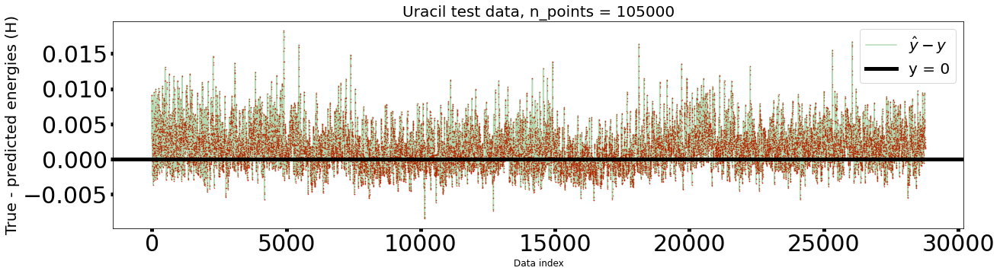

In [22]:
fig = plt.figure(figsize = (20, 5))
diff = y_hat - y
x = np.arange(diff.shape[0])
plt.plot(diff, alpha = 0.3, color = 'green', label = r'$\hat{y} - y$')
plt.scatter(x, diff, color='red', s = 0.2)
plt.axhline(y = 0, color='black', linewidth = 5, label = "y = 0")
plt.title("{} test data, n_points = {}".format(cfg['name'], cfg['batches'][-1]), fontsize = 20)
plt.xlabel('Data index', fontsize = 12)
plt.xticks(fontsize = 30)
plt.yticks(fontsize = 30)
ax = plt.gca()
ax.xaxis.set_tick_params(width = 5)
ax.yaxis.set_tick_params(width = 5)
plt.ylabel('True - predicted energies (H)', fontsize = 20)
plt.legend(fontsize = 20)
plt.savefig('Loss data')

In [23]:
mae = np.mean(np.abs(diff))
rmse = np.mean(diff * diff)
from torchani.units import hartree2kcalmol, hartree2ev

m, r = hartree2kcalmol(mae), hartree2kcalmol(rmse)
mev, rev = hartree2ev(mae), hartree2ev(rmse)

In [24]:
print(y.shape[0], m, r, mev, rev)

28770 1.5265572092111637 0.006546464007675592 0.06619778543043253 0.00028388154541033825
